<a href="https://colab.research.google.com/github/anibahs/DSEM_INFO6105/blob/main/Crash_Course_in_Statistical_Learning_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Crash Course in Statistical Learning - Binary classification using Linear, Tree and Ensemble Models**  
  \

## *Welcome to the world of data science!*  
  \


Statistical Learning is a field that combines statistics and computer science to develop algorithms that can automatically learn from data. In this 



tutorial, we'll explore what Statistical Learning is and how it works.  
  \

**What is Statistical Learning?**  
Statistical Learning is a field of study that focuses on the development of algorithms that can automatically learn patterns in data. It combines principles from statistics and computer science to create models that can make predictions or decisions based on data. These models can be used in a wide range of applications, including image and speech recognition, natural language processing, and autonomous vehicles.  
  \

Types of Statistical Learning  
  \
There are two main types of Statistical Learning: Supervised Learning and Unsupervised Learning.

**Supervised Learning**  
Supervised Learning is a type of Statistical Learning that involves predicting an outcome variable based on one or more input variables. This type of learning is called supervised because the algorithm is provided with a labeled dataset, where the outcome variable is already known. Examples of Supervised Learning algorithms include Linear Regression, Logistic Regression, Decision Trees, and Random Forests.  
  \

**Unsupervised Learning**  
Unsupervised Learning is a type of Statistical Learning that involves finding patterns in unlabeled data. This type of learning is called unsupervised because the algorithm is not provided with a labeled dataset, and the outcome variable is unknown. Examples of Unsupervised Learning algorithms include K-Means Clustering, Principal Component Analysis (PCA), and Association Rule Learning.  
  \






  \
  In machine learning, binary classification is a common supervised learning algorithm that categorizes new observations into one of two classes. This technique is particularly useful in applications like medical diagnosis or spam detection, where we want to determine if an observation belongs to one category or the other.  
  \
  


Machine Learning Life Cycle
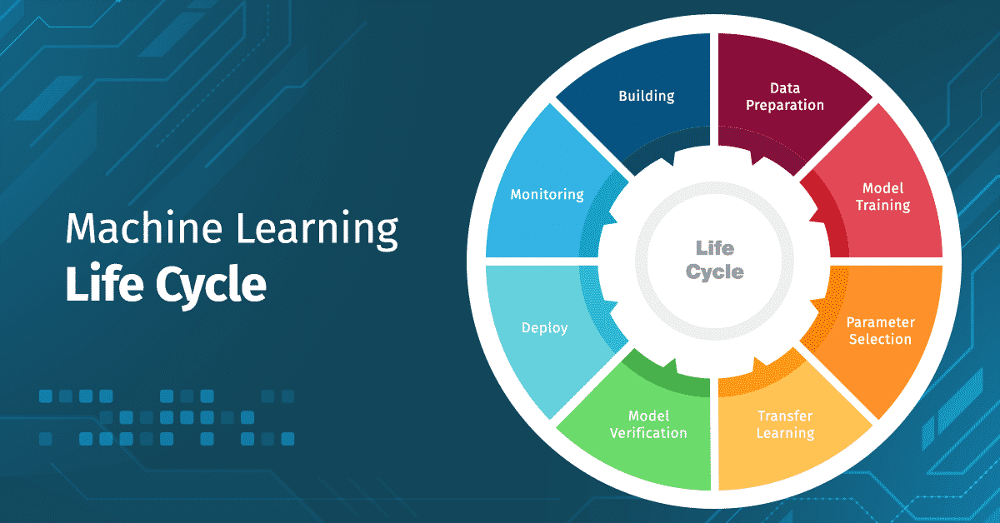

## Abstract  
  \
Predicting weather is something we all depend on in our daily lives. While predicting natual calamities can save lives, a simple task like predicting occurenc of rain in the next day can help a little bit for all of us.  

The dataset "Rain in Australia" can help us train our model to the same, where the target variable "RainTomorrow" represents the risk of rain in terms of "Yes" or "No".  
  \
## Dataset


The dataset includes observations of the climate in Australia of a period of 10 years and how the rainfall varies depending on other climate changes.

* Target Variable: 
  * RainTomorrow : The amount of next day rain in mm. Used to create response variable RainTomorrow. A kind of measure of the "risk".
* Independant Variables:
  * Date : date of observation
  * Location : region within Australia
  * MinTemp : Minimum temperature in teh day in degree Celsius
  * MaxTemp : Maximum temperature in teh day in degree Celsius
  * Rainfall : The amount of rainfall recorded for the day in mm
  * Evaporation : The so-called Class A pan evaporation (mm) in the 24 hours to 9am
  * Sunshine : The number of hours of bright sunshine in the day.
  * WindGustDir : The direction of the strongest wind gust in the 24 hours to midnight
  * WindGustSpeed : The speed (km/h) of the strongest wind gust in the 24 hours to midnight
  * WinDir9am : Direction of the wind at 9am
  * WinDir3pm : Direction of the wind at 3pm
  * WindSpeed9am : Wind speed (km/hr) averaged over 10 minutes prior to 9am
  * WindSpeed3pm : Wind speed (km/hr) averaged over 10 minutes prior to 3pm
  * Humidity9am : Humidity (percent) at 9am
  * Humidity3pm : Humidity (percent) at 3pm
  * Pressure9am : Atmospheric pressure (hpa) reduced to mean sea level at 9am
  * Pressure3pm : Atmospheric pressure (hpa) reduced to mean sea level at 3pm
  * Cloud9am : Fraction of sky obscured by cloud at 9am. This is measured in "oktas", which are a unit of eigths. It records how many
  * Cloud3pm : Fraction of sky obscured by cloud at 3pm. This is measured in "oktas", which are a unit of eigths. It records how many
  * Temp9am : Temperature (degrees C) at 3pm
  * Temp3pm : Temperature (degrees C) at 9am
  * RainToday : Boolean: 1 if precipitation (mm) in the 24 hours to 9am exceeds 1mm, otherwise 0



[Dataset on Kaggle](https://www.kaggle.com/datasets/jsphyg/weather-dataset-rattle-package)


# Imports

In [97]:
#handle data using data frames
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import skew
from collections import Counter

# To calculate the score
from sklearn.metrics import accuracy_score 
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import RFE # Recursive Feature Selection
from sklearn.metrics import confusion_matrix

import random, math
from sklearn.metrics import r2_score, mean_squared_error 

from matplotlib.pyplot import figure
from sklearn.tree import export_graphviz
import pydot
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.tree import DecisionTreeClassifier

# Feature Importance using Filter Method (Chi-Square)
from sklearn.feature_selection import SelectKBest, chi2

! pip install shap
! pip install eli5
! pip install -q kaggle
! pip install -f http://h2o-release.s3.amazonaws.com/h2o/latest_stable_Py.html h2o
! pip install lime
from lime import lime_tabular
import shap
import h2o
from h2o.automl import H2OAutoML
from h2o.estimators.glm import H2OGeneralizedLinearEstimator
from h2o.grid.grid_search import H2OGridSearch
from h2o.estimators.gbm import H2OGradientBoostingEstimator
from sklearn.inspection import PartialDependenceDisplay
from sklearn.metrics import accuracy_score
from sklearn import metrics

import random, os, sys
import psutil
import logging

min_mem_size=6 
run_time=240
pct_memory=0.5
virtual_memory=psutil.virtual_memory()
min_mem_size=int(round(int(pct_memory*virtual_memory.available)/1073741824,0))

port_no=random.randint(5555,55555)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: http://h2o-release.s3.amazonaws.com/h2o/latest_stable_Py.html
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [98]:
import os

os.environ['KAGGLE_USERNAME'] = 'shabinasingh'
os.environ['KAGGLE_KEY'] = '4a64d2f32a2dec68f1b905c88bb66932'

In [99]:
!mkdir ~/.kaggle
!kaggle datasets download -d jsphyg/weather-dataset-rattle-package
!unzip -o weather-dataset-rattle-package.zip -d /content

mkdir: cannot create directory ‘/root/.kaggle’: File exists
weather-dataset-rattle-package.zip: Skipping, found more recently modified local copy (use --force to force download)
Archive:  weather-dataset-rattle-package.zip
  inflating: /content/weatherAUS.csv  


In [100]:
csv = '/content/weatherAUS.csv'
df = pd.read_csv(csv)
df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000
mean,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339
std,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000
25%,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000
50%,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000
75%,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000


# **Data Cleaning / Preprocessing**

In this section, we will discuss data preprocessing, which is a critical step in the development of machine learning and AI models. The primary objective of data preprocessing is to transform the raw data into a format that is more easily and effectively processed by the data science algorithms.

Data preprocessing techniques are generally used at the earliest stages of the machine learning and AI development pipeline to ensure that the final results are accurate, reliable, and effective. This process involves several tools and methods that are designed to handle different types of data and address different types of issues that might arise during the data analysis process.

   
  
    Some of the most commonly used techniques for data preprocessing include sampling, transformation, denoising, imputation, normalization, and feature extraction.
    * Sampling techniques are used to select a representative subset of data from a large population to reduce the computational complexity and improve the efficiency of the analysis.
    * Transformation techniques involve manipulating raw data to create a single input, such as scaling, normalization, or encoding categorical data.
    * Denoising techniques remove unwanted noise from the data that can lead to inaccurate results.
    * Imputation techniques are used to fill in missing values in the data using statistical methods.
    * Normalization techniques are used to organize data for more efficient access and processing.
    * Feature extraction techniques help to identify and extract relevant features from the data that are significant in a particular context.

Overall, data preprocessing is an essential step in the data science pipeline, and mastering the different techniques involved is crucial for developing accurate and effective machine learning and AI models.

## Looking at data types, differenting categorical and numerical features 
  \
  While numerical data can be processed, we need to encode categorical data to be able to use it for model training.  
  \
**How to Handle Categorical Data in Machine Learning**

Machine learning is a popular technique used in many industries, including finance, healthcare, and e-commerce, to extract valuable insights and predictions from data. However, not all data is created equal, and one particular type of data, known as categorical data, requires special handling when used in machine learning algorithms.

In this tutorial, we'll explore what categorical data is, why it's important to handle it properly, and different encoding methods you can use to transform categorical data into numerical data.

**What is Categorical Data?**

Categorical data is a type of data that represents qualitative or nominal characteristics, such as gender, occupation, or country of origin. Categorical data cannot be measured or compared using mathematical operations like addition or subtraction.

**Why is it Important to Handle Categorical Data?**

Machine learning algorithms are designed to work with numerical data only. Therefore, categorical data must be converted into numerical data, which is a process known as encoding or transformation.

If categorical data is not handled correctly, it can lead to inaccurate or biased results in machine learning models. For example, let's say we have a dataset of people's occupations, and we encode them using the Label Encoding method, which assigns a numerical value to each category. If we encode "doctor" as 1 and "teacher" as 2, our machine learning algorithm may mistakenly assume that being a doctor is numerically closer to being a teacher than to being a lawyer, which can lead to incorrect predictions.

**Different Encoding Methods for Categorical Data**

There are several encoding methods used for converting categorical data into numerical data. Let's explore some of the most popular methods:  
  \

**One-Hot Encoding**  
One-Hot Encoding creates a new binary column for each category, where each column represents whether the data point belongs to that category or not. For example, let's say we have a dataset of fruits with the categorical variable "color," which can take the values "red," "green," or "yellow." With One-Hot Encoding, we would create three new columns, "color_red," "color_green," and "color_yellow," where each column would contain a binary value indicating whether the fruit is that color or not.

One-Hot Encoding is a widely used method for handling categorical data, but it has a few limitations. If we have a large number of categories, One-Hot Encoding can result in a large number of columns, which can lead to the "curse of dimensionality" problem. Additionally, if there are rare categories that appear only a few times in the dataset, One-Hot Encoding can create noise in the data.

**Label Encoding**  
Label Encoding assigns a numerical value to each category, with the values ranging from 0 to the number of categories minus one. For example, if we have a dataset of animals with the categorical variable "species," which can take the values "cat," "dog," or "bird," we would assign 0 to "cat," 1 to "dog," and 2 to "bird."

Label Encoding is a simple method for handling categorical data, but it has a few limitations. The numerical values assigned to the categories have an inherent ordering, which can lead to incorrect predictions in some cases. Additionally, if we have a large number of categories, Label Encoding can result in a large range of values, which can affect the performance of some machine learning algorithms.

**Binary Encoding**  
Binary Encoding creates new columns representing each category, but instead of using binary values, it uses binary codes. Binary codes are a series of 0s and 1s that represent each category as a combination of binary digits. For example, if we have a dataset of fruits with the categorical variable "color," which can take the values "red," "green," or

In [101]:
categorical_columns = df.select_dtypes(include=['object']).columns
df[categorical_columns].describe()

,Date,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow
count,145460,145460,135134,134894,141232,142199,142193
unique,3436,49,16,16,16,2,2
top,2013-11-12,Canberra,W,N,SE,No,No
freq,49,3436,9915,11758,10838,110319,110316


In [102]:
numerical_columns = df.select_dtypes(include=['int','float','float64']).columns
df[numerical_columns].describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000
mean,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339
std,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000
25%,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000
50%,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000
75%,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000


## Looking at null/missing values

Data imputation is a technique used in machine learning to fill in missing values in a dataset. There are several methods for data imputation, each with its strengths and limitations. We will explore four popular data imputation methods: Mean Imputation, Mode Imputation, Multiple Imputation by Chained Equations (MICE), and K-Nearest Neighbor (KNN) Imputation.  
  \

**Mean Imputation**  
Mean imputation is a simple and widely used method for filling in missing values. In this method, the mean of the available values in a column is used to replace the missing values. Mean imputation works well when the data is missing completely at random and when the missing values are not a significant proportion of the total data. However, it can skew the distribution of the data and reduce the variance in the data.

**Mode Imputation**  
Mode imputation is a method for filling in missing values that is similar to mean imputation, but instead of using the mean, it uses the mode of the available values in a column. Mode imputation is useful when the data is categorical or nominal and works well when the missing values are not a significant proportion of the total data. However, it can lead to biased results if the mode is overrepresented in the data.

**Multiple Imputation by Chained Equations (MICE)**  
Multiple Imputation by Chained Equations (MICE) is a sophisticated imputation method that can handle missing data in a multivariate setting. In MICE, missing values are imputed multiple times, and each imputed dataset is analyzed separately, with the results combined to produce an overall estimate. MICE works well when the missing data is not missing completely at random and when there is a relationship between the missing and observed data. However, it can be computationally intensive and may require a large number of imputations to produce accurate results.

**K-Nearest Neighbor (KNN) Imputation**  
K-Nearest Neighbor (KNN) imputation is a method for filling in missing values that is based on the distance between data points. In KNN imputation, missing values are imputed by taking the average of the K-nearest neighbors, where K is a user-defined parameter. KNN imputation works well when the data is missing at random and when there is a relationship between the missing and observed data. However, it can be sensitive to outliers and may not work well with high-dimensional data.  
  \

In conclusion, data imputation is an essential technique in machine learning, and selecting the appropriate method for a specific dataset depends on the type of missing data and the characteristics of the dataset. Mean imputation and mode imputation are simple methods that work well with low-dimensional data, while MICE and KNN imputation are more complex methods that can handle high-dimensional data and non-random missing data.

In [103]:
df.isnull().sum().sort_values(ascending=False)

Sunshine         69835
Evaporation      62790
Cloud3pm         59358
Cloud9am         55888
Pressure9am      15065
Pressure3pm      15028
WindDir9am       10566
WindGustDir      10326
WindGustSpeed    10263
Humidity3pm       4507
WindDir3pm        4228
Temp3pm           3609
RainTomorrow      3267
Rainfall          3261
RainToday         3261
WindSpeed3pm      3062
Humidity9am       2654
Temp9am           1767
WindSpeed9am      1767
MinTemp           1485
MaxTemp           1261
Location             0
Date                 0
dtype: int64

In [104]:
total = df.isnull().sum().sort_values(ascending=False)
percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head(20)

,Total,Percent
Sunshine,69835,0.480098
Evaporation,62790,0.431665
Cloud3pm,59358,0.408071
Cloud9am,55888,0.384216
Pressure9am,15065,0.103568
Pressure3pm,15028,0.103314
WindDir9am,10566,0.072639
WindGustDir,10326,0.070989
WindGustSpeed,10263,0.070555
Humidity3pm,4507,0.030984


In [105]:
df['Date'] = pd.to_datetime(df['Date'])

df['Year'] = df['Date'].dt.year
df['Month'] = df['Date'].dt.month
df['Day'] = df['Date'].dt.day

data = df.drop('Date', axis=1)

data.head(3)

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,...,1007.1,8.0,NaN,16.9,21.8,No,No,2008,12,1
1,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,...,1007.8,NaN,NaN,17.2,24.3,No,No,2008,12,2
2,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,...,1008.7,NaN,2.0,21.0,23.2,No,No,2008,12,3


In [106]:
features=df.select_dtypes(include=['object']).columns
print(features)

Index(['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday',
       'RainTomorrow'],
      dtype='object')


In [107]:
data[features].nunique()

Location        49
WindGustDir     16
WindDir9am      16
WindDir3pm      16
RainToday        2
RainTomorrow     2
dtype: int64

##  Encoding categorical features for better modeling

In [108]:
# Impute categorical var with Mode
for col in features:
  data[col] = data[col].fillna(data[col].mode()[0])

In [109]:
# So we convert categorical features to continuous features with Label Encoding
from sklearn.preprocessing import LabelEncoder

lencoders = {}

for col in data[features].columns:
    lencoders[col] = LabelEncoder()
    data[col] = lencoders[col].fit_transform(data[col])

data[features].nunique()

Location        49
WindGustDir     16
WindDir9am      16
WindDir3pm      16
RainToday        2
RainTomorrow     2
dtype: int64

##  Imputing missing data using Mode/MICE

In [110]:
# Multiple Imputation by Chained Equations
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

#imputed_data = df[numerical_columns].copy(deep=True) 
mice_imputer = IterativeImputer()
data[numerical_columns] = mice_imputer.fit_transform(data[numerical_columns])

[IterativeImputer] Early stopping criterion not reached.


In [111]:
total = data[numerical_columns].isnull().sum().sort_values(ascending=False)
percent = (data[numerical_columns].isnull().sum()/data[numerical_columns].isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head(20)

,Total,Percent
MinTemp,0,0.0
MaxTemp,0,0.0
Rainfall,0,0.0
Evaporation,0,0.0
Sunshine,0,0.0
WindGustSpeed,0,0.0
WindSpeed9am,0,0.0
WindSpeed3pm,0,0.0
Humidity9am,0,0.0
Humidity3pm,0,0.0


In [112]:
data.isnull().sum().sort_values(ascending=False)

Location         0
Humidity3pm      0
Month            0
Year             0
RainTomorrow     0
RainToday        0
Temp3pm          0
Temp9am          0
Cloud3pm         0
Cloud9am         0
Pressure3pm      0
Pressure9am      0
Humidity9am      0
MinTemp          0
WindSpeed3pm     0
WindSpeed9am     0
WindDir3pm       0
WindDir9am       0
WindGustSpeed    0
WindGustDir      0
Sunshine         0
Evaporation      0
Rainfall         0
MaxTemp          0
Day              0
dtype: int64

In [113]:
data.describe()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
count,145460.000000,145460.000000,145460.000000,145460.000000,145460.000000,145460.000000,145460.00000,145460.000000,145460.000000,145460.000000,...,145460.000000,145460.000000,145460.000000,145460.000000,145460.000000,145460.000000,145460.000000,145460.000000,145460.000000,145460.000000
mean,23.793524,12.198031,23.221397,2.376464,5.087255,7.410260,8.09360,39.805656,6.999526,7.798852,...,1015.329210,4.387689,4.492446,16.965428,21.709306,0.219167,0.219146,2012.769751,6.399615,15.712258
std,14.228687,6.380376,7.097498,8.394249,3.706492,3.476884,4.69411,13.493518,4.515839,4.538135,...,6.715998,2.548654,2.363313,6.490499,6.957626,0.413683,0.413669,2.537684,3.427262,8.794789
min,0.000000,-10.322467,-4.800000,-5.587454,-5.000220,-3.593248,0.00000,6.000000,0.000000,0.000000,...,977.100000,-2.800350,-3.963698,-7.200000,-5.400000,0.000000,0.000000,2007.000000,1.000000,1.000000
25%,11.000000,7.600000,18.000000,0.000000,2.600000,4.940914,4.00000,31.000000,3.000000,4.000000,...,1011.000000,2.000000,2.659089,12.300000,16.700000,0.000000,0.000000,2011.000000,3.000000,8.000000
50%,24.000000,12.000000,22.700000,0.000000,4.600000,7.700000,9.00000,39.000000,7.000000,8.000000,...,1015.400000,4.606880,4.623723,16.700000,21.102500,0.000000,0.000000,2013.000000,6.000000,16.000000
75%,36.000000,16.800000,28.200000,0.800000,6.800000,10.144145,13.00000,48.000000,11.000000,12.000000,...,1019.600000,7.000000,6.921651,21.500000,26.400000,0.000000,0.000000,2015.000000,9.000000,23.000000
max,48.000000,33.900000,48.100000,371.000000,145.000000,22.241768,15.00000,137.570211,15.000000,15.000000,...,1039.600000,10.597934,12.151514,40.200000,46.700000,1.000000,1.000000,2017.000000,12.000000,31.000000


## Checking distributions of numerical features using histograms and QQ Plot

Logistic regression is a popular method for binary classification problems, where the goal is to predict a binary outcome based on a set of input features. One assumption of logistic regression is that the relationship between the input features and the output variable is linear. However, another important assumption is that the input features are normally distributed. In this tutorial, we'll explore why normal distribution is required for logistic regression and how to check for normality using two common methods: histogram and Q-Q plot.

**Why normal distribution is required for logistic regression**  
  \
Normal distribution is required for logistic regression because it affects the maximum likelihood estimation of the regression coefficients. Maximum likelihood estimation is the method used to fit the logistic regression model, and it assumes that the errors (residuals) between the predicted probabilities and the actual outcomes are normally distributed. If the input features are not normally distributed, the errors will not be normally distributed, and the maximum likelihood estimation may not be accurate, leading to biased predictions.

**Checking for normality using histogram**  
  \
One common method for checking normality is to create a histogram of the input features. A histogram shows the distribution of values for a single variable, and if the histogram has a bell-shaped curve, it indicates that the variable is normally distributed. If the histogram is skewed to the left or right, it indicates that the variable is not normally distributed. However, the histogram may not be accurate if the sample size is small, or if the distribution has multiple peaks or outliers.

**Checking for normality using Q-Q plot**  
  \
Another method for checking normality is to create a Q-Q plot (Quantile-Quantile plot) of the input features. A Q-Q plot compares the distribution of the input features to the theoretical normal distribution by plotting the quantiles of the input features against the quantiles of the normal distribution. If the Q-Q plot is a straight line, it indicates that the input features are normally distributed. If the points on the Q-Q plot deviate from the straight line, it indicates that the input features are not normally distributed.  
  \

Normal distribution is required for logistic regression to ensure accurate maximum likelihood estimation of the regression coefficients. Checking for normality can be done using histogram or Q-Q plot, but it is important to note that these methods have limitations and may not always accurately represent the distribution of the data. Therefore, it is recommended to use multiple methods to check for normality and consider other assumptions of logistic regression, such as linearity and independence, to ensure accurate and reliable predictions.

Location


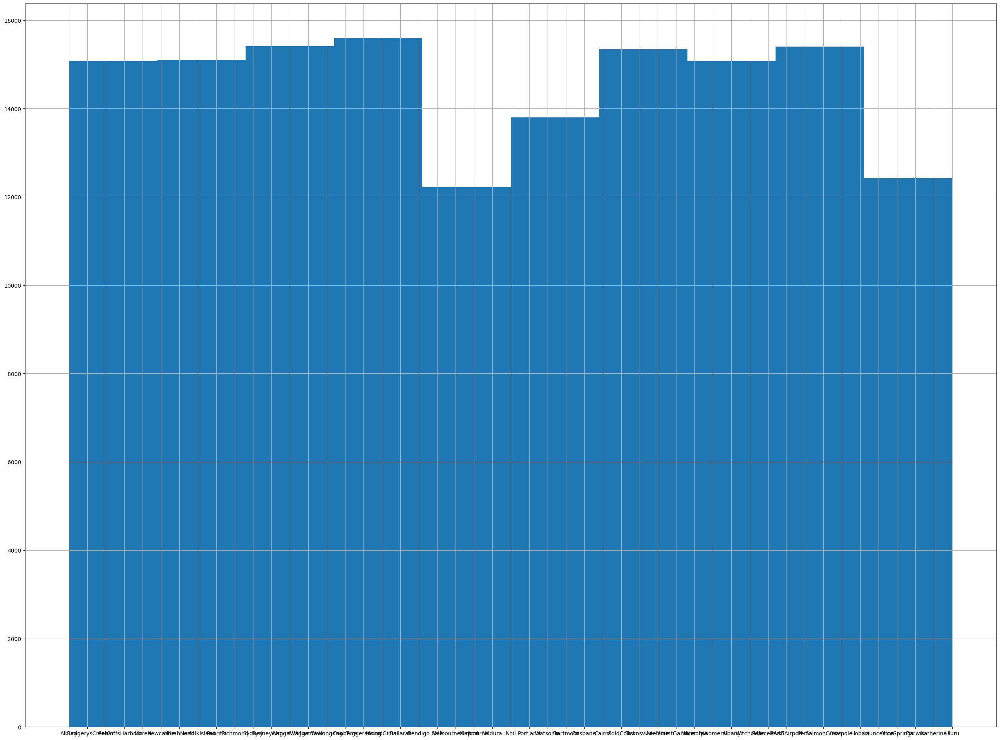

MinTemp


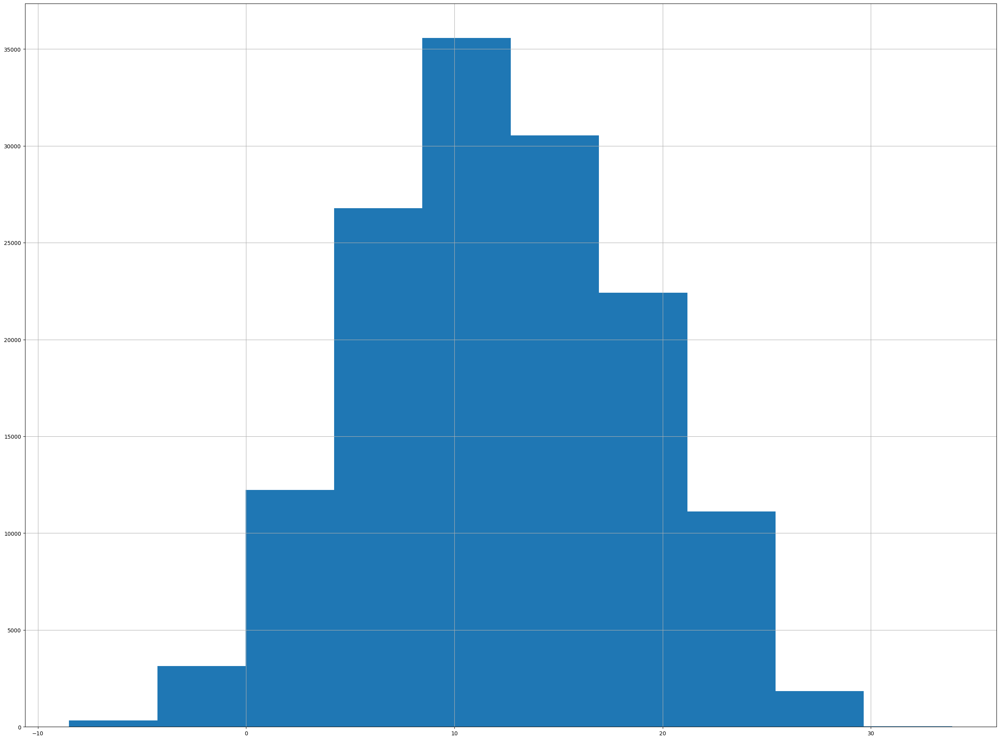

MaxTemp


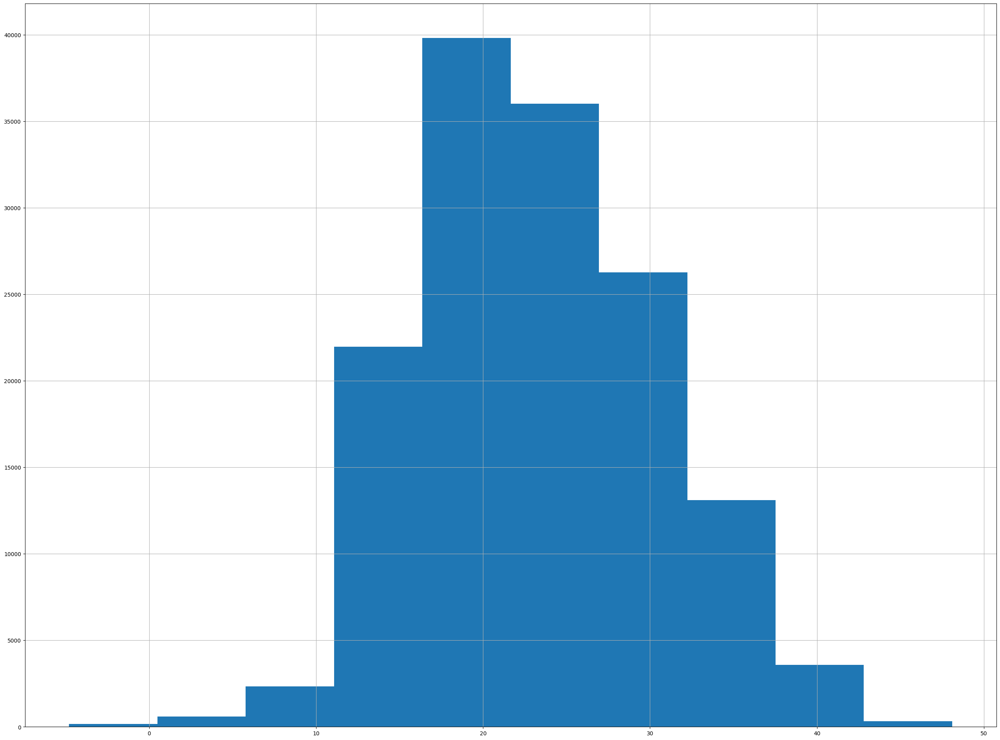

Rainfall


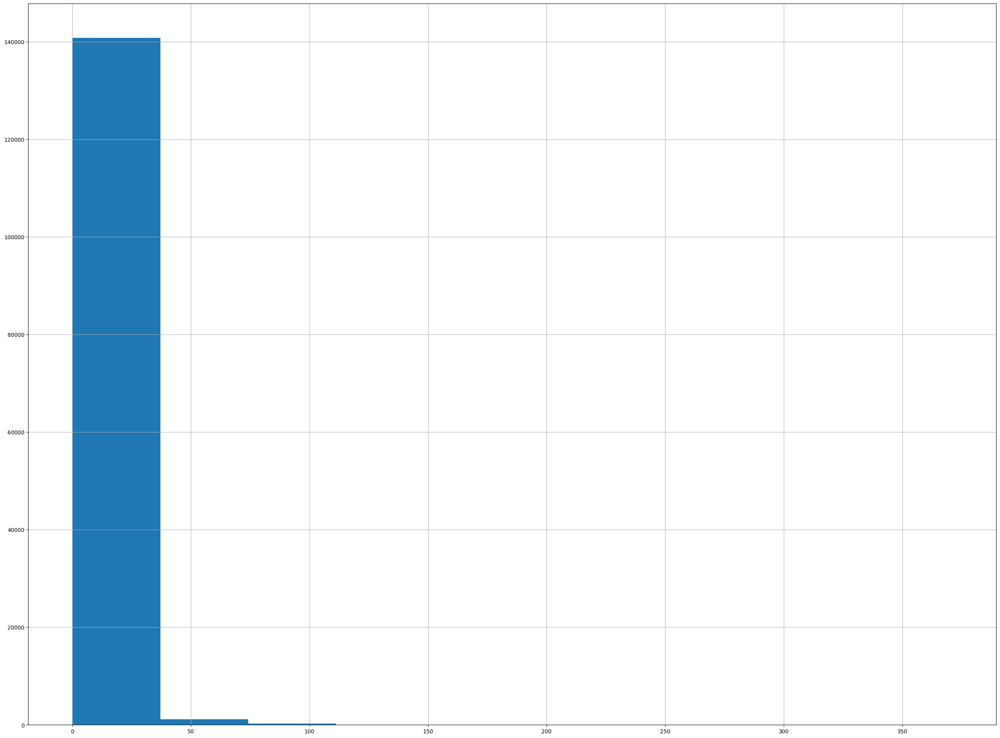

Evaporation


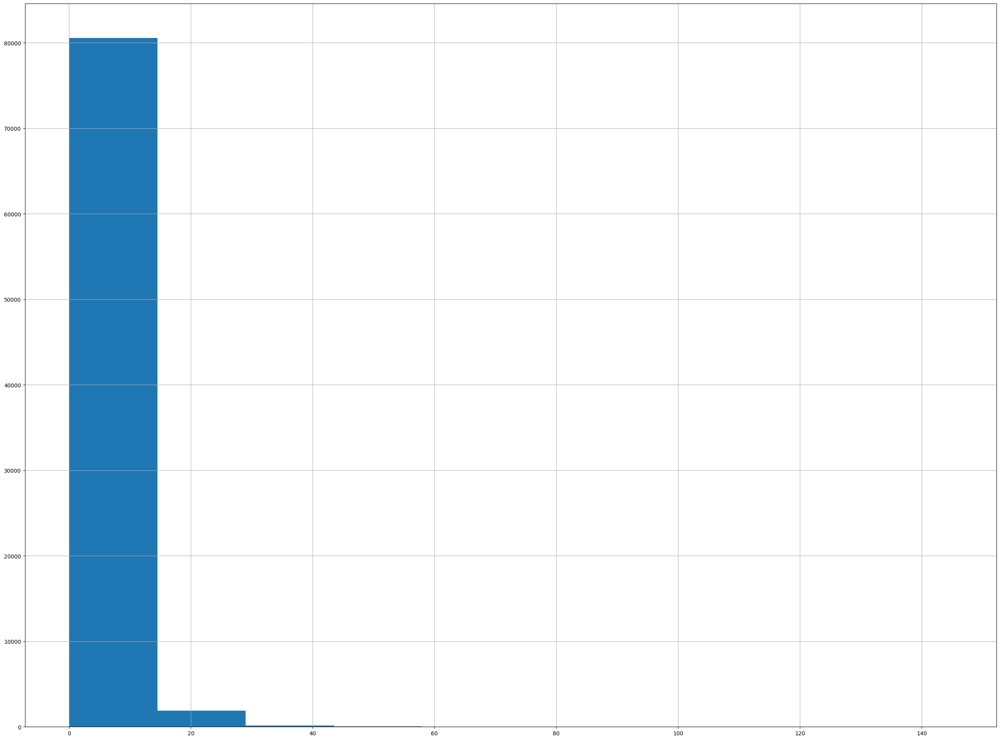

Sunshine


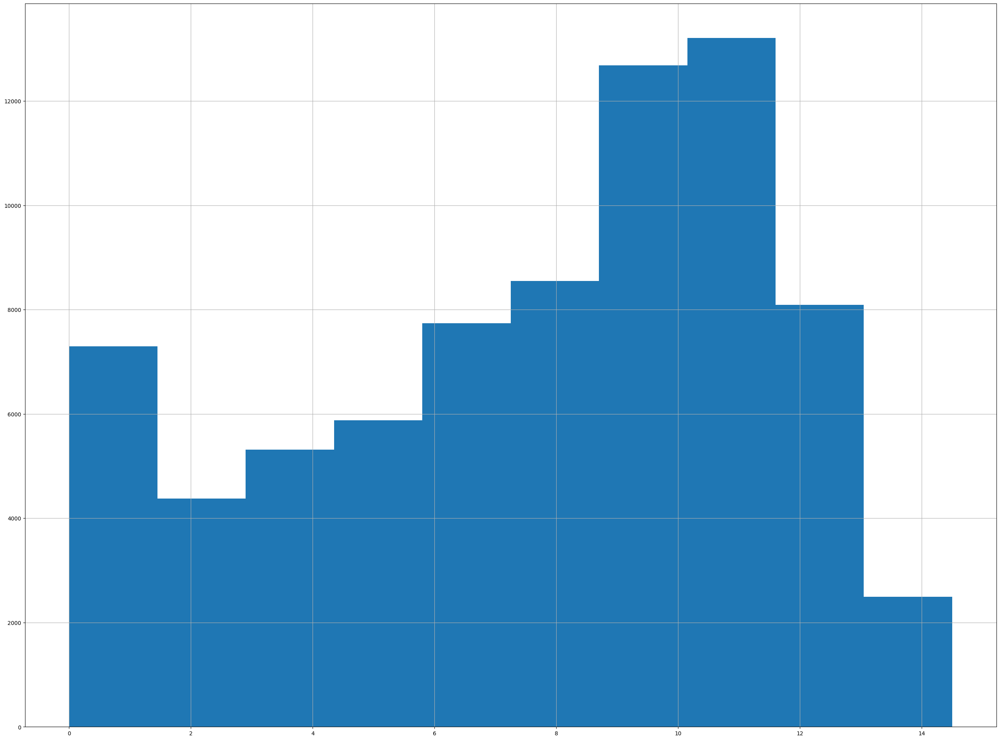

WindGustDir


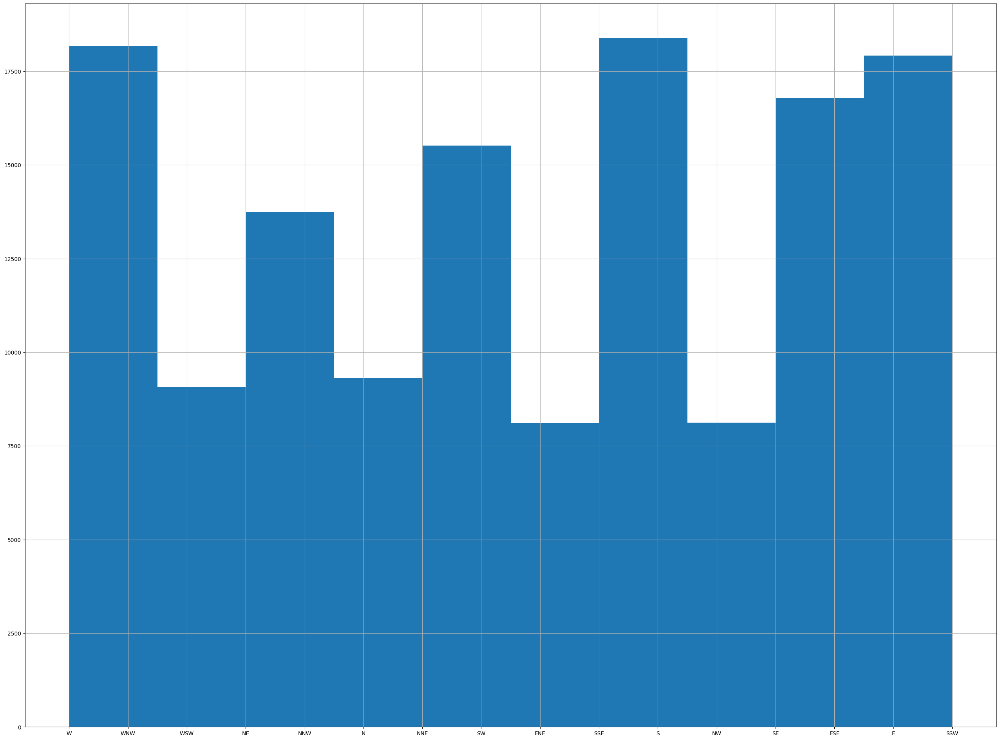

WindGustSpeed


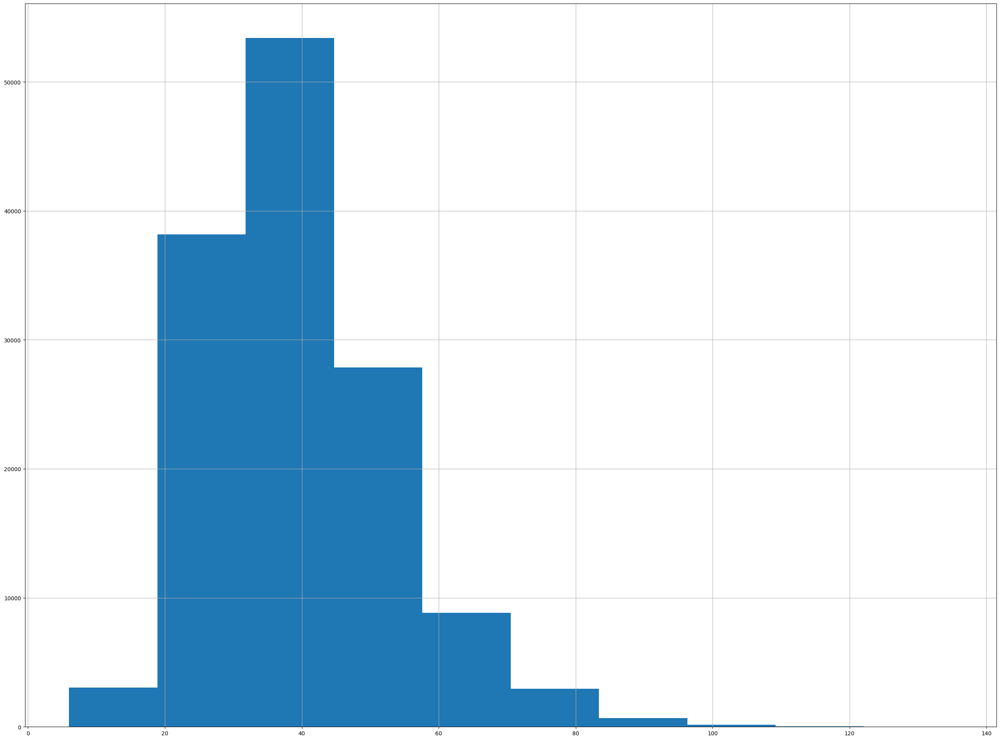

WindDir9am


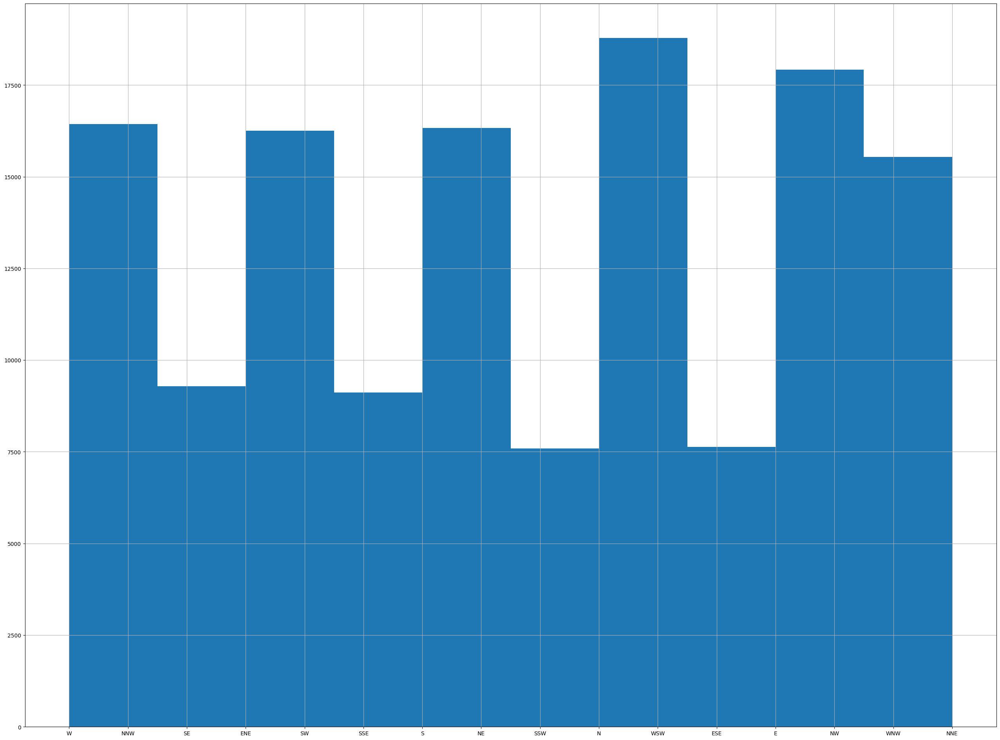

WindDir3pm


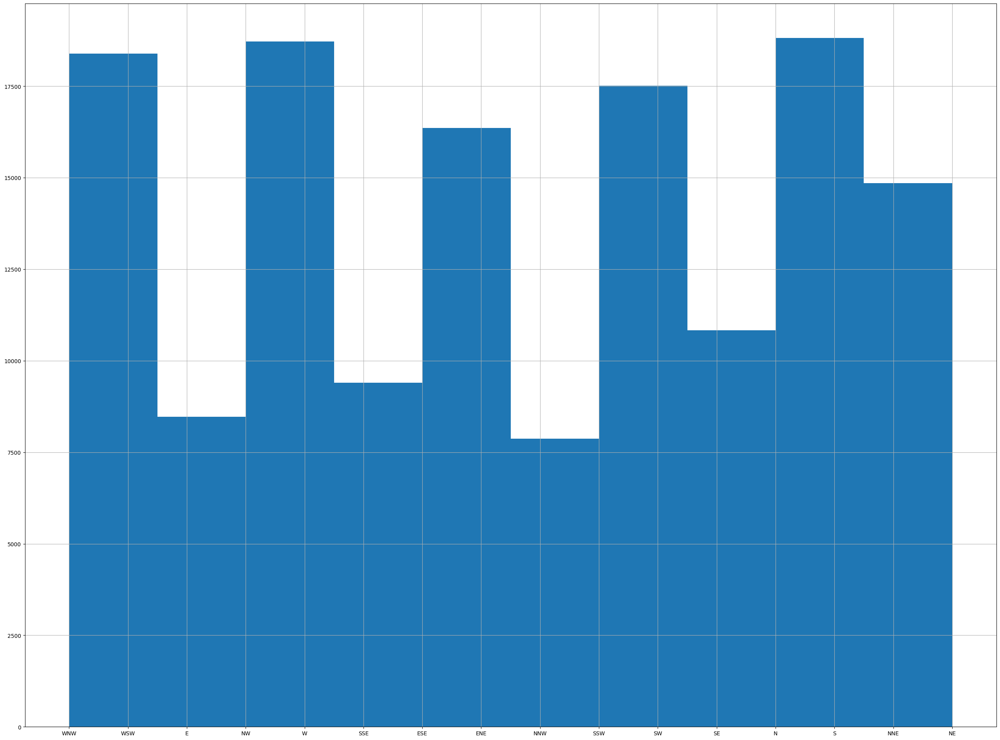

WindSpeed9am


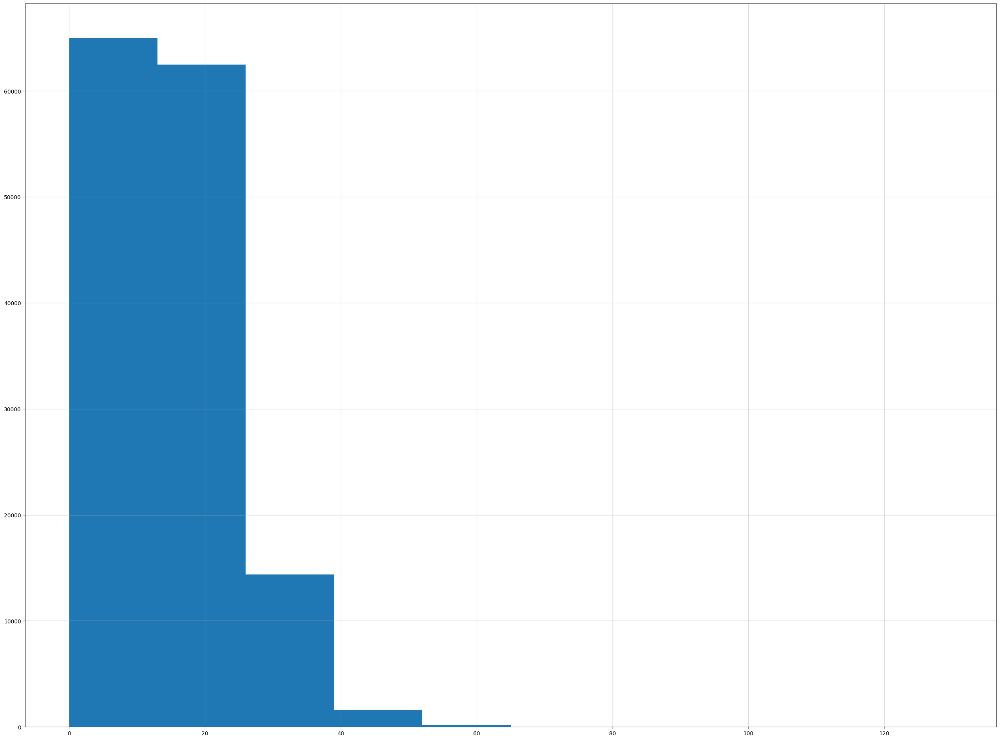

WindSpeed3pm


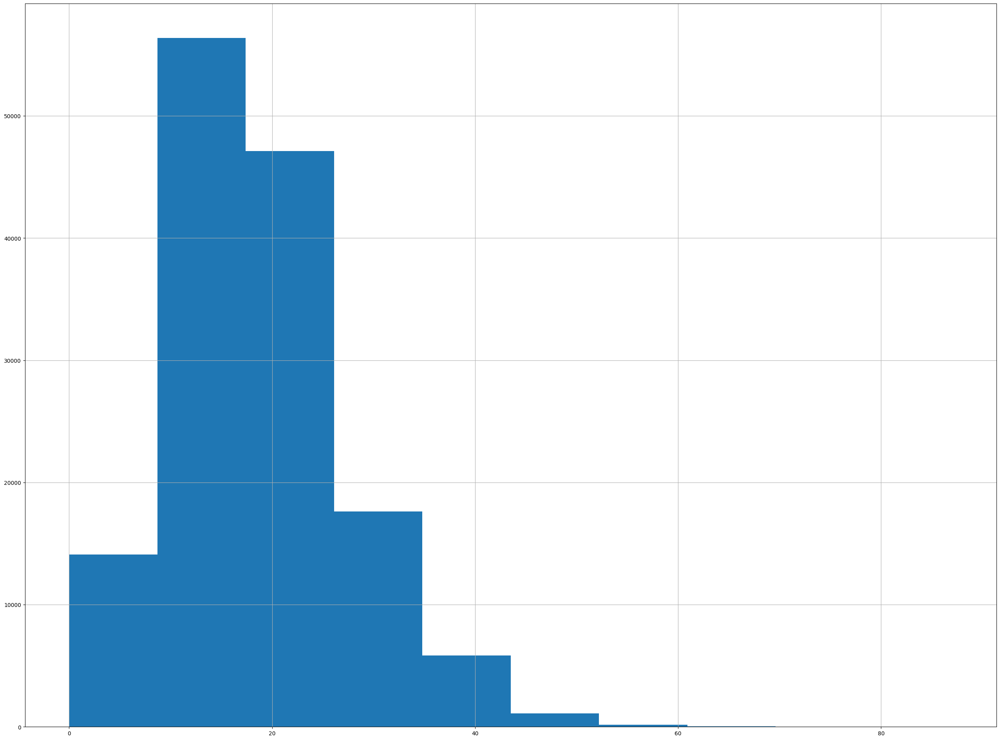

Humidity9am


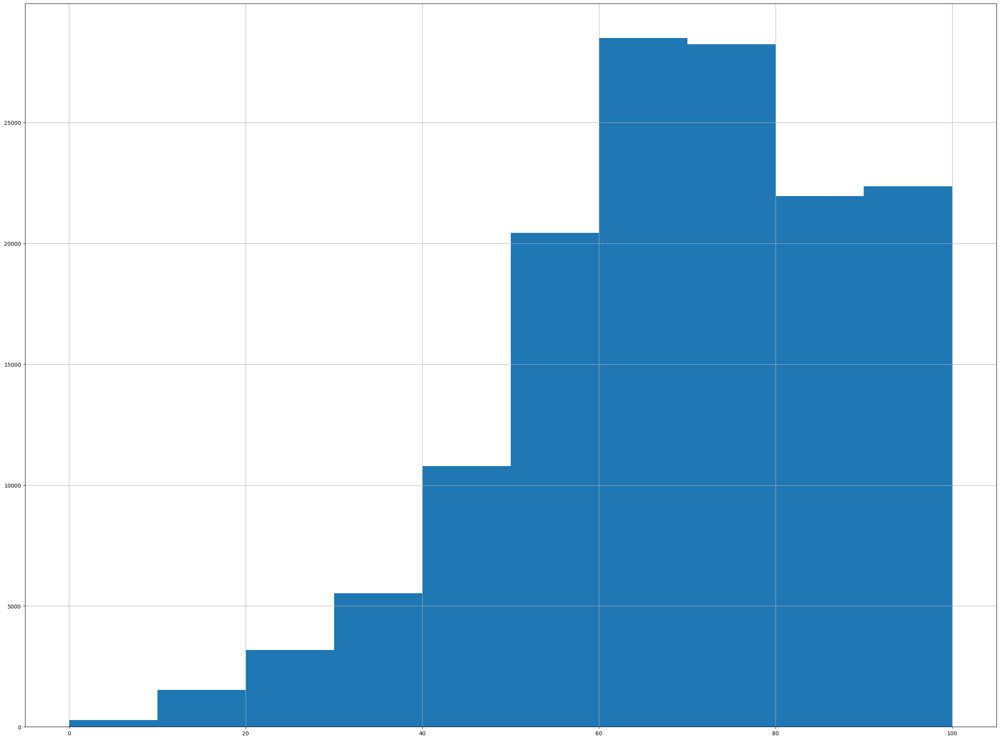

Humidity3pm


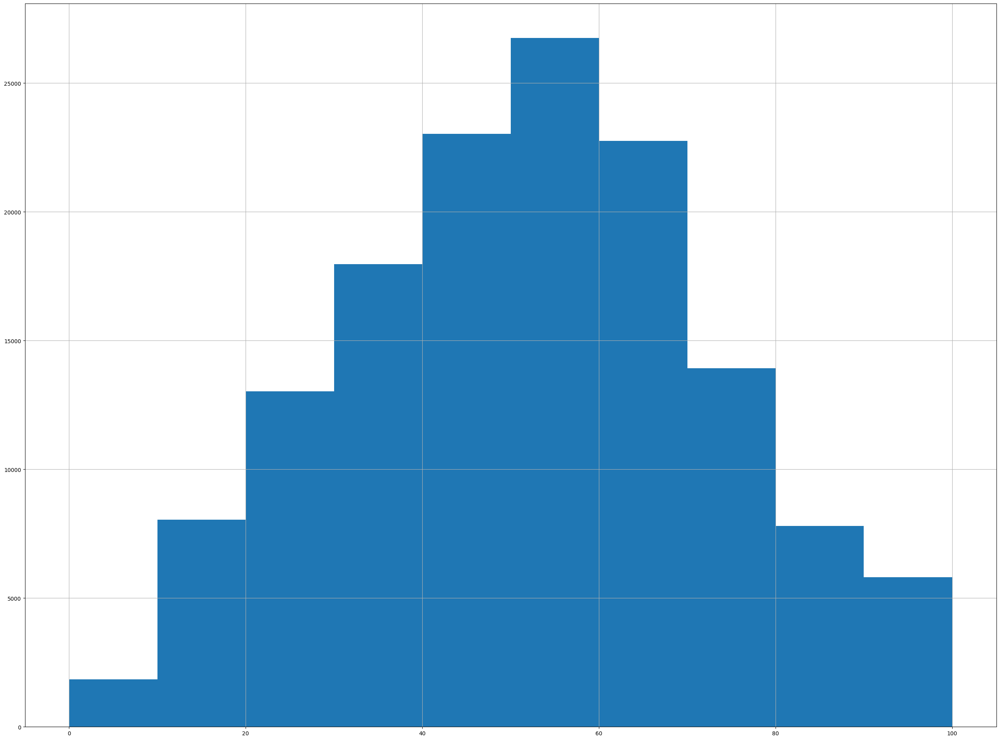

Pressure9am


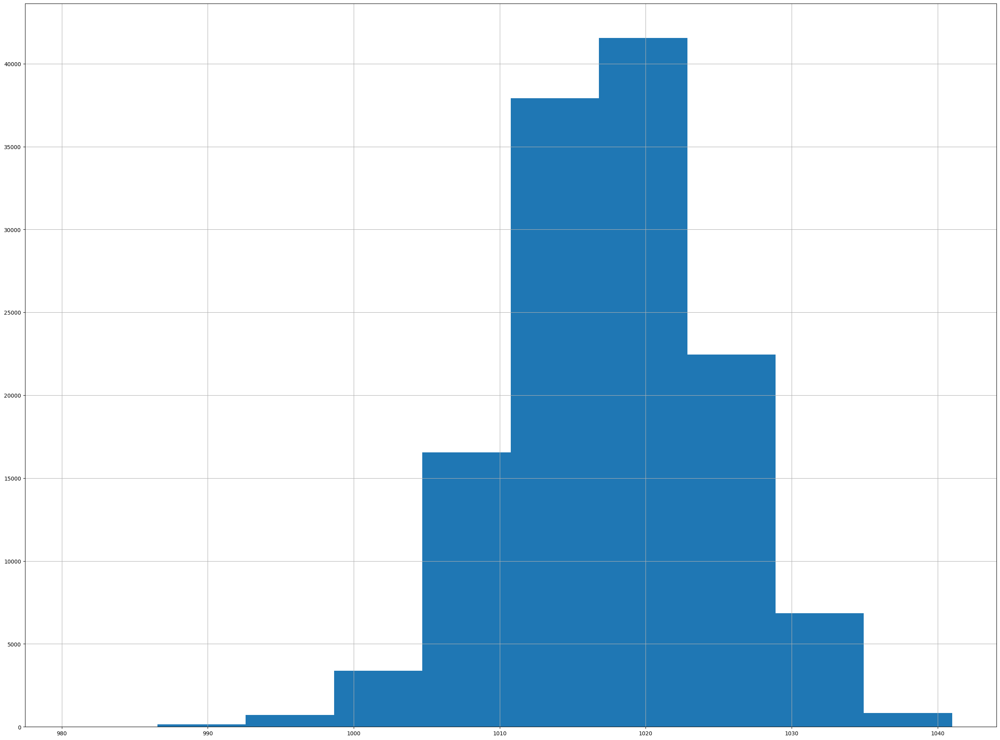

Pressure3pm


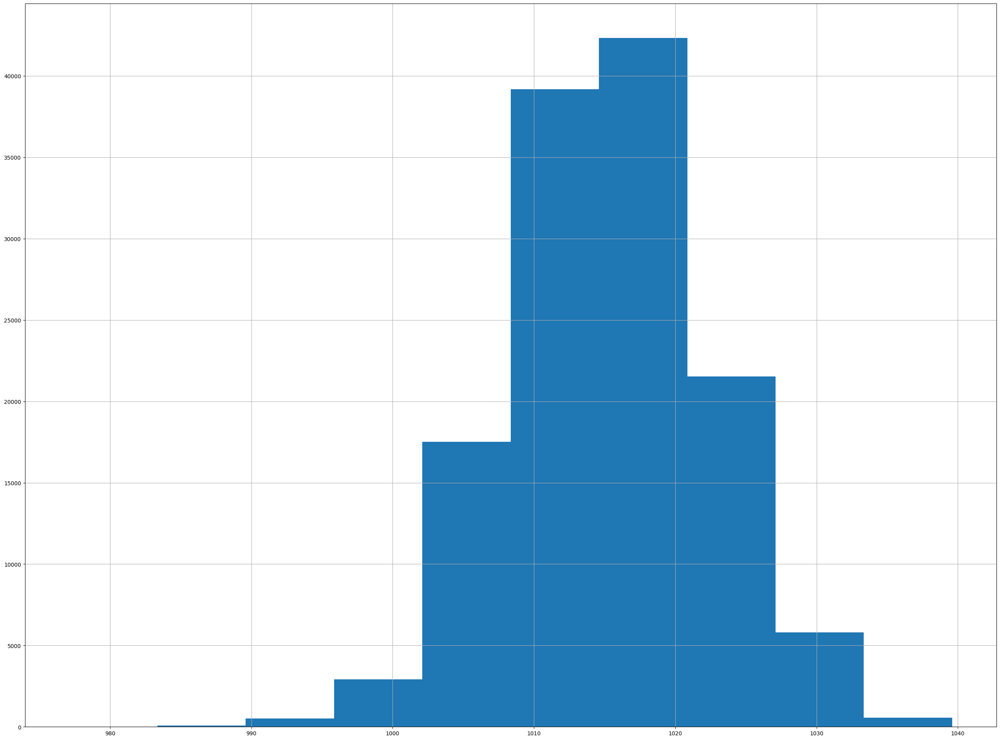

Cloud9am


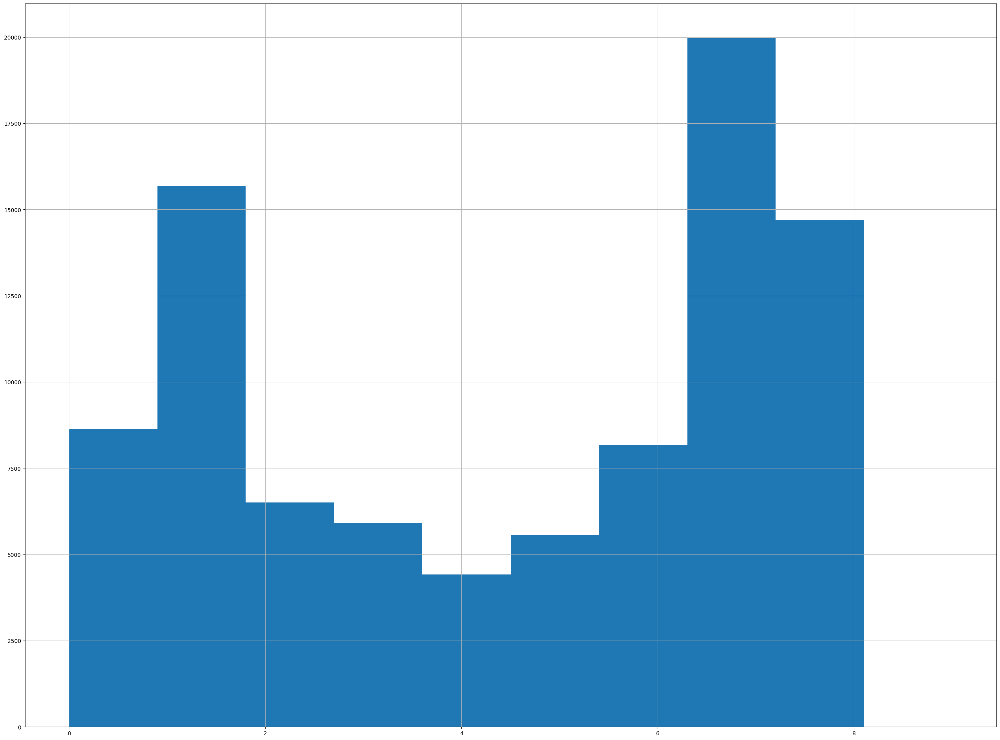

Cloud3pm


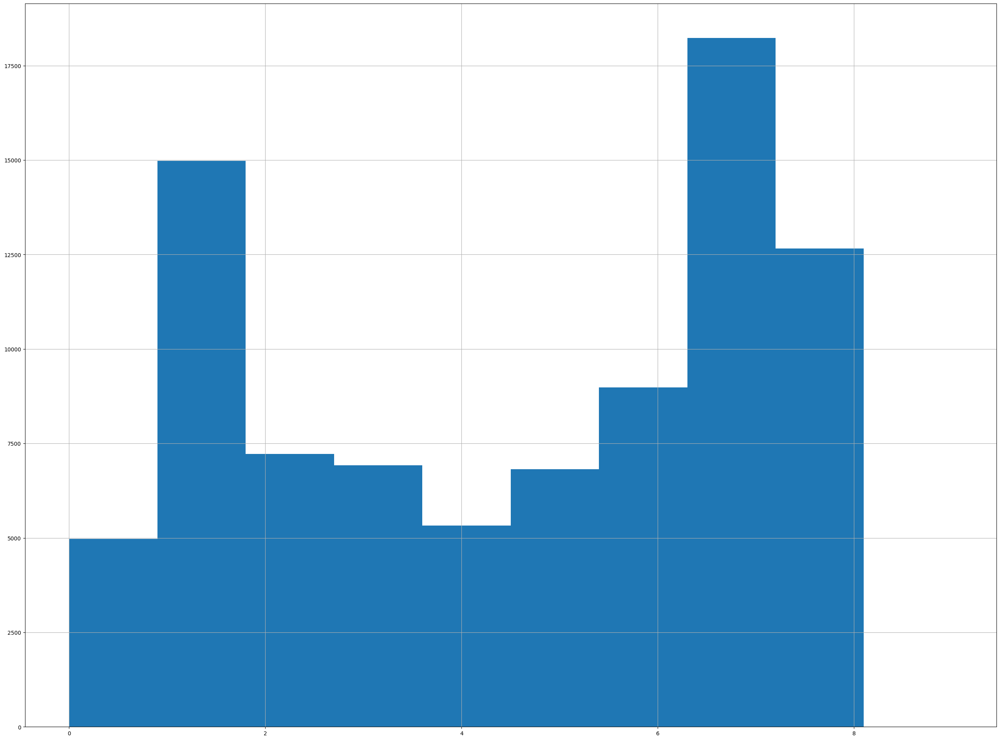

Temp9am


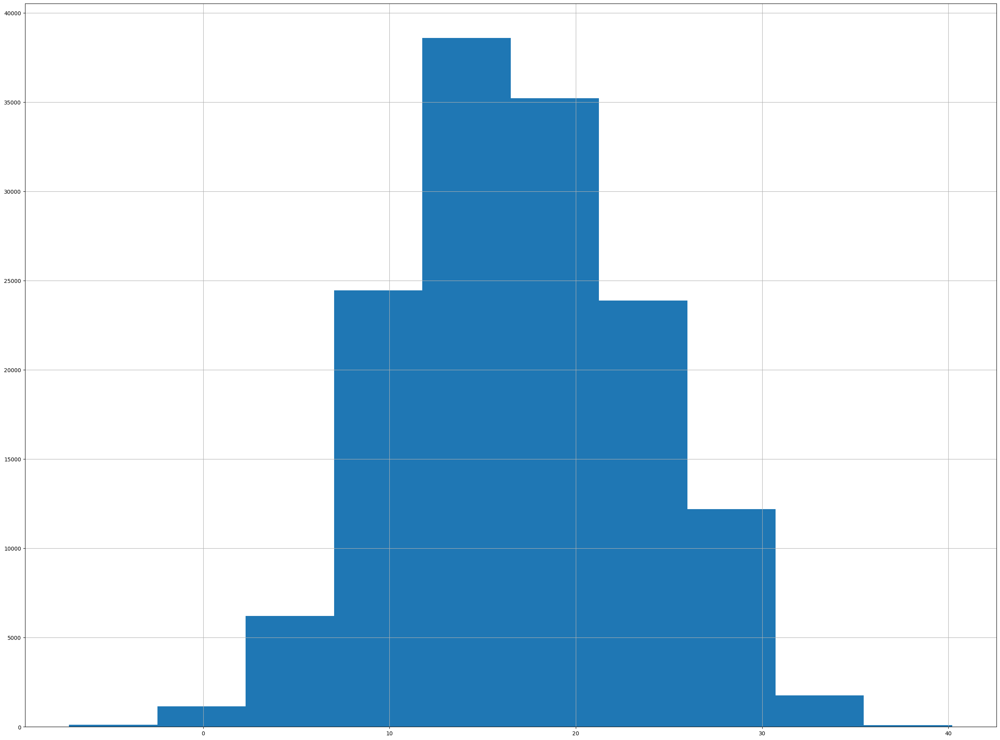

Temp3pm


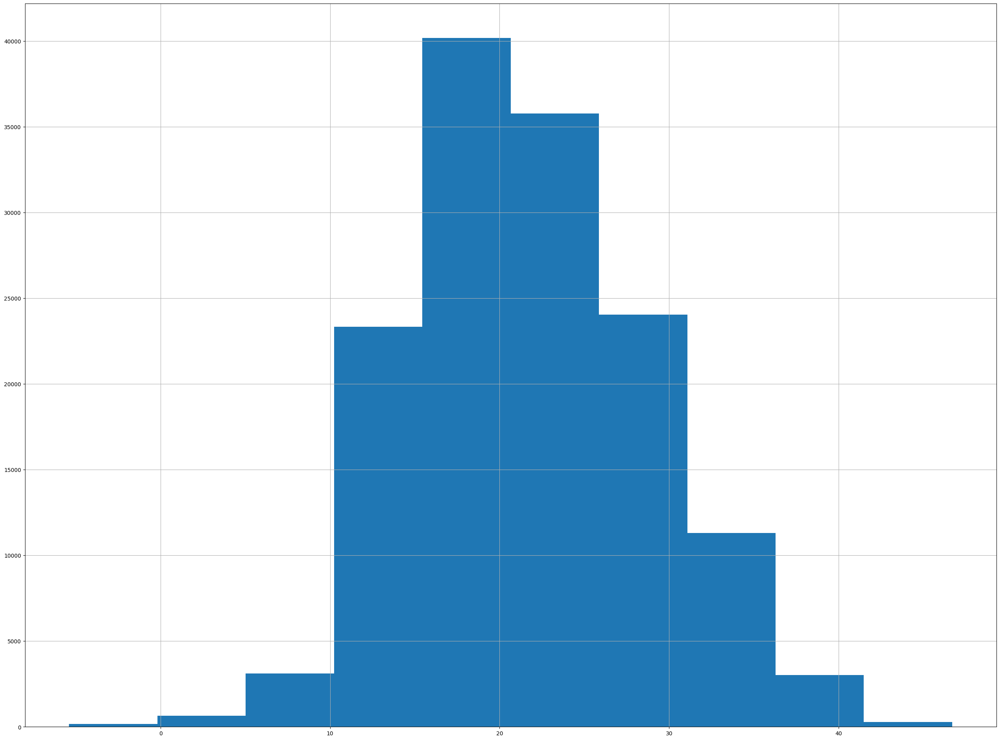

RainToday


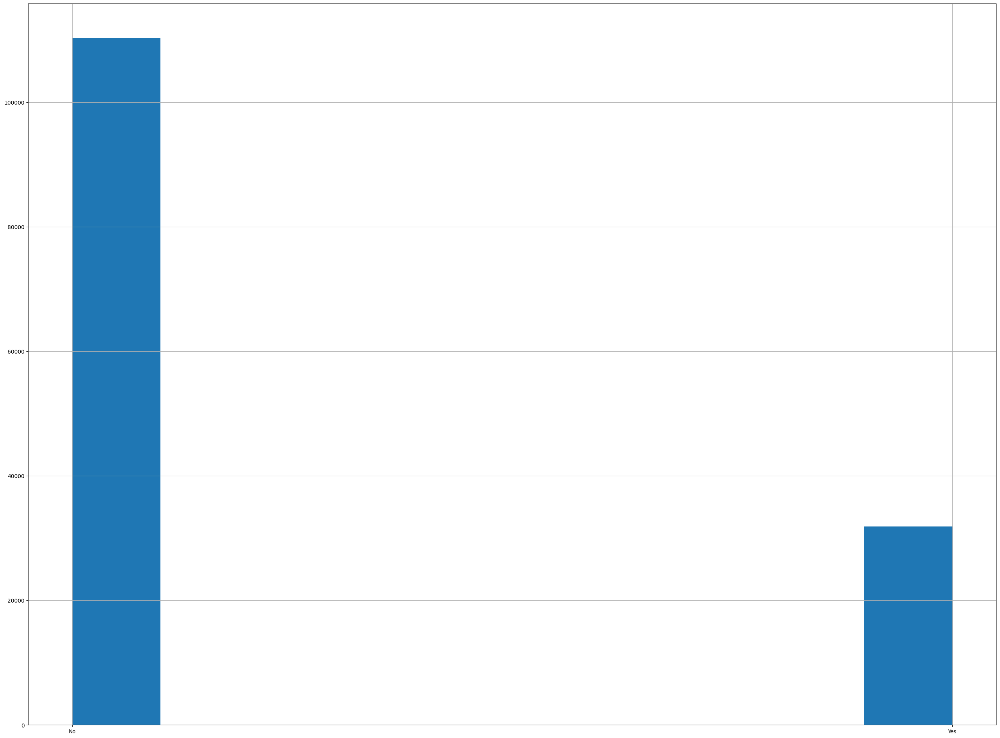

RainTomorrow


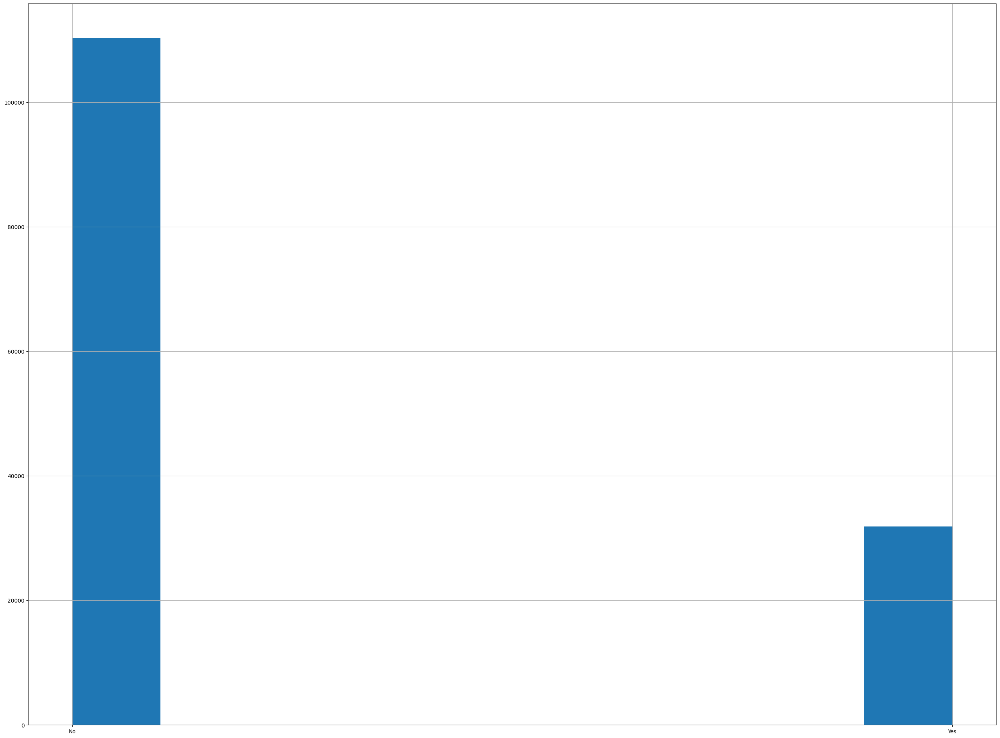

Year


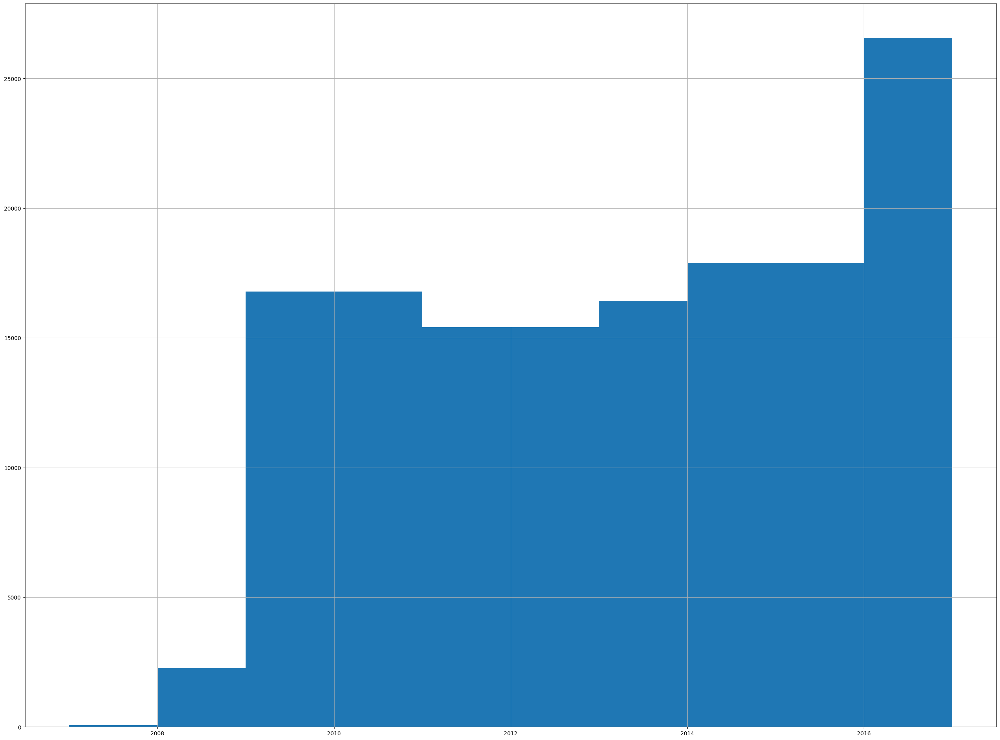

Month


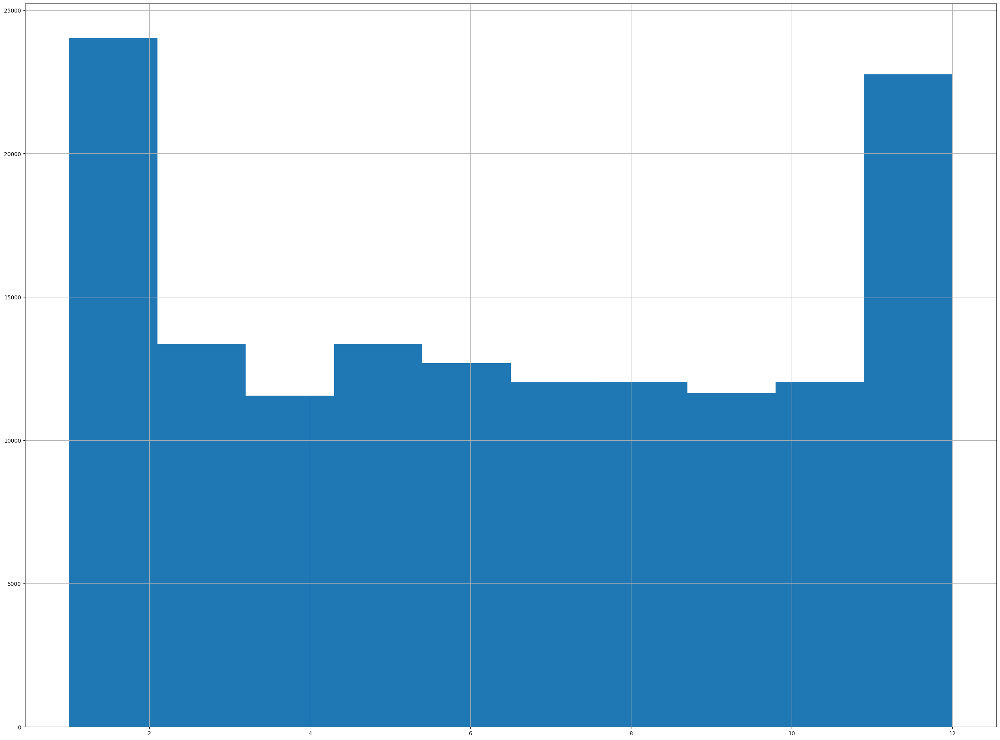

Day


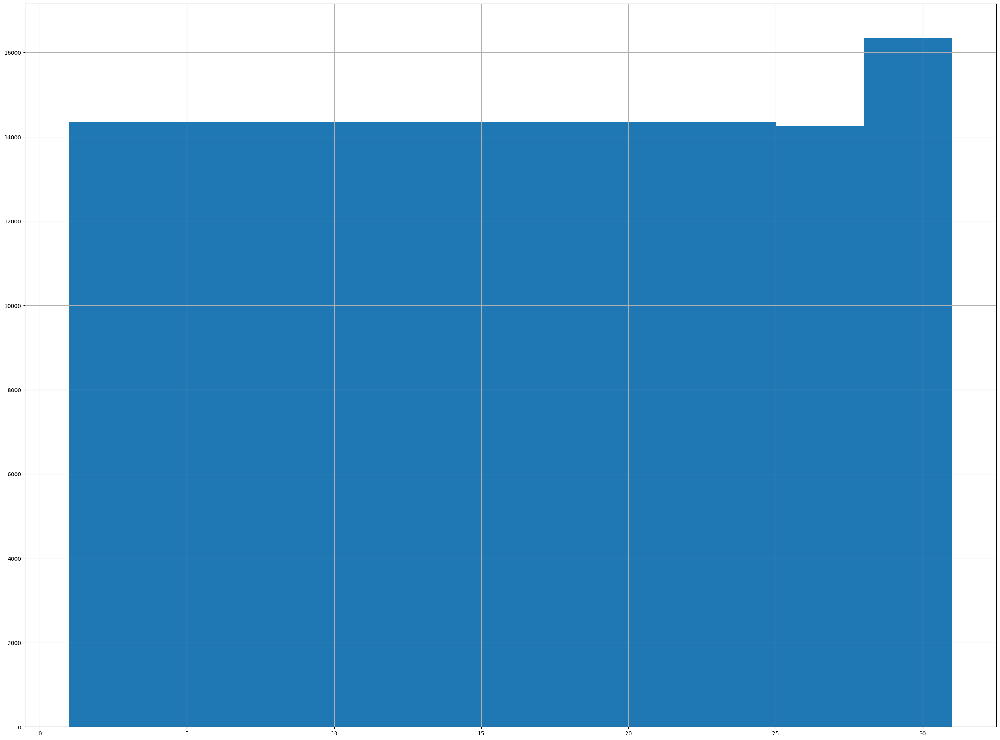

In [114]:
for i, column in enumerate(data):
    print(column)
    plt.figure(i)
    df[column].hist()
    plt.show()

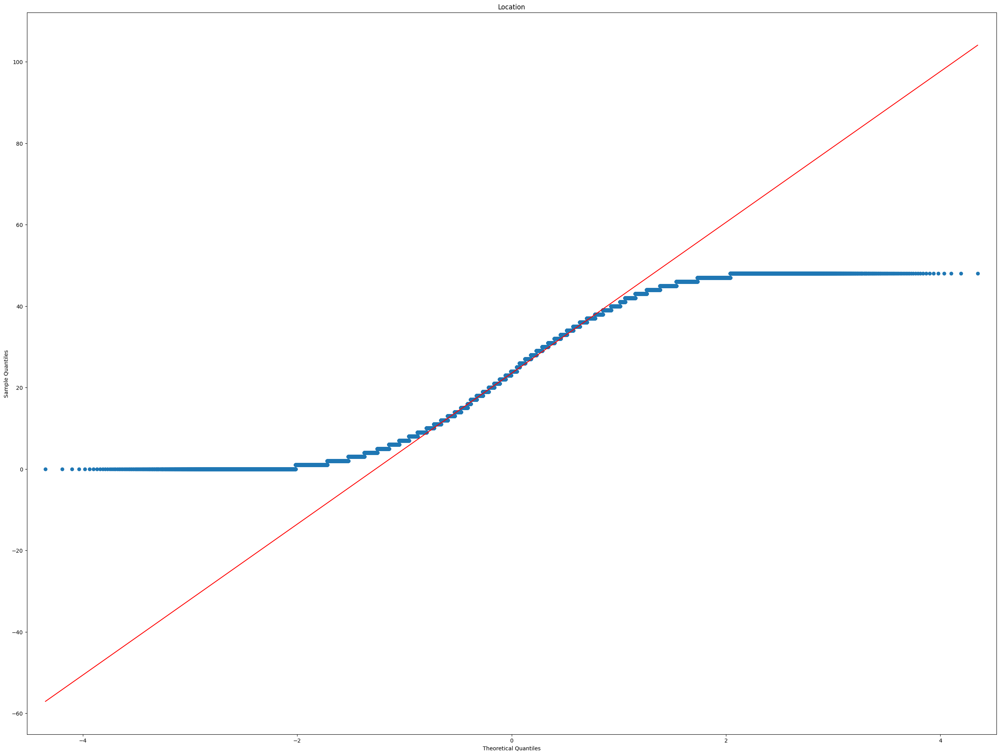

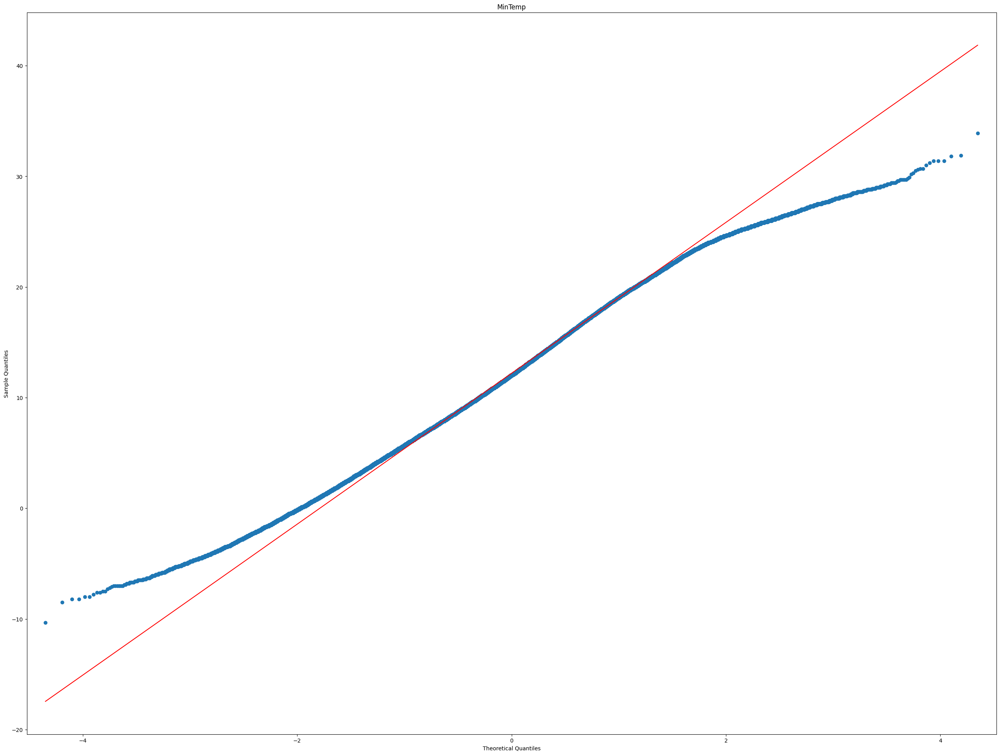

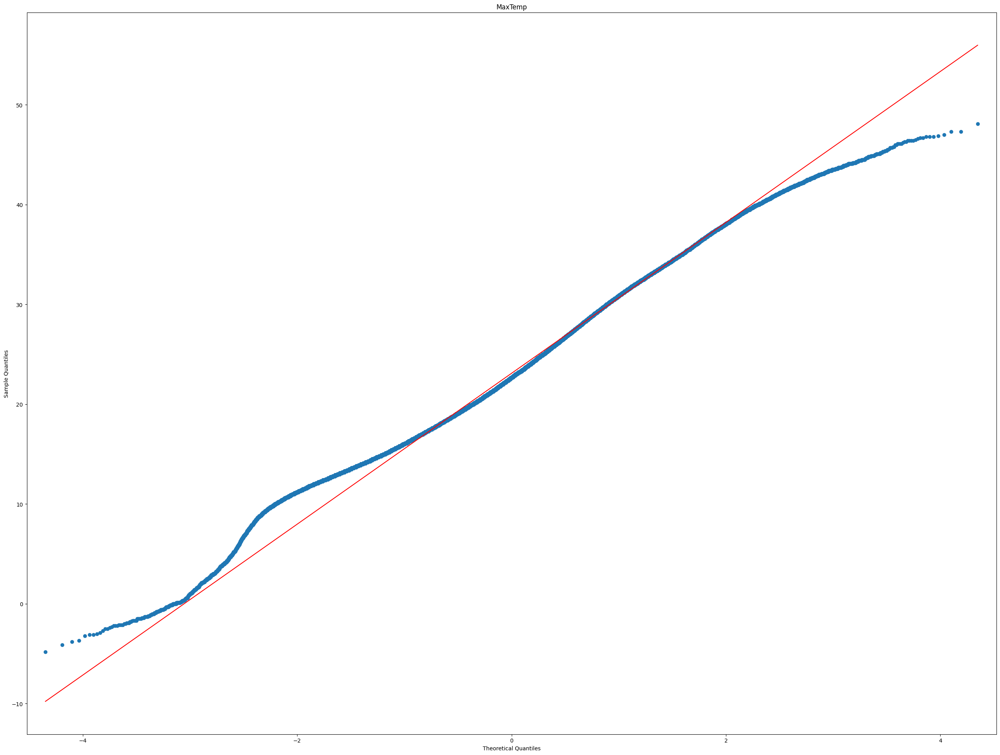

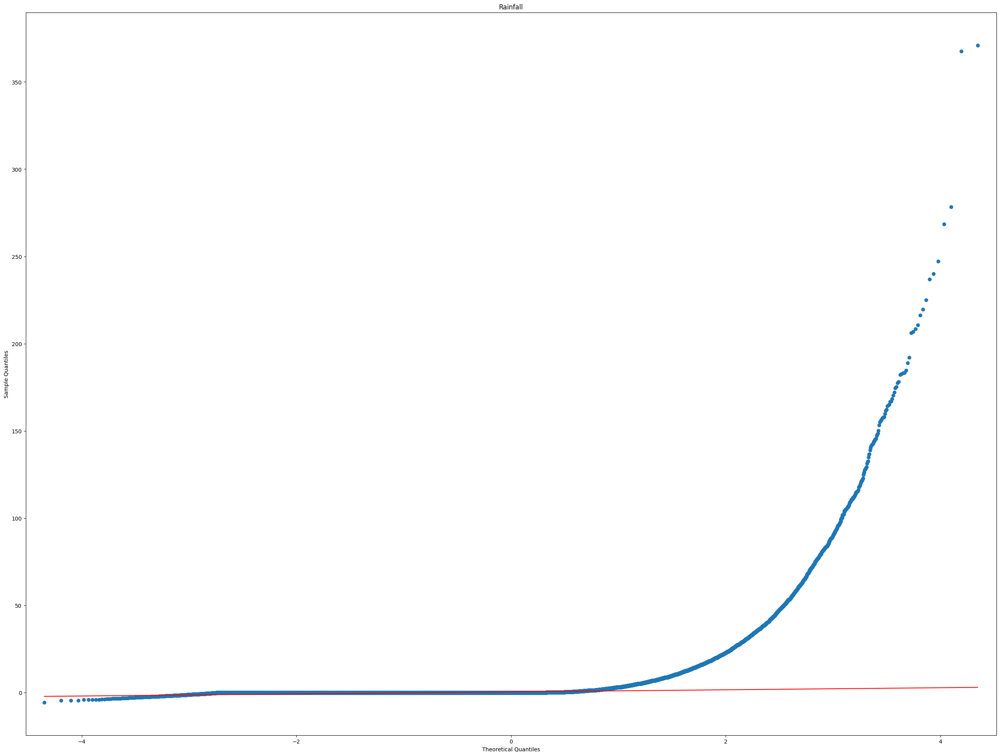

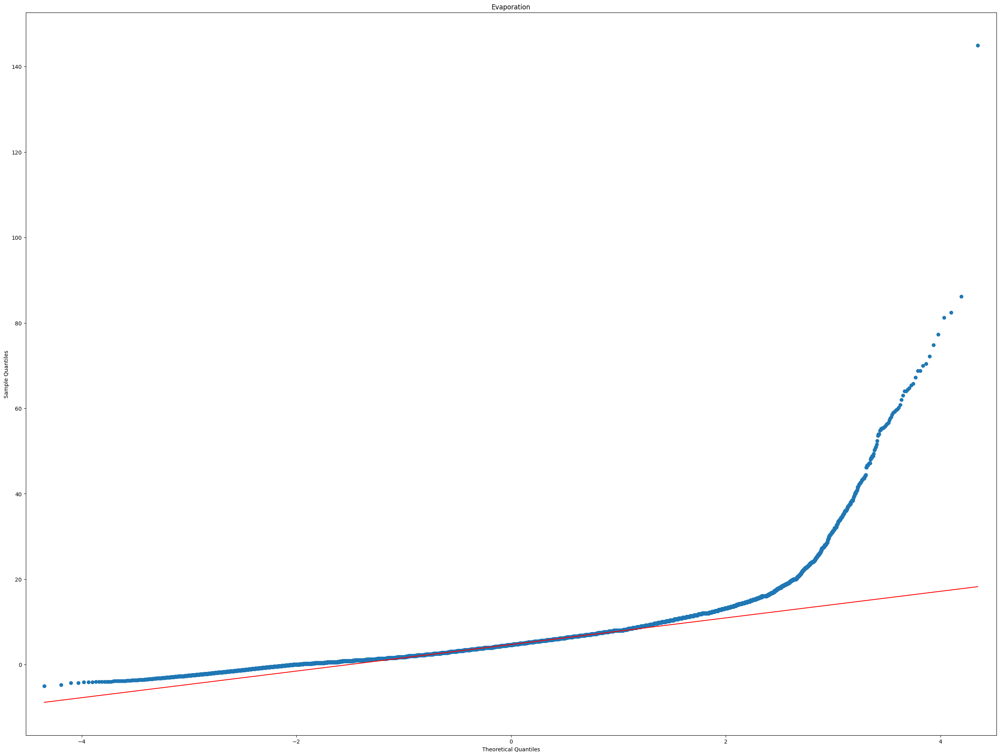

...

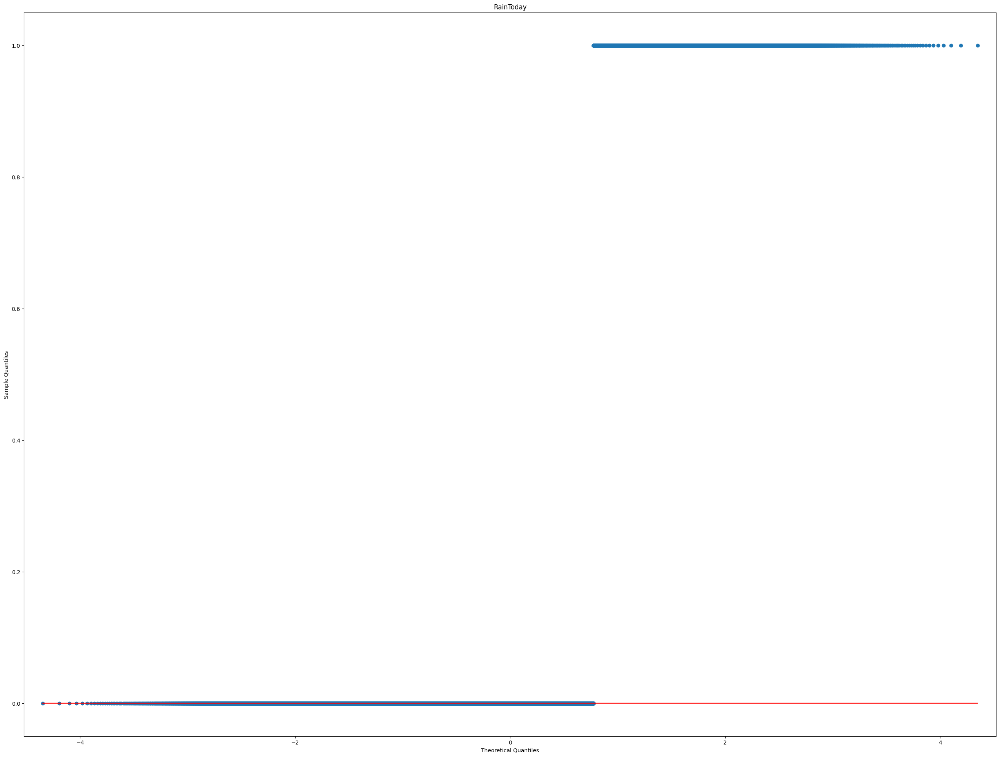

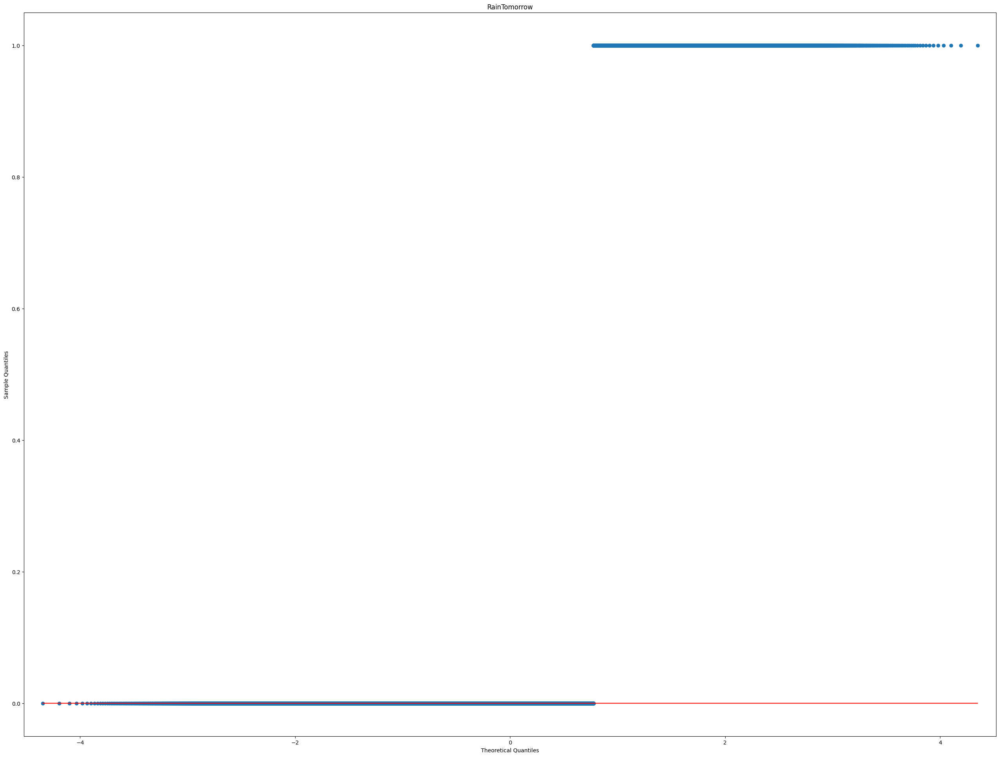

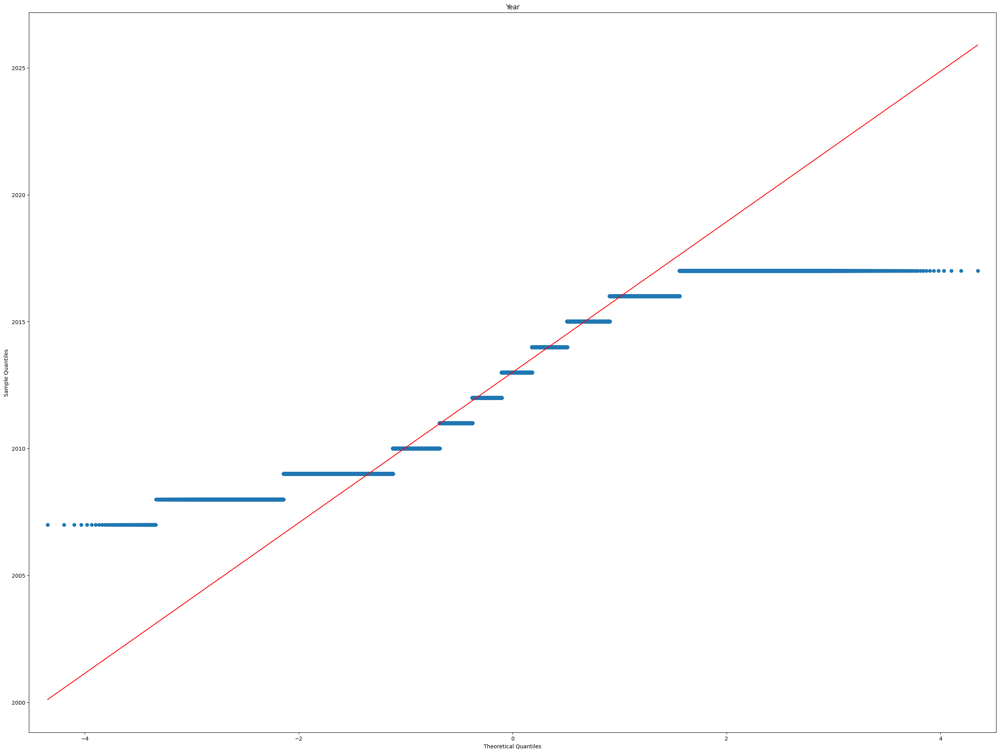

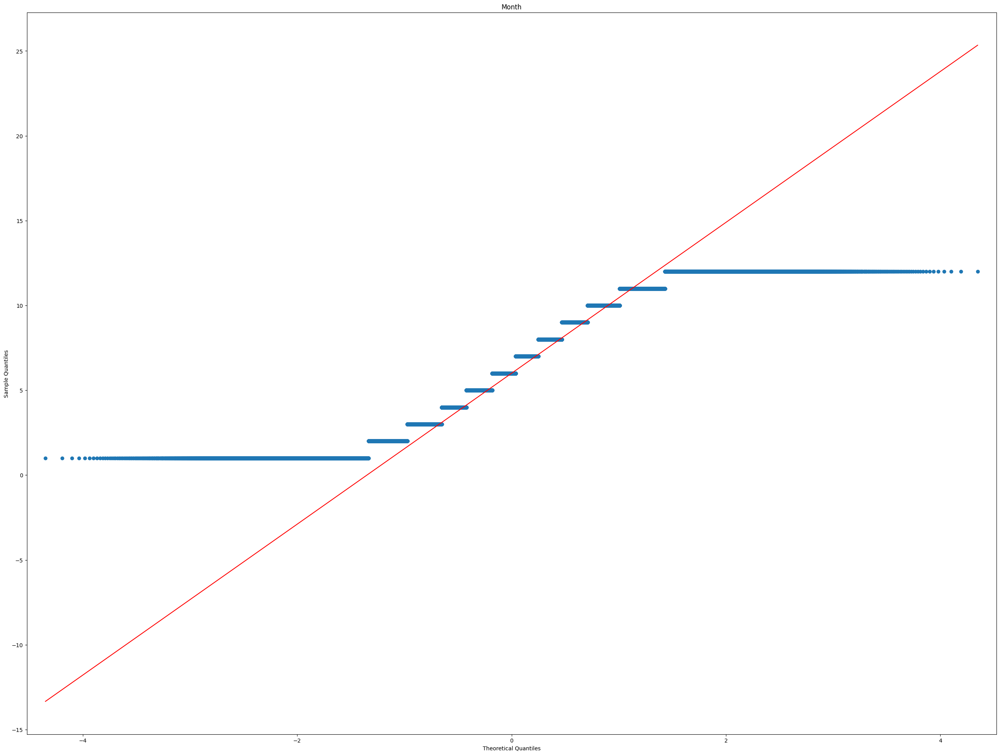

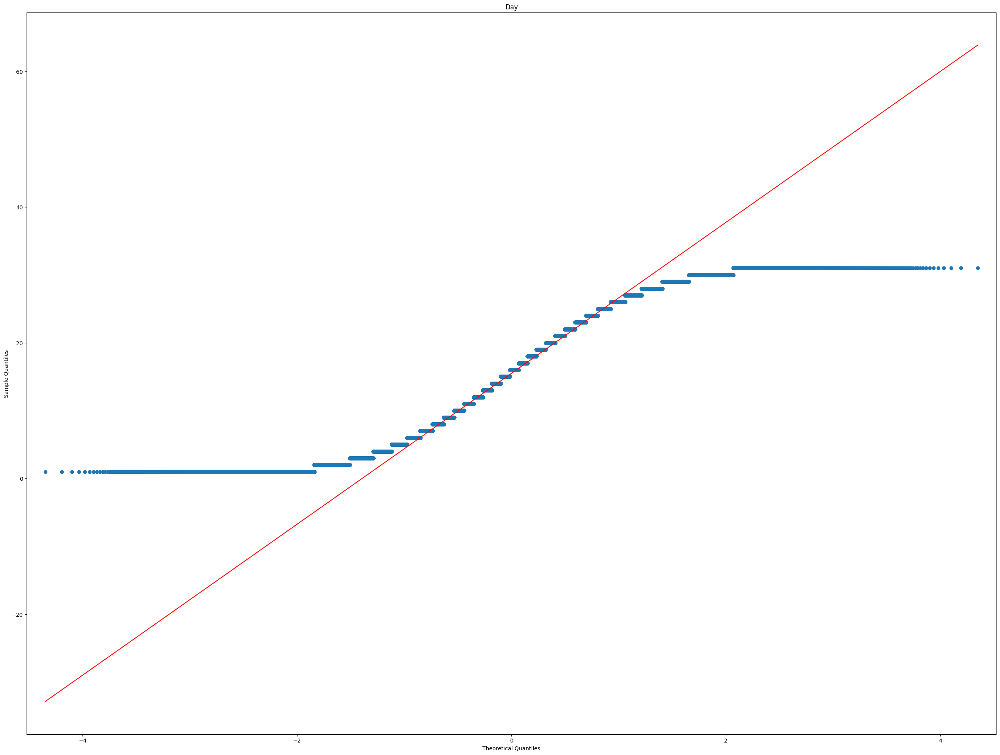

In [115]:
import statsmodels.api as sm
from scipy.stats import norm
import pylab

for column in data:
    sm.qqplot(data[column], line='q')
    pylab.title(column)
    pylab.show()

## Checking imbalance in target variable

Logistic regression is a popular method for binary classification problems, where the goal is to predict a binary outcome based on a set of input features. One important assumption of logistic regression is that the input features are balanced, meaning that the number of examples in each category is roughly equal. We will explore why balanced categorical data is required for logistic regression and how to handle imbalanced data using two common methods: undersampling and oversampling.  
  \

**Why balanced categorical data is required for logistic regression**  

Balanced categorical data is required for logistic regression because it ensures that the logistic regression model is not biased towards the majority class. When the number of examples in each category is imbalanced, the logistic regression model may be biased towards the majority class, leading to poor performance on the minority class. For example, if there are 90% positive examples and only 10% negative examples, the logistic regression model may predict all examples as positive, leading to poor performance on the negative examples.  
  \

**Handling imbalanced data using undersampling**  
Undersampling is a method for handling imbalanced data by reducing the size of the majority class. In undersampling, a random subset of the majority class is selected to match the size of the minority class. Undersampling works well when the majority class contains many redundant or similar examples, but it can discard important information and may not work well with small datasets.  
  \
**Handling imbalanced data using oversampling**  

Oversampling is a method for handling imbalanced data by increasing the size of the minority class. In oversampling, new examples are generated for the minority class, either by duplicating existing examples or by generating synthetic examples. Oversampling works well when the minority class contains unique or important information, but it can lead to overfitting and may not work well with high-dimensional data.  
  \

Balanced categorical data is required for logistic regression to ensure that the model is not biased towards the majority class. When the number of examples in each category is imbalanced, undersampling and oversampling are two common methods for handling imbalanced data. It is important to consider the characteristics of the dataset and the goals of the model when selecting a method for handling imbalanced data to ensure accurate and reliable predictions.

<Axes: xlabel='RainTomorrow', ylabel='count'>

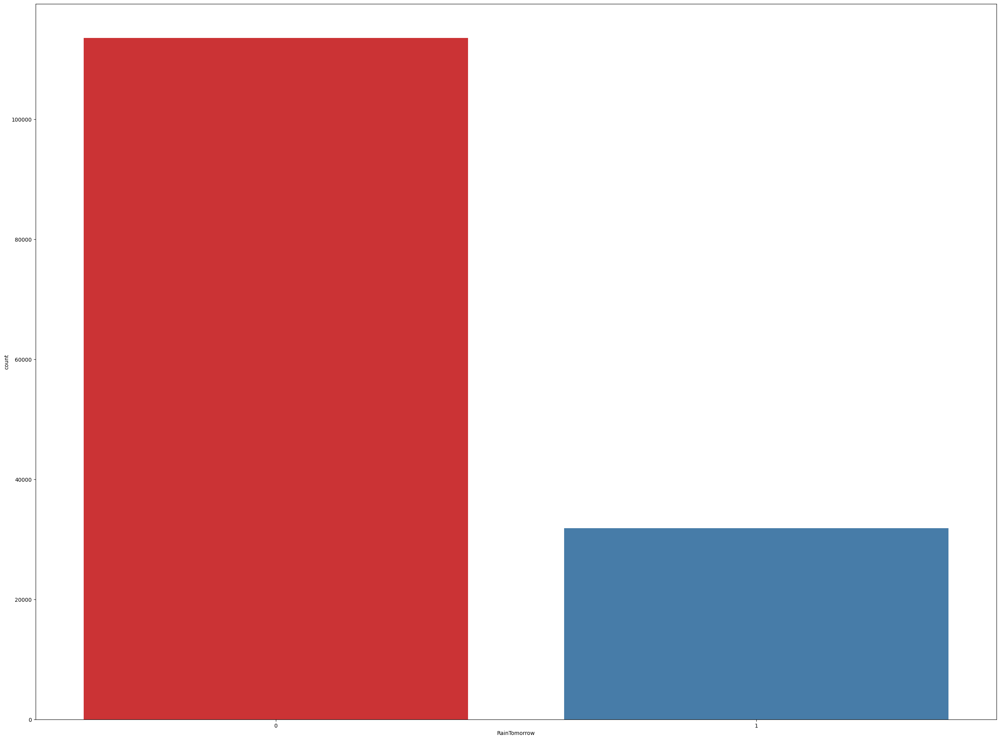

In [116]:
sns.countplot(x='RainTomorrow', data = data, palette = "Set1")

In [117]:
for column in data[features]:
  # Calculate the frequency of each category
  freq = data[column].value_counts()
  print(column)
  # Print the frequency of each category
  print(freq)
  print("")

Location
9     3436
37    3344
13    3193
18    3193
7     3193
0     3193
31    3193
15    3193
1     3040
22    3040
5     3040
39    3040
14    3040
8     3040
17    3040
3     3040
6     3040
2     3040
23    3040
47    3040
24    3039
40    3039
30    3039
48    3009
28    3009
10    3009
11    3009
21    3009
35    3009
32    3009
29    3009
46    3009
4     3009
20    3009
27    3009
19    3009
34    3009
38    3009
42    3009
45    3009
12    3009
44    3009
33    3009
43    3006
26    3004
36    3001
16    1578
25    1578
41    1578
Name: Location, dtype: int64

WindGustDir
13    20241
9      9418
3      9313
10     9216
0      9181
8      9168
15     9069
12     8967
11     8736
14     8252
7      8122
1      8104
2      7372
4      7133
6      6620
5      6548
Name: WindGustDir, dtype: int64

WindDir9am
3     22324
9      9287
0      9176
10     9112
7      8749
8      8659
13     8459
12     8423
5      8129
6      7980
1      7836
4      7671
2      7630
11     7587
14    

In [118]:
normalized_data = data.copy()
for column in normalized_data[features]:
  # Calculate the frequency of each category
  freq = normalized_data[column].value_counts(normalize=True)
  print(column)
  # Print the frequency of each category
  print(freq)
  print("")

Location
9     0.023622
37    0.022989
13    0.021951
18    0.021951
7     0.021951
0     0.021951
31    0.021951
15    0.021951
1     0.020899
22    0.020899
5     0.020899
39    0.020899
14    0.020899
8     0.020899
17    0.020899
3     0.020899
6     0.020899
2     0.020899
23    0.020899
47    0.020899
24    0.020892
40    0.020892
30    0.020892
48    0.020686
28    0.020686
10    0.020686
11    0.020686
21    0.020686
35    0.020686
32    0.020686
29    0.020686
46    0.020686
4     0.020686
20    0.020686
27    0.020686
19    0.020686
34    0.020686
38    0.020686
42    0.020686
45    0.020686
12    0.020686
44    0.020686
33    0.020686
43    0.020665
26    0.020652
36    0.020631
16    0.010848
25    0.010848
41    0.010848
Name: Location, dtype: float64

WindGustDir
13    0.139152
9     0.064746
3     0.064024
10    0.063358
0     0.063117
8     0.063028
15    0.062347
12    0.061646
11    0.060058
14    0.056730
7     0.055837
1     0.055713
2     0.050681
4     0.049038
6 

[Text(0.5, 1.0, 'RainTomorrow Indicator No(0) and Yes(1) after Oversampling (Balanced Dataset)')]

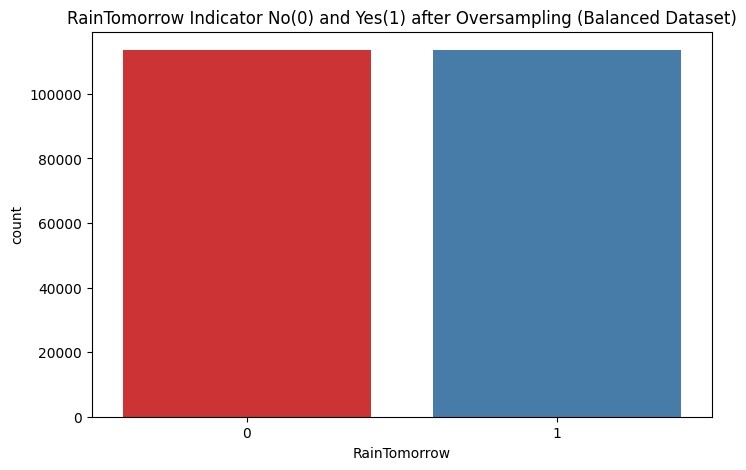

In [119]:
from sklearn.utils import resample

no = normalized_data[normalized_data.RainTomorrow == 0]
yes = normalized_data[normalized_data.RainTomorrow == 1]
yes_oversampled = resample(yes, replace=True, n_samples=len(no), random_state=123)
oversampled_data = pd.concat([no, yes_oversampled])

fig = plt.figure(figsize = (8,5))
sns.countplot(x='RainTomorrow', data = oversampled_data, palette = "Set1").set(title='RainTomorrow Indicator No(0) and Yes(1) after Oversampling (Balanced Dataset)')


## Normalization is required for logistic regression

<Axes: >

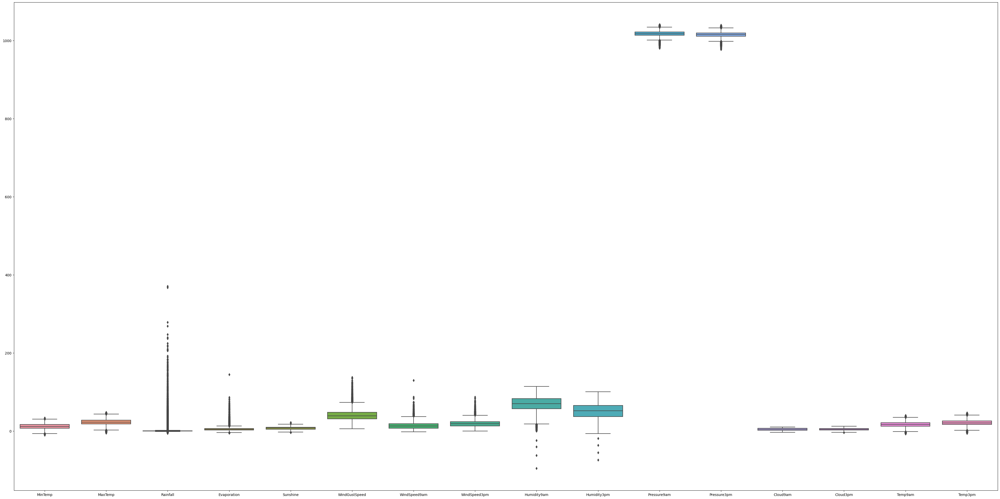

In [120]:
#Checking the Ranges of the predictor variables and dependent variable

plt.figure(figsize=(50,25))
sns.boxplot(data=normalized_data[numerical_columns])


In [121]:

from sklearn import preprocessing

scaled_data = normalized_data.copy()

r_scaler = preprocessing.MinMaxScaler()
r_scaler.fit(scaled_data[numerical_columns])
scaled_data[numerical_columns] = pd.DataFrame(r_scaler.transform(scaled_data[numerical_columns]), index=scaled_data[numerical_columns].index, columns=scaled_data[numerical_columns].columns)


In [122]:
scaled_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 25 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Location       145460 non-null  int64  
 1   MinTemp        145460 non-null  float64
 2   MaxTemp        145460 non-null  float64
 3   Rainfall       145460 non-null  float64
 4   Evaporation    145460 non-null  float64
 5   Sunshine       145460 non-null  float64
 6   WindGustDir    145460 non-null  int64  
 7   WindGustSpeed  145460 non-null  float64
 8   WindDir9am     145460 non-null  int64  
 9   WindDir3pm     145460 non-null  int64  
 10  WindSpeed9am   145460 non-null  float64
 11  WindSpeed3pm   145460 non-null  float64
 12  Humidity9am    145460 non-null  float64
 13  Humidity3pm    145460 non-null  float64
 14  Pressure9am    145460 non-null  float64
 15  Pressure3pm    145460 non-null  float64
 16  Cloud9am       145460 non-null  float64
 17  Cloud3pm       145460 non-nul

<Axes: >

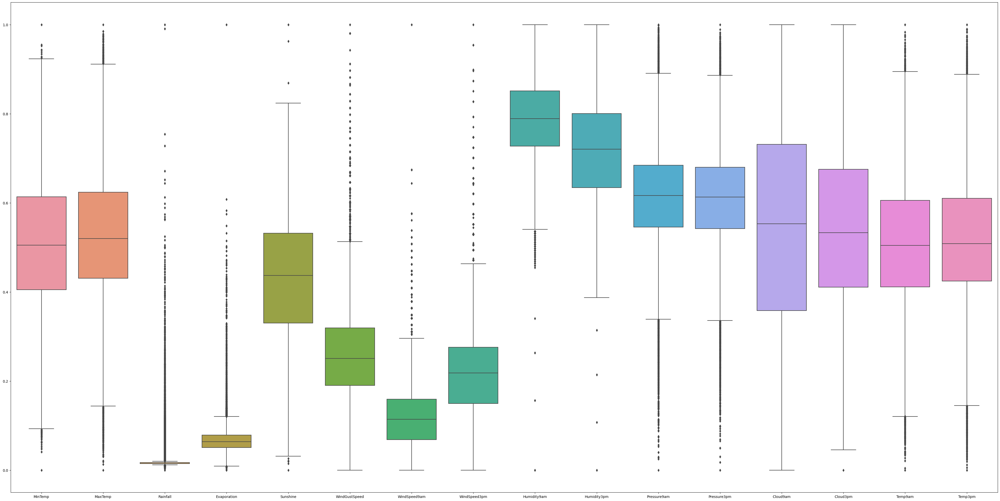

In [123]:
plt.figure(figsize=(50,25))
sns.boxplot(data=scaled_data[numerical_columns])


## Check for correlation among independant variables

Multicollinearity is a common issue in data analysis and modeling, where two or more input features are highly correlated with each other. In this tutorial, we'll explore how multicollinearity affects logistic regression and decision trees, and how to handle it using two common methods: feature selection and dimensionality reduction.  
  \

**How multicollinearity affects logistic regression**  
Multicollinearity affects logistic regression by inflating the variance of the estimated regression coefficients, which can lead to unstable and unreliable predictions. When two or more input features are highly correlated, it becomes difficult to determine which feature is driving the prediction, leading to uncertainty and instability in the model. In severe cases of multicollinearity, the regression coefficients may even have the wrong sign, leading to incorrect predictions.  
  \


**How multicollinearity affects decision trees**  
Multicollinearity affects decision trees by reducing the importance and accuracy of the input features. When two or more input features are highly correlated, the decision tree may split on one feature instead of the other, leading to a less accurate and less informative model. Additionally, multicollinearity can lead to overfitting, where the decision tree fits the noise in the data instead of the underlying pattern.  
  \


**Handling multicollinearity using feature selection**  
Feature selection is a method for handling multicollinearity by selecting a subset of the input features that are most relevant and informative for the prediction. Feature selection can be done using various methods, such as correlation analysis, mutual information, and recursive feature elimination. By selecting a subset of the input features that are independent and uncorrelated, feature selection reduces the impact of multicollinearity on the model.  
  \


**Handling multicollinearity using dimensionality reduction**  
Dimensionality reduction is a method for handling multicollinearity by transforming the input features into a lower-dimensional space that captures the most important and informative aspects of the data. Dimensionality reduction can be done using various methods, such as principal component analysis (PCA) and linear discriminant analysis (LDA). By reducing the dimensionality of the input features, dimensionality reduction reduces the impact of multicollinearity on the model and improves the stability and reliability of the predictions.  
  \


Multicollinearity affects logistic regression and decision trees by reducing the stability, reliability, and accuracy of the models. Feature selection and dimensionality reduction are two common methods for handling multicollinearity, and they can be used to select a subset of the input features that are most relevant and informative for the prediction. It is important to consider the characteristics of the dataset and the goals of the model when selecting a method for handling multicollinearity to ensure accurate and reliable predictions.

<Axes: >

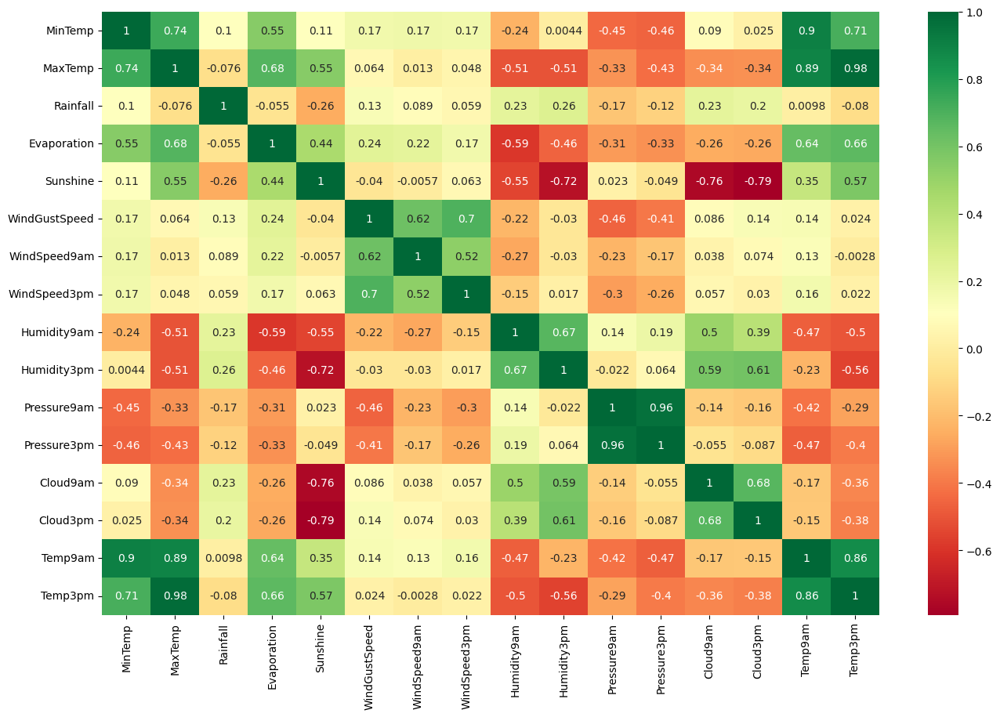

In [124]:
#the heat map of the correlation
plt.figure(figsize=(16,10))
sns.heatmap(scaled_data[numerical_columns].corr(), annot=True, cmap='RdYlGn')

# **Data Splitting**



In [125]:
from sklearn.model_selection import train_test_split

X = scaled_data.drop("RainTomorrow", axis=1)
y = scaled_data["RainTomorrow"]


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
X_train_rfe, X_test_rfe, y_train_rfe, y_test_rfe = train_test_split(X, y, test_size=0.2, random_state=0)
X_train_kbest, X_test_kbest, y_train_kbest, y_test_kbest = train_test_split(X, y, test_size=0.2, random_state=0)


In [126]:
X_train_shap = shap.utils.sample(X_train, 100)
X_test_shap = shap.utils.sample(X_test, 100)

# **Fit a linear model and interpret the regression coefficients**

### **Linear Statistical Modelling**


Mathematical relationships can be used to understand how variables are related to each other. In experimental research, we often collect data to understand these relationships and make predictions. One way to do this is by using linear models.  

Linear models are equations that describe how one variable (the response variable) is related to one or more other variables (predictor variables). Linear regression is a statistical method that helps us create these models.  

For example, if we are interested in understanding how a person's height (predictor variable) is related to their weight (response variable), we can use linear regression to create a model that describes this relationship. The model will take into account any other relevant variables (such as age, gender, or lifestyle factors) that may also be related to weight. The relationship is fit into a linear equation:  
  > y=β0+∑ βiXi+ϵi 


By analyzing the data and fitting a linear regression model, we can estimate the coefficients (represented by beta) that describe the relationship between the predictor variable(s) and the response variable. We can then use this model to predict the response variable for new values of the predictor variable(s) that were not included in the original data set.  

Overall, linear models and regression analysis are powerful tools for understanding the relationships between variables, making predictions, and informing decision-making in a wide range of fields, including science, finance, and medicine.  

### OLS Classification

In [127]:
import statsmodels.api as sm

X_OLS_train = scaled_data.drop(["RainTomorrow","Temp9am","Day"], axis=1)
y_OLS_train = scaled_data["RainTomorrow"]


X_OLS_train = sm.add_constant(X_OLS_train)
model = sm.OLS(y_OLS_train, X_OLS_train)
results = model.fit()
print(results.params) 


const            1.818636
Location        -0.000312
MinTemp         -0.224532
MaxTemp          0.409566
Rainfall         0.538891
Evaporation      0.300930
Sunshine        -0.691244
WindGustDir      0.000491
WindGustSpeed    0.935116
WindDir9am      -0.001946
WindDir3pm       0.001659
WindSpeed9am    -0.098291
WindSpeed3pm    -0.357843
Humidity9am     -0.103324
Humidity3pm      1.277671
Pressure9am      1.093327
Pressure3pm     -1.633713
Cloud9am        -0.101737
Cloud3pm         0.054716
Temp3pm         -0.066130
RainToday        0.111676
Year            -0.001028
Month            0.001183
dtype: float64


In [128]:
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:           RainTomorrow   R-squared:                       0.321
Model:                            OLS   Adj. R-squared:                  0.321
Method:                 Least Squares   F-statistic:                     3131.
Date:                Sun, 23 Apr 2023   Prob (F-statistic):               0.00
Time:                        19:21:22   Log-Likelihood:                -49802.
No. Observations:              145460   AIC:                         9.965e+04
Df Residuals:                  145437   BIC:                         9.988e+04
Df Model:                          22                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             1.8186      0.716      2.538      0.011       0.414       3.223
Location         -0.0003   6.34e-05     -4.924      0.000      -0.000      -0.000
MinTemp          -0.2245      0.016    -14.237      0.000      -0.255      -0.194
MaxTemp           0.4096      0.046      8.928      0.000       0.320       0.499
Rainfall          0.5389      0.047     11.380      0.000       0.446       0.632
Evaporation       0.3009      0.057      5.248      0.000       0.189       0.413
Sunshine         -0.6912      0.016    -43.133      0.000      -0.723      -0.660
WindGustDir       0.0005      0.000      2.034      0.042    1.79e-05       0.001
WindGustSpeed     0.9351      0.015     61.626      0.000       0.905       0.965
WindDir9am       -0.0019      0.000     -8.689      0.000      -0.002      -0.002
WindDir3pm        0.0017      0.000      6.603      0.000       0.001       0.002
WindSpeed9am     -0.0983      0.019     -5.306      0.000      -0.135      -0.062
WindSpeed3pm     -0.3578      0.013    -27.027      0.000      -0.384      -0.332
Humidity9am      -0.1033      0.017     -6.106      0.000      -0.136      -0.070
Humidity3pm       1.2777      0.017     73.312      0.000       1.244       1.312
Pressure9am       1.0933      0.038     28.458      0.000       1.018       1.169
Pressure3pm      -1.6337      0.039    -41.504      0.000      -1.711      -1.557
Cloud9am         -0.1017      0.008    -12.592      0.000      -0.118      -0.086
Cloud3pm          0.0547      0.011      5.070      0.000       0.034       0.076
Temp3pm          -0.0661      0.049     -1.342      0.180      -0.163       0.030
RainToday         0.1117      0.003     40.568      0.000       0.106       0.117
Year             -0.0010      0.000     -2.883      0.004      -0.002      -0.000
Month             0.0012      0.000      4.281      0.000       0.001       0.002
==============================================================================
Omnibus:                    13980.682   Durbin-Watson:                   1.913
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            18353.836
Skew:                           0.841   Prob(JB):                         0.00
Kurtosis:                       3.448   Cond. No.                     1.61e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.61e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

We are able to reject the null hypothesis as the probability in F statistic is 0.  

There are a few features like MinTemp, MaxTemp, Sunshine, WindGustSpeed, WindSpeed9am, WindSpeed3pm, Humidity9am, Humidity3pm, Pressure9am, Pressure3pm, Cloud9am, Cloud3pm, Temp9am and Temp3pm which show non-zero correlation as per Ordinary Least Squares regression model as they have a high p-value.

From the table we also see that all the features have very corerlation with the target. The fetaures Year, Rainfall, Evaporation, and WindGustDir have somewhat positive correlation with the target variable whereas MaxTemp and WindDir3pm have negative coefficient. All other features have a very low correlation coefficient.

### **Logistic Regression Model**
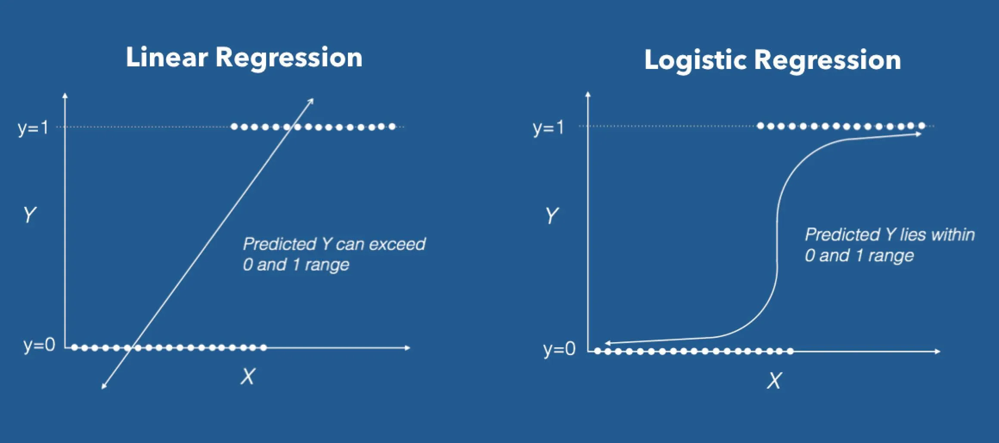

**Assumptions**  
  \
Before applying logistic regression, there are a few assumptions that need to be met:  

**Binary outcome**: The dependent variable should be binary, meaning it can take on one of two possible values.
**Independence of observations**: The observations in the data set should be independent of each other, meaning that one observation should not be influenced by another observation.  
**Linearity of independent variables and log odds**: The relationship between the independent variables and the log odds of the outcome should be linear.
**No multicollinearity**: There should be no perfect multicollinearity, meaning that the independent variables should not be too highly correlated with each other.  
**Model Formulation**
Logistic regression models the relationship between the dependent variable and one or more independent variables using the logistic function, which is a special type of sigmoid function that can map any real-valued number to the range of [0,1]. The logistic function is defined as:  
  \
> $p(y=1) = \frac{1}{1 + \exp(-z)}$ 

  \
where $z$ is a linear combination of the independent variables, also known as the logit. The logit is defined as:  
  \
> $z = \beta_0 + \beta_1x_1 + \beta_2x_2 + ... + \beta_px_p$

  
  \
where $\beta_0$ is the intercept term, $\beta_1$ through $\beta_p$ are the coefficients for the independent variables $x_1$ through $x_p$, and $p$ is the number of independent variables.

The logistic regression model estimates the coefficients $\beta_0$ through $\beta_p$ using maximum likelihood estimation, which involves finding the values of the coefficients that maximize the likelihood of observing the data given the model. The likelihood function is defined as:  
  \
> $L(\beta) = \prod_{i=1}^n [p(y_i|x_i;\beta)^{y_i} * (1-p(y_i|x_i;\beta))^{(1-y_i)}]$
 
  
  \
where $y_i$ is the binary outcome for observation $i$, $x_i$ is the vector of independent variables for observation $i$, and $n$ is the number of observations in the data set.

The goal of logistic regression is to find the values of $\beta_0$ through $\beta_p$ that maximize the likelihood function. This is typically done using iterative algorithms such as gradient descent or Newton-Raphson.  
  \

**Interpretation of Coefficients**  
  \
Once the coefficients $\beta_0$ through $\beta_p$ have been estimated, they can be interpreted as follows:

$\beta_0$ is the log odds of the outcome when all independent variables are equal to zero.
$\beta_j$ is the change in log odds of the outcome for a one-unit increase in the independent variable $x_j$, holding all other independent variables constant.
The log odds can be transformed into odds ratios or probabilities using the following formulas:

Odds ratio: $e^{\beta_j}$ is the odds ratio, which represents the multiplicative change in the odds of the outcome for a one-unit increase in the independent

In [129]:
# train a logistic regression model on the training set
from sklearn.linear_model import LogisticRegression


# instantiate the model
logreg = LogisticRegression(solver='liblinear', random_state=0)

# fit the model
lr_model  = logreg.fit(X_train, y_train)

In [130]:
y_pred_test = logreg.predict(X_test)
print(y_pred_test)

[0 0 0 ... 1 0 0]


In [131]:
# probability of getting output as 0 - no rain
proba_0 = logreg.predict_proba(X_test)[:,0]

# probability of getting output as 1 - rain
prob_1 = logreg.predict_proba(X_test)[:,1]

In [132]:
print("Probability of no Rain", proba_0)
print("Probability of Rain", prob_1)
print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred_test)))

Probability of no Rain [0.74441107 0.81819868 0.89019962 ... 0.39846061 0.7423974  0.97301733]
Probability of Rain [0.25558893 0.18180132 0.10980038 ... 0.60153939 0.2576026  0.02698267]
Model accuracy score: 0.8338


In [133]:
print(lr_model.coef_)

[[-1.36651544e-04  8.31065089e-01 -3.68023009e-01  1.59621653e-01
  -1.00852802e-01 -2.44306426e+00  8.92244121e-03  1.57901287e+00
  -2.79588031e-02 -1.45164655e-02  2.26468599e-01  4.23409520e-01
   7.59411951e-01  2.70560619e+00 -1.56301271e+00 -1.67465417e+00
   1.58262044e+00  2.41609156e+00  4.35489667e-01 -7.12664083e-01
   7.35579851e-01 -2.01301626e-03  1.74245627e-02 -8.58445688e-05]]


After fitting a logistic regression model, it is important to evaluate its performance to ensure that it is producing accurate predictions. In this tutorial, we will cover some of the most common performance metrics used in logistic regression.  
  \

**Confusion Matrix**  
A confusion matrix is a table that shows the number of true positives (TP), false positives (FP), true negatives (TN), and false negatives (FN) produced by a classification model. In the context of logistic regression, we can construct a confusion matrix by comparing the predicted outcomes of the model to the true outcomes in the data set.


Sure, here is the table for the confusion matrix in markdown format:

|                   | Predicted Positive | Predicted Negative |
|-------------------|--------------------|--------------------|
| Actual Positive   | TP                 | FN                 |
| Actual Negative   | FP                 | TN                 |

From the confusion matrix, we can calculate several performance metrics, including accuracy, precision, recall, and F1 score.  
  \

**Accuracy**  
Accuracy is the proportion of correct predictions out of the total number of predictions. It is defined as:

$accuracy = \frac{TP + TN}{TP + TN + FP + FN}$  
  \

**Precision**  
Precision is the proportion of true positives out of the total number of predicted positives. It is defined as:

$precision = \frac{TP}{TP + FP}$

Precision measures how well the model identifies true positives among all predicted positives. A high precision indicates that the model produces few false positives.   
  \

**Recall**    
Recall is the proportion of true positives out of the total number of actual positives. It is defined as:

$recall = \frac{TP}{TP + FN}$

Recall measures how well the model identifies all actual positives. A high recall indicates that the model produces few false negatives.    
  \

**F1 Score**  
The F1 score is the harmonic mean of precision and recall. It is defined as:

$F1 = 2 * \frac{precision * recall}{precision + recall}$

The F1 score balances precision and recall, and provides a single number that summarizes the performance of the model.  
  \
**Receiver Operating Characteristic (ROC) Curve**  
The ROC curve is a graphical representation of the performance of a binary classification model at different classification thresholds. It plots the true positive rate (TPR) against the false positive rate (FPR) at various threshold values. The TPR is also known as recall, while the FPR is defined as:

$FPR = \frac{FP}{FP + TN}$

The ROC curve allows us to visualize how well the model is able to distinguish between positive and negative cases, and to choose an appropriate threshold based on the tradeoff between TPR and FPR.  
  \

**Area Under the Curve (AUC)**  
The area under the ROC curve (AUC) is a summary statistic that measures the overall performance of the model across all possible thresholds. AUC ranges from 0 to 1, with a higher value indicating better performance. AUC can be interpreted as the probability that a randomly chosen positive example will be ranked higher than a randomly chosen negative example by the model.


Confusion matrix

 [[21328  1398]
 [ 3377  2989]]
True Positives(TP) =  21328
True Negatives(TN) =  2989
False Positives(FP) =  1398
False Negatives(FN) =  3377


<Axes: >

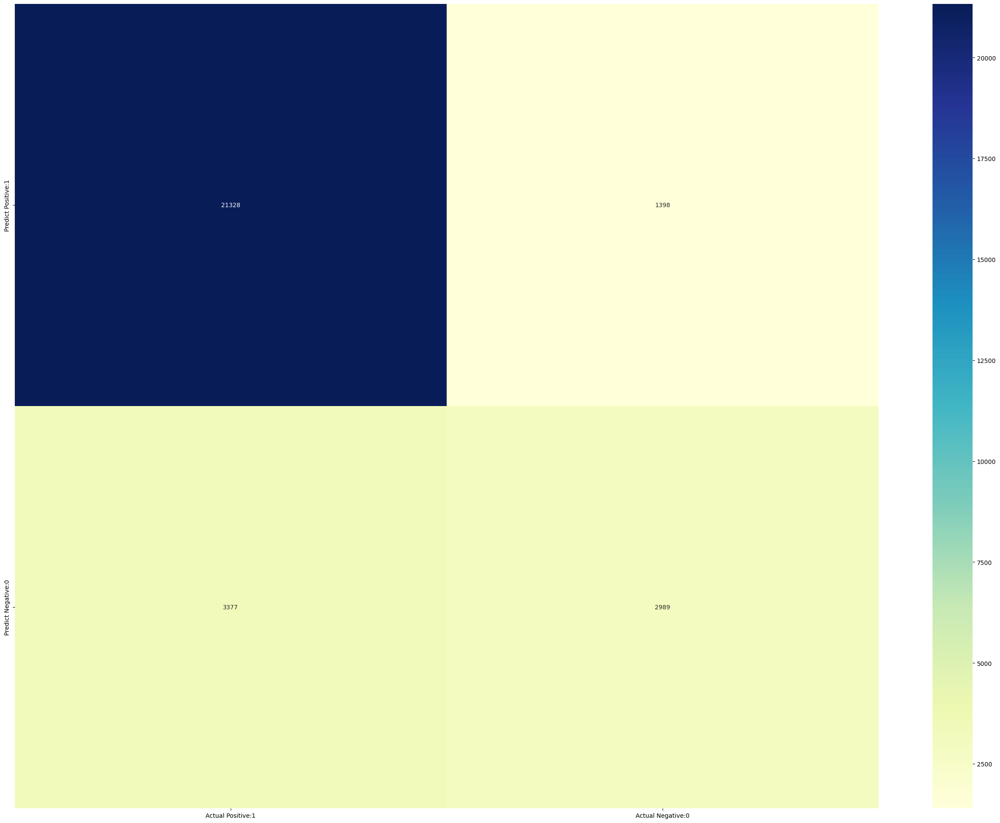

In [190]:
# Print the Confusion Matrix and slice it into four pieces
cm = confusion_matrix(y_test, y_pred_test)
print('Confusion matrix\n\n', cm)
print('True Positives(TP) = ', cm[0,0])
print('True Negatives(TN) = ', cm[1,1])
print('False Positives(FP) = ', cm[0,1])
print('False Negatives(FN) = ', cm[1,0])

# visualize confusion matrix with seaborn he[atmap
cm_matrix = pd.DataFrame(data=cm, columns=['Actual Positive:1', 'Actual Negative:0'], 
                                index=['Predict Positive:1', 'Predict Negative:0'])
sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

Cross-validation is a technique used to evaluate the performance of a machine learning model by training and testing it on multiple subsets of the data. In logistic regression, cross-validation is commonly used to tune hyperparameters, select the best model, and estimate the generalization error of the model.  
  \

**What is Cross-Validation?**  
Cross-validation is a technique for evaluating a machine learning model's performance on an independent dataset. The basic idea is to split the data into training and testing sets, fit the model on the training set, and evaluate it on the testing set. This approach has some drawbacks, such as a high variance in the estimate of the model's performance due to the randomness of the split.

Cross-validation overcomes these issues by using multiple splits of the data into training and testing sets. In k-fold cross-validation, the data is divided into k equally-sized folds, and the model is trained and tested k times, with each fold used once as the testing set and the remaining folds used as the training set. The results are then averaged to obtain a more stable estimate of the model's performance.  
  \
**Cross-Validation in Logistic Regression**  
In logistic regression, cross-validation is commonly used to tune hyperparameters, such as the regularization strength parameter C. C controls the inverse of the regularization strength, with smaller values of C corresponding to stronger regularization.



In [191]:
from sklearn.model_selection import cross_val_score

# Perform 5-fold cross-validation
scores = cross_val_score(logreg, X_test, y_test, cv=5)

# Print the cross-validation scores
print("Cross-validation scores: {}".format(scores))
print("Mean cross-validation score: {:.2f}".format(scores.mean()))

Cross-validation scores: [0.83175803 0.83347654 0.84651083 0.83585425 0.83258852]
Mean cross-validation score: 0.84


### **SHAP Analysis for Logistic Regression Model**

SHAP (SHapley Additive exPlanations) analysis is a method for explaining the output of machine learning models by measuring the contribution of each feature to the final prediction. In this tutorial, we'll explore some common techniques for SHAP analysis and how they work.  
  \

**Tree SHAP**  
Tree SHAP is a method for computing SHAP values for decision trees and tree-based ensemble models such as Random Forest and Gradient Boosted Trees. It works by recursively partitioning the data and computing the SHAP values of each partition. The resulting SHAP values can be used to explain the output of the model for a specific prediction or for the entire dataset.  
  \

**Kernel SHAP**  
Kernel SHAP is a method for computing SHAP values for any type of machine learning model by approximating the expected value of the SHAP values using a weighted sampling technique. It works by generating a large number of background samples and computing the SHAP values for each sample. The resulting SHAP values can be used to explain the output of the model for a specific prediction or for the entire dataset.  
  \

**Deep SHAP**  
Deep SHAP is a method for computing SHAP values for deep neural networks by combining the ideas of Tree SHAP and Kernel SHAP. It works by approximating the output of a deep neural network as a series of nested decision trees and computing the SHAP values of each tree using Tree SHAP. The resulting SHAP values can be used to explain the output of the model for a specific prediction or for the entire dataset.  
  \

**Advantages of SHAP Analysis**  
SHAP analysis has several advantages, including providing a clear and interpretable explanation of the output of machine learning models, allowing for the identification of important features and their contribution to the final prediction, and enabling the detection of biases and errors in the model.  
  \

**Disadvantages of SHAP Analysis**  
One of the main disadvantages of SHAP analysis is that it can be computationally expensive and time-consuming, especially for large and complex datasets or models. Additionally, SHAP analysis may require careful parameter tuning and validation to achieve optimal performance.  
  \

SHAP analysis is an important tool for explaining the output of machine learning models and identifying the contribution of each feature to the final prediction. There are several techniques for SHAP analysis, including Tree SHAP, Kernel SHAP, and Deep SHAP. Each technique has its advantages and disadvantages, and the choice of method depends on the nature and complexity of the data and the machine learning algorithm used.

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


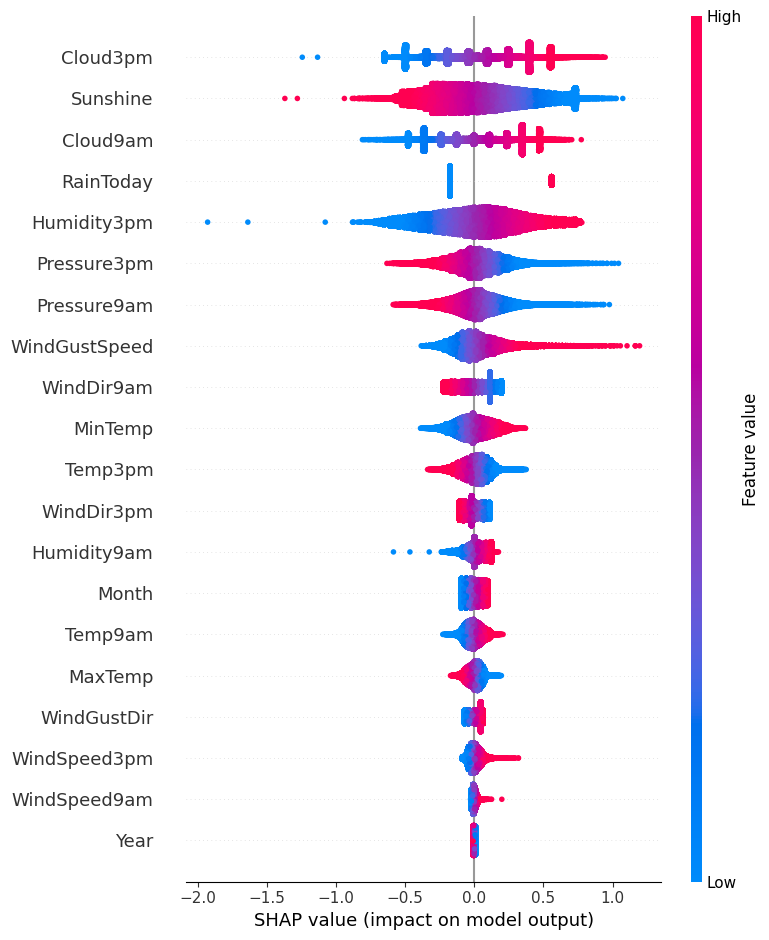

In [135]:
explainer = shap.LinearExplainer(logreg, X_train)
linear_shap_values = explainer.shap_values(X_train)

shap.summary_plot(linear_shap_values, X_train, feature_names=X_train.columns)


From the SHAP plot, we can see that high values of Cloud3pm, Cloud9am and Humidity3pm have high impact on Rain prediction, whereas low values of Pressure9am, Pressure3pm, and Sunshine also have a positive impact on Rain as is expected.

### Feature Selection Using RFE (Recursive Feature Elimination)

Feature selection is the process of selecting a subset of relevant features from a larger set of available features to improve the performance of a machine learning model. In this tutorial, we'll explore some common techniques for feature selection and how they work.  
  \

**Filter Methods**  
Filter methods are the simplest and fastest techniques for feature selection, which rank the features based on their statistical properties such as correlation or mutual information with the target variable. Examples of filter methods include Chi-squared test, correlation coefficient, and mutual information. The selected features are then used as input to the machine learning model.  
  \

**Wrapper Methods**  
Wrapper methods are more computationally expensive techniques that evaluate the performance of the machine learning model with different subsets of features. Examples of wrapper methods include Recursive Feature Elimination (RFE) and Forward Selection. These methods use a specific machine learning algorithm to evaluate the subsets of features and select the best performing subset.  
  \

**Embedded Methods**  
Embedded methods are a hybrid approach that combine the feature selection process with the model training process. These methods work by penalizing or regularizing the coefficients of the input features in the machine learning model to reduce the impact of irrelevant or redundant features. Examples of embedded methods include Lasso and Ridge Regression, Elastic Net, and Decision Trees.  
  \

**Principal Component Analysis (PCA)**  
PCA is a dimensionality reduction technique that can also be used for feature selection. It works by transforming the original set of features into a new set of uncorrelated features, called principal components, that capture most of the variance in the data. The principal components can then be ranked based on their contribution to the variance and selected as input to the machine learning model.  
  \




In [136]:
rfe = RFE(lr_model, n_features_to_select=10)
rfe.fit(X_train_rfe, y_train)

RFE(estimator=LogisticRegression(random_state=0, solver='liblinear'),
    n_features_to_select=10)

In [137]:
y_pred_test_rfe = rfe.predict(X_test_rfe)
print(y_pred_test_rfe)

[0 0 0 ... 0 0 0]


In [138]:
# probability of getting output as 0 - no rain
proba_0_rfe = rfe.predict_proba(X_test_rfe)[:,0]

# probability of getting output as 1 - rain
prob_1_rfe = rfe.predict_proba(X_test_rfe)[:,1]

In [139]:
print("Probability of no Rain", proba_0_rfe)
print("Probability of Rain", prob_1_rfe)
print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test_rfe, y_pred_test_rfe)))

Probability of no Rain [0.88875442 0.80518542 0.84725775 ... 0.50706611 0.76218045 0.96392842]
Probability of Rain [0.11124558 0.19481458 0.15274225 ... 0.49293389 0.23781955 0.03607158]
Model accuracy score: 0.8433


Feature selection is an important step in the machine learning pipeline that can improve the performance and interpretability of the model by selecting a subset of relevant features. There are several techniques for feature selection, including filter methods, wrapper methods, embedded methods, and PCA. Each technique has its advantages and disadvantages, and the choice of method depends on the nature and complexity of the data and the machine learning algorithm used.

Choosing the right statistical measure is essential to obtain accurate results. When dealing with numerical data, we can use Pearson's correlation coefficient, Spearman's rank correlation coefficient, or mutual information. When dealing with categorical data, we can use the chi-squared test or mutual information.

By using the appropriate statistical measure for filter-based feature selection, machine learning practitioners can build more accurate and efficient predictive models.







### Feature Selection using KBest features

In [140]:
selector = SelectKBest(chi2, k=10)
selector.fit(X_train_kbest, y_train)
X_new = selector.transform(X_train_kbest)
Kbest = X_train_kbest.columns[selector.get_support(indices=True)]

In [141]:
Kbest

Index(['Rainfall', 'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am',
       'WindDir3pm', 'Humidity3pm', 'Cloud9am', 'Cloud3pm', 'RainToday'],
      dtype='object')

In [142]:
X_train_kbest

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Year,Month,Day
22926,27,0.658545,0.538752,0.015368,0.066668,0.421647,2,0.349623,2,2,...,0.596694,0.5888,0.582190,0.680332,0.603376,0.529750,0,2014,3,12
80735,44,0.443722,0.544423,0.015368,0.044001,0.560992,4,0.319221,6,5,...,0.624793,0.6000,0.432917,0.556226,0.453586,0.548944,0,2016,10,6
121764,31,0.479902,0.510397,0.018555,0.041335,0.510673,12,0.152010,3,12,...,0.613223,0.6048,0.283645,0.370066,0.502110,0.516315,1,2011,8,31
139821,13,0.669851,0.655955,0.014837,0.094668,0.564863,2,0.281219,2,0,...,0.585124,0.5600,0.283645,0.308013,0.641350,0.662188,0,2010,6,11
1867,2,0.588444,0.423440,0.047764,0.036977,0.176279,0,0.106407,2,0,...,0.573554,0.5344,0.806099,0.742385,0.500000,0.435701,1,2014,4,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41993,45,0.635932,0.810964,0.014837,0.206668,0.667647,4,0.250817,5,0,...,0.561983,0.5216,0.283645,0.308013,0.687764,0.809981,0,2015,12,20
97639,0,0.516083,0.606805,0.014837,0.078367,0.526156,13,0.182412,3,14,...,0.639669,0.6432,0.447086,0.416947,0.510549,0.612284,0,2012,3,11
95939,39,0.617841,0.654064,0.014837,0.070668,0.485929,1,0.121608,7,1,...,0.646281,0.6240,0.488346,0.473530,0.660338,0.660269,0,2016,6,10
117952,32,0.502515,0.506616,0.024928,0.074668,0.437130,11,0.220415,10,14,...,0.652893,0.6624,0.731463,0.618279,0.512658,0.481766,1,2009,11,20


In [143]:
# fit the model
lr_model_kbest  = logreg.fit(X_train_kbest[Kbest], y_train_kbest)

In [144]:
y_pred_test_kbest = rfe.predict(X_test_kbest)
print(y_pred_test_kbest)

[0 0 0 ... 0 0 0]


In [145]:
# probability of getting output as 0 - no rain
proba_0_kbest = rfe.predict_proba(X_test_kbest)[:,0]

# probability of getting output as 1 - rain
prob_1_kbest = rfe.predict_proba(X_test_kbest)[:,1]

In [146]:
print("Probability of no Rain", proba_0_kbest)
print("Probability of Rain", prob_1_kbest)
print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test_kbest, y_pred_test_kbest)))

Probability of no Rain [0.88875442 0.80518542 0.84725775 ... 0.50706611 0.76218045 0.96392842]
Probability of Rain [0.11124558 0.19481458 0.15274225 ... 0.49293389 0.23781955 0.03607158]
Model accuracy score: 0.8433


Confusion matrix

 [[21567  1159]
 [ 3399  2967]]
True Positives(TP) =  21567
True Negatives(TN) =  2967
False Positives(FP) =  1159
False Negatives(FN) =  3399


<Axes: >

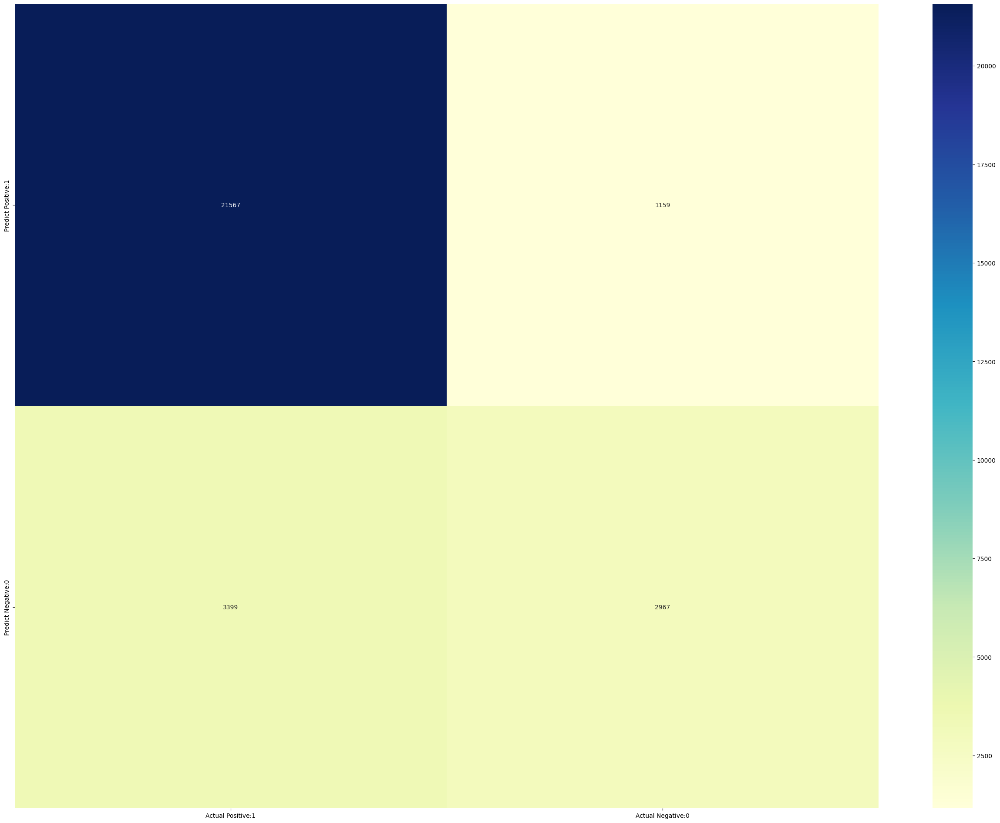

In [147]:
# Print the Confusion Matrix and slice it into four pieces
cm = confusion_matrix(y_test_kbest, y_pred_test_kbest)
print('Confusion matrix\n\n', cm)
print('True Positives(TP) = ', cm[0,0])
print('True Negatives(TN) = ', cm[1,1])
print('False Positives(FP) = ', cm[0,1])
print('False Negatives(FN) = ', cm[1,0])

# visualize confusion matrix with seaborn he[atmap
cm_matrix = pd.DataFrame(data=cm, columns=['Actual Positive:1', 'Actual Negative:0'], 
                                index=['Predict Positive:1', 'Predict Negative:0'])
sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

When evaluating a binary classifier, we need to consider how the model performs in terms of its ability to correctly predict the true class labels of the observations. There are four possible outcomes for a binary classification model: True Positive (TP), True Negative (TN), False Positive (FP), and False Negative (FN).

  TP refers to the situation where the model correctly predicts that a diseased patient is indeed diseased. TN refers to the situation where the model correctly predicts that a healthy patient is indeed healthy. FP refers to the situation where the model predicts that a healthy patient is diseased, and FN refers to the situation where the model predicts that a diseased patient is healthy.

  To evaluate the performance of a binary classifier, we can use a confusion matrix, which summarizes the true and predicted class labels of the observations in a tabular format. From the confusion matrix, we can calculate several performance metrics such as accuracy, precision, recall, and F1 score.

    Accuracy measures the proportion of correctly classified observations out
    of the total number of observations. It is calculated as 
         (TP + TN) / (TP + TN + FP + FN).   
    Precision measures the proportion of correctly predicted positive observations out of 
    the total number of predicted positive observations. It is calculated as  
          TP / (TP + FP). 
    Recall measures the proportion of correctly predicted positive observations out of 
    the total number of true positive observations. It is calculated as 
          TP / (TP + FN).   
    
    F1 score is the harmonic mean of precision and recall and is a useful metric 
    when we want to balance the importance of precision and recall.

  As a data scientist, it is important to understand the trade-offs between these performance metrics and choose the one that best suits the problem at hand. The confusion matrix and performance metrics are essential tools for evaluating binary classifiers and understanding their performance on different types of data.

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


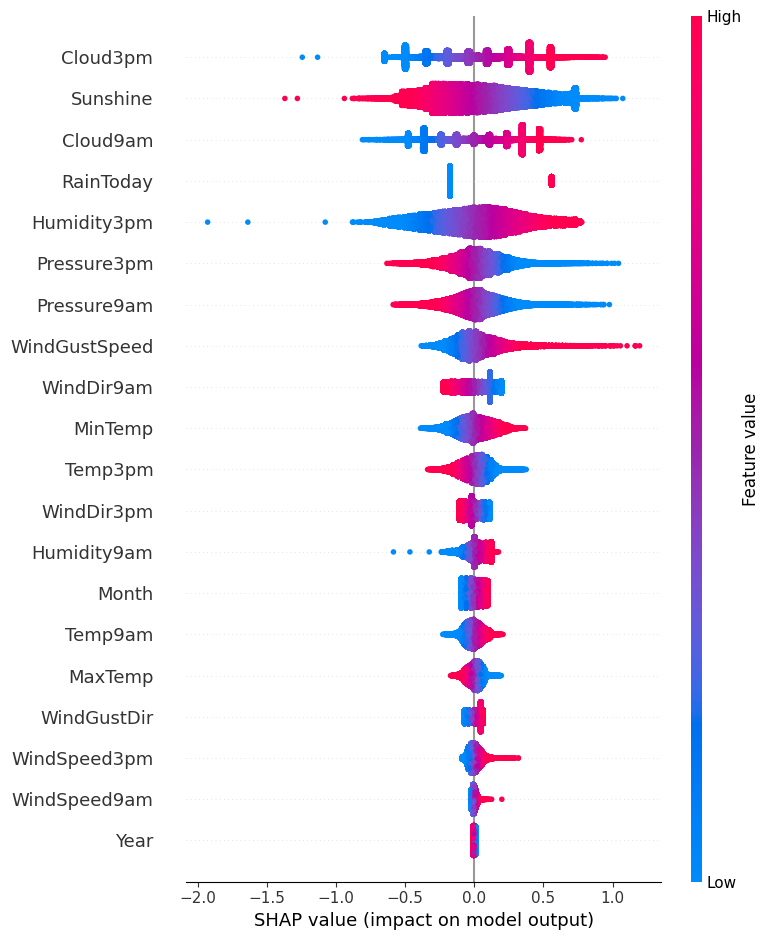

In [148]:
explainer_kbest = shap.LinearExplainer(lr_model_kbest, X_train_kbest[Kbest])
linear_shap_values_kbest = explainer.shap_values(X_train_kbest)

shap.summary_plot(linear_shap_values_kbest, X_train_kbest, feature_names=X_train_kbest.columns)

### LIME explanation of Logistic Regression

LIME (Local Interpretable Model-Agnostic Explanations) is a method for explaining the output of machine learning models by approximating the model locally with a simpler and more interpretable model. In this tutorial, we'll explore some common techniques for LIME analysis and how they work.

LIME analysis has several advantages, including providing a clear and interpretable explanation of the output of machine learning models, enabling the identification of important features and their contribution to the final prediction, and allowing for the detection of biases and errors in the model.

> * One of the main disadvantages of LIME analysis is that it can be computationally expensive and time-consuming, especially for large and complex datasets or models.   
* Additionally, LIME analysis may require careful parameter tuning and validation to achieve optimal performance.

In conclusion, LIME analysis is an important tool for explaining the output of machine learning models and identifying the contribution of each feature to the final prediction. There are several techniques for LIME analysis, including Perturbation-Based LIME, Sampling-Based LIME, and Anchors. Each technique has its advantages and disadvantages, and the choice of method depends on the nature and complexity of the data and the machine learning algorithm used.








In [149]:
lime_linear_explainer = lime_tabular.LimeTabularExplainer(X_train_kbest[Kbest].values[:,:], mode="classification",
                              feature_names = X_train_kbest[Kbest].columns, class_names = y_train.unique(),
                              discretizer='decile', kernel_width=5, discretize_continuous=True,verbose=True)

In [150]:
# Getting LIME interpretation for a sample data
np_x_test = np.zeros(X_train_kbest[Kbest].shape)
np_x_test[:,0:25] = X_train_kbest[Kbest]

np_y_test = np.array(y_pred_test_kbest)

print("Prediction : ", lr_model.predict(X_train_kbest[Kbest]))
print("Actual :     ", y_pred_test_kbest)

Prediction :  [0 0 0 ... 0 0 0]
Actual :      [0 0 0 ... 0 0 0]


In [151]:
lime_linear_explanation = lime_linear_explainer.explain_instance(
    np_x_test[0], lr_model.predict_proba, num_features=24
)
lime_linear_explanation


Intercept 0.21462217182813784
Prediction_local [0.43842477]
Right: 0.4851178251698267


X does not have valid feature names, but LogisticRegression was fitted with feature names


In [152]:
lime_linear_explanation.show_in_notebook()  # Display Results in Notebook

# **Fit a tree-based model and interpret the nodes**

Decision Tree modeling is a popular machine learning technique for solving classification and regression problems. It works by recursively partitioning the dataset into smaller and more homogeneous subsets based on the input features, and then making predictions based on the majority class or the mean value of the target variable in each subset. In this tutorial, we'll explore the statistical modeling behind decision trees and how it works.  
  \
**Statistical modeling behind Decision Trees**  
The statistical modeling behind decision trees is based on the concept of entropy, which measures the impurity or randomness of a set of labels or target variable values. The goal of decision tree modeling is to minimize the entropy of the target variable in each subset by selecting the best feature to split the data. This is done by calculating the information gain or the reduction in entropy achieved by splitting the data based on each feature. The feature that achieves the highest information gain is chosen as the splitting criterion.  
  \

**Building a Decision Tree model**  
To build a decision tree model, we start by selecting the best feature to split the data, based on the information gain. We then split the data into two or more subsets based on the values of the selected feature, and recursively apply the same process to each subset until a stopping criterion is met. The stopping criterion may be based on the depth of the tree, the number of samples in each subset, or the level of entropy reduction achieved by the split.  
  \

**Advantages of Decision Trees**  
One of the main advantages of decision trees is their interpretability, which allows us to understand and visualize the decision-making process behind the model. Decision trees can also handle both categorical and numerical features, and they are robust to outliers and missing values. Additionally, decision trees can handle nonlinear relationships between the input features and the target variable, and they can capture interactions and nonlinearities that may be missed by linear models.  
  \

**Disadvantages of Decision Trees**  
One of the main disadvantages of decision trees is their tendency to overfit the training data, which can lead to poor generalization and performance on new data. To overcome this issue, various techniques such as pruning, ensemble methods, and regularization can be used. Another disadvantage of decision trees is their sensitivity to small changes in the data, which can lead to different trees and predictions. This can be mitigated by using ensemble methods such as random forests or boosting.  
  \

In conclusion, decision tree modeling is a powerful and interpretable machine learning technique that works by recursively partitioning the data into smaller and more homogeneous subsets based on the input features. The statistical modeling behind decision trees is based on the concept of entropy and information gain, and it allows us to handle both categorical and numerical features and capture nonlinearities and interactions. However, decision trees can suffer from overfitting and sensitivity to small changes in the data, which can be addressed using various techniques.

Decision tree models are a type of supervised learning algorithm used for classification and regression tasks. The goal of decision tree modeling is to build a tree-like model of decisions and their possible consequences. In this tutorial, we will discuss the statistical modeling behind decision trees and how they work.  
  

**Splitting Criteria**  
The first step in building a decision tree model is to select the splitting criteria for the tree. The splitting criteria determine how the model decides which feature to split on and where to make the split. The most common splitting criteria are the Gini impurity and the entropy.

The Gini impurity is a measure of how often a randomly chosen element in a set would be incorrectly labeled if it was randomly labeled according to the distribution of labels in the subset. The formula for the Gini impurity is:

> $Gini = \sum_{i=1}^C f_i (1-f_i)$  
  \
where $C$ is the number of classes, and $f_i$ is the proportion of elements in the subset that belong to class $i$.

The entropy is a measure of the amount of information contained in a set of labels. The formula for the entropy is:

> $Entropy = - \sum_{i=1}^C f_i log_2(f_i)$  
  \
where $C$ is the number of classes, and $f_i$ is the proportion of elements in the subset that belong to class $i$.

In general, the Gini impurity and entropy will produce similar results, but there may be cases where one performs better than the other.  
  \
**Tree Building**  
After selecting the splitting criteria, the decision tree model starts with a single node that contains all the observations in the dataset. The model then recursively splits the node into child nodes based on the selected splitting criteria until the stopping criteria are met. The stopping criteria may include a maximum depth for the tree, a minimum number of observations in a leaf node, or a minimum improvement in the splitting criteria.

At each step of the tree building process, the model selects the feature that produces the best split according to the selected splitting criteria. The model then splits the node into child nodes based on the values of the selected feature, and repeats the process for each child node until the stopping criteria are met.  
  \

**Pruning**  
Pruning is a technique used to prevent overfitting in decision tree models. Overfitting occurs when the model fits the training data too closely, resulting in poor performance on new data. Pruning involves removing branches from the tree that do not improve performance on a validation set.  

There are two main types of pruning: pre-pruning and post-pruning. Pre-pruning involves setting the stopping criteria before building the tree, while post-pruning involves removing branches from the tree after it has been built.

## Decision Tree Classifier

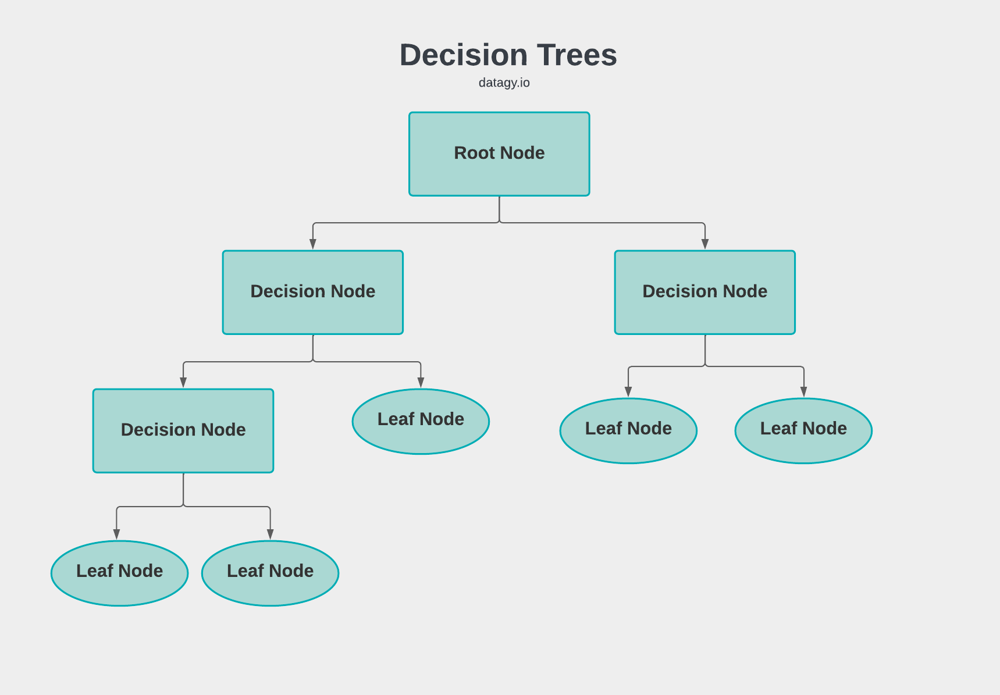

In [153]:
shap_clf = DecisionTreeClassifier(max_depth = 3, random_state = 42)
shap_clf.fit(X_train, y_train)



DecisionTreeClassifier(max_depth=3, random_state=42)

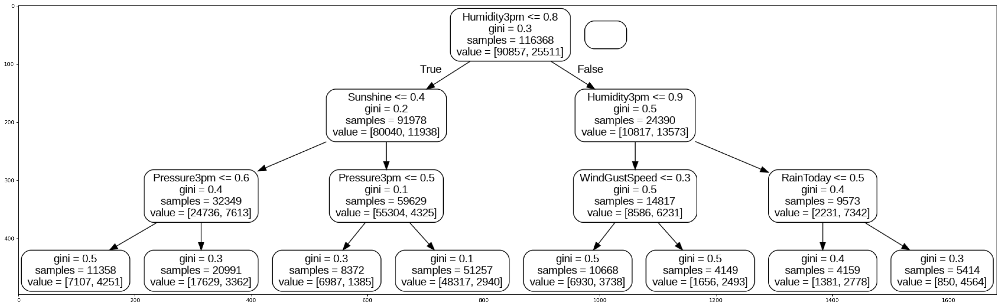

In [154]:
# Visualization of Nodes for the purpose of explainability
figure(figsize=(32, 24), dpi=80)
tree = shap_clf
export_graphviz(
    tree,
    out_file="tree.dot",
    feature_names=X_train.columns,
    rounded=True,
    precision=1,
)
(graph,) = pydot.graph_from_dot_file("tree.dot")
graph.write_png("tree.png")
img = mpimg.imread("tree.png")
imgplot = plt.imshow(img)
plt.show()

In [155]:
clf = DecisionTreeClassifier(max_depth = 10, random_state = 42)
dt_model = clf.fit(X_train, y_train)

In [156]:
y_pred_test = clf.predict(X_test)

In [157]:
metrics.accuracy_score(y_test, y_pred_test)

0.8358655300426234

In [194]:
# Perform 5-fold cross-validation
scores = cross_val_score(clf, X_test, y_test, cv=5)

# Print the cross-validation scores
print("Cross-validation scores: {}".format(scores))
print("Mean cross-validation score: {:.2f}".format(scores.mean()))

Cross-validation scores: [0.82883657 0.82333734 0.82708835 0.82536954 0.82657271]
Mean cross-validation score: 0.83


### SHAP analysis for Decision Tree

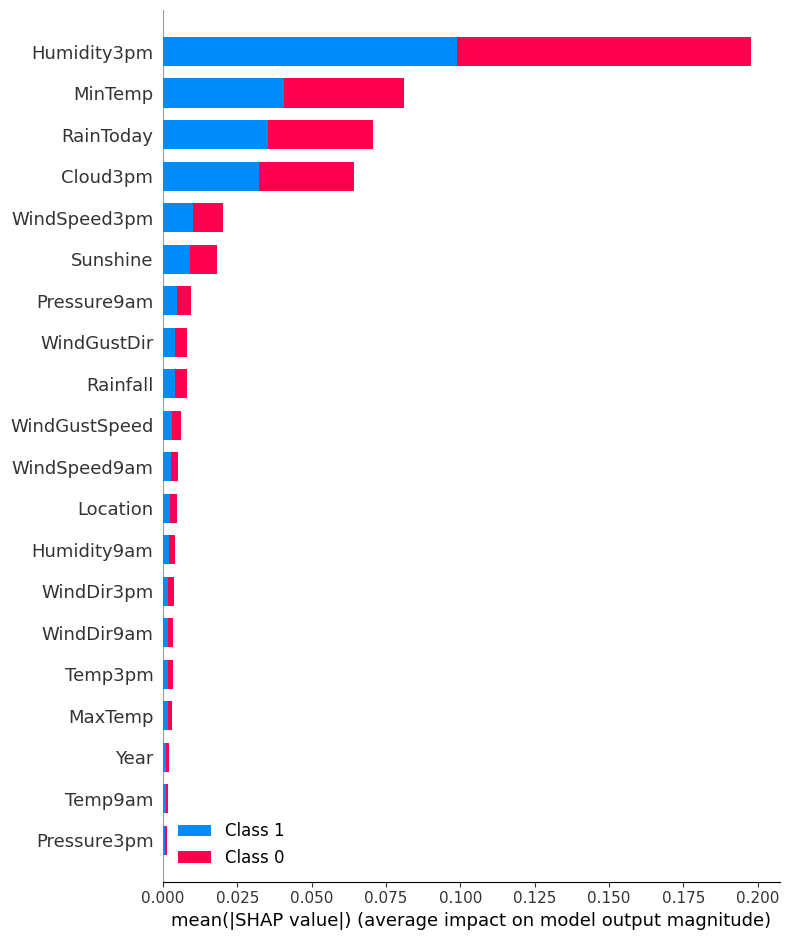

In [158]:
tree_shap_values = shap.TreeExplainer(clf.fit(X_train, y_train)).shap_values(X_train[:1])
shap.summary_plot(tree_shap_values, X_train, feature_names=X_train.columns)

Shap plot for decision trees are 2 dimensional, and this cannot be represented by beeswarm, however the plot gives information of impact based on each class of target value. Based on decision tree, Humidity3pm, MinTemp, RainToday and CLoud3pm had high impact on both classes of target value. 

### Decision Tree modeling using Kbest features

In [159]:
clf = DecisionTreeClassifier(max_depth = 10, random_state = 42)
dt_model = clf.fit(X_train_kbest[Kbest], y_train_kbest)

In [160]:
y_pred_test_kbest = clf.predict(X_test_kbest[Kbest])

In [161]:
metrics.accuracy_score(y_test, y_pred_test_kbest)

0.8365186305513543

### LIME explanation of Decision Tree Classifier

In [162]:
decision_tree_explanation = lime_linear_explainer.explain_instance(
    np_x_test[0], dt_model.predict_proba, num_features=24
)
decision_tree_explanation

Intercept 0.19552260401625887
Prediction_local [0.48677052]
Right: 0.9032258064516129


X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


In [163]:
decision_tree_explanation.show_in_notebook()  # Display Results in Notebook

# **Ensemble Model** 
  \
Ensemble modeling is a technique in which multiple models are combined to improve the accuracy and robustness of predictions. Ensemble methods can be applied to both classification and regression problems, and they typically involve combining different models or training data sets to create a more accurate predictor.  
  \

**Types of Ensemble Methods**  
There are several types of ensemble methods, including:  
  \

**Bagging (Bootstrap Aggregating)**:  
This method involves training multiple instances of the same model on different random subsets of the training data, and then averaging the predictions. Bagging is useful when the underlying model is unstable or prone to overfitting.

**Boosting**:   
This method involves training a sequence of weak models, where each model is trained to correct the errors of the previous model. Boosting is useful when the underlying model is biased or underfitting.

**Stacking**:  
This method involves training multiple models on the same data set, and then combining their predictions using a meta-model. Stacking is useful when the underlying models have different strengths and weaknesses.

**Random Forests**:  
This method is a combination of bagging and decision trees. Random forests involve training multiple decision trees on different random subsets of the training data, and then averaging the predictions. Random forests are useful when the underlying model is prone to overfitting or is highly variable.  
  \

**Evaluation of Ensemble Methods**  
  \
The evaluation of ensemble methods can be done using several metrics, including:

**Accuracy**: The proportion of correctly classified instances in the test set.

**Precision**: The proportion of correctly predicted positive instances out of all predicted positive instances.

**Recall**: The proportion of correctly predicted positive instances out of all actual positive instances.

**F1-score**: A weighted average of precision and recall.

**ROC curve**: A graphical representation of the tradeoff between true positive rate and false positive rate for different classification thresholds.

**AUC**: The area under the ROC curve, which provides a measure of the overall performance of the classifier.  
  \

**Advantages and Disadvantages of Ensemble Methods**  
  \
Ensemble methods have several advantages, including:

**Improved Accuracy**: Ensemble methods can often achieve higher accuracy than individual models.

**Reduced Overfitting**: Ensemble methods can reduce the risk of overfitting by combining multiple models.

**Robustness**: Ensemble methods can be more robust to outliers or noisy data.

However, ensemble methods also have some disadvantages, including:

**Increased Complexity**: Ensemble methods can be more complex and difficult to implement than individual models.

**Increased Computation Time**: Ensemble methods can require more computation time than individual models.

**Difficulty in Interpretation**: Ensemble methods can be more difficult to interpret than individual models, particularly when multiple models are combined.

Overall, ensemble methods are a powerful technique in statistical modeling, and they can be particularly useful in situations where individual models are prone to overfitting or underfitting. However, they also require careful evaluation and tuning to ensure that they are effective and robust.

## Random Forest Classifier with Selected Features

In [164]:
# Initializing Random Forest Classifier
RandForest_RFE = RandomForestClassifier() 
# Initializing the RFE object, one of the most important arguments is the estimator, in this case is RandomForest
rfe = RFE(estimator=RandForest_RFE, n_features_to_select=10, step=5)
# Fit the origial dataset
rfe = rfe.fit(X_train, y_train)

In [165]:
rfe.get_feature_names_out()

array(['Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed',
       'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm',
       'Cloud9am', 'Cloud3pm'], dtype=object)

In [166]:
# Generating x_train and x_test based on the best features given by RFE
X_train_RFE = rfe.transform(X_train)
X_test_RFE = rfe.transform(X_test)

rfc_model = RandomForestClassifier(max_depth=3, n_estimators=100)
rfc_model.fit(X_train_RFE, y_train)

RandomForestClassifier(max_depth=3)

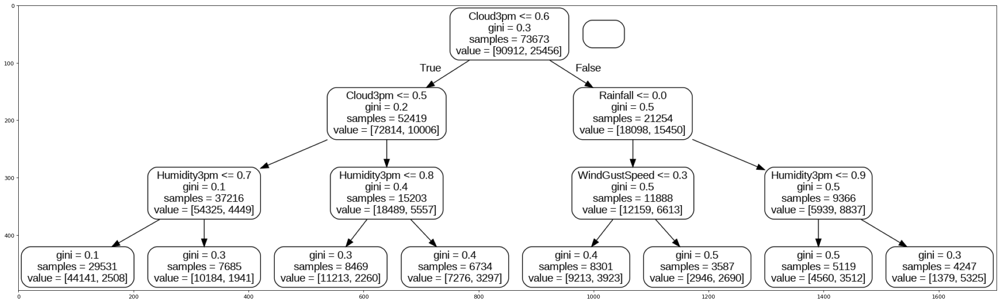

In [167]:
# Visualization of Nodes for the purpose of explainability
figure(figsize=(32, 24), dpi=80)
tree = rfc_model.estimators_[0]
export_graphviz(
    tree,
    out_file="tree.dot",
    feature_names=list(rfe.get_feature_names_out()),
    rounded=True,
    precision=1,
)
(graph,) = pydot.graph_from_dot_file("tree.dot")
graph.write_png("tree.png")
img = mpimg.imread("tree.png")
imgplot = plt.imshow(img)
plt.show()

We can observe from the tree node, we can observe branching based on lower Gini impurity.

Accuracy:  0.8318781795682662
Mean squared error: 0.17
Confusion matrix

 [[22039   687]
 [ 4204  2162]]
True Positives(TP) =  22039
True Negatives(TN) =  2162
False Positives(FP) =  687
False Negatives(FN) =  4204
Classification accuracy : 0.8319
Classification error : 0.1681


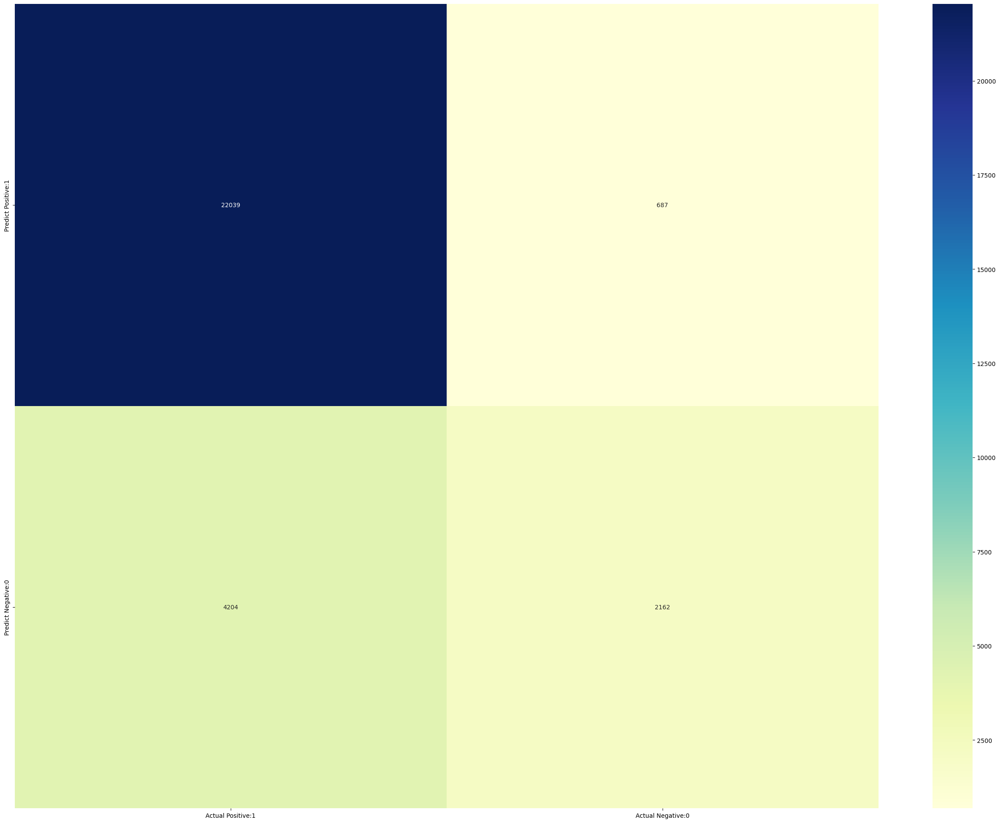

In [168]:
# Making a prediction and calculting the accuracy
y_pred = rfc_model.predict(X_test_RFE)
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy: ',accuracy)
print('Mean squared error: %.2f'% mean_squared_error(y_test, y_pred))

# Print the Confusion Matrix and slice it into four pieces
cm = confusion_matrix(y_test, y_pred)
print('Confusion matrix\n\n', cm)
print('True Positives(TP) = ', cm[0,0])
print('True Negatives(TN) = ', cm[1,1])
print('False Positives(FP) = ', cm[0,1])
print('False Negatives(FN) = ', cm[1,0])

# visualize confusion matrix with seaborn he[atmap
cm_matrix = pd.DataFrame(data=cm, columns=['Actual Positive:1', 'Actual Negative:0'], 
                                index=['Predict Positive:1', 'Predict Negative:0'])
sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')



# print classification accuracy
classification_accuracy = (cm[0,0] + cm[1,1]) / float(cm[0,0] + cm[1,1] + cm[0,1] + cm[1,0])
print('Classification accuracy : {0:0.4f}'.format(classification_accuracy))

# print classification error
classification_error = (cm[0,1] + cm[1,0]) / float(cm[0,0] + cm[1,1] + cm[0,1] + cm[1,0])
print('Classification error : {0:0.4f}'.format(classification_error))


### SHAP Analysis for ensemble model

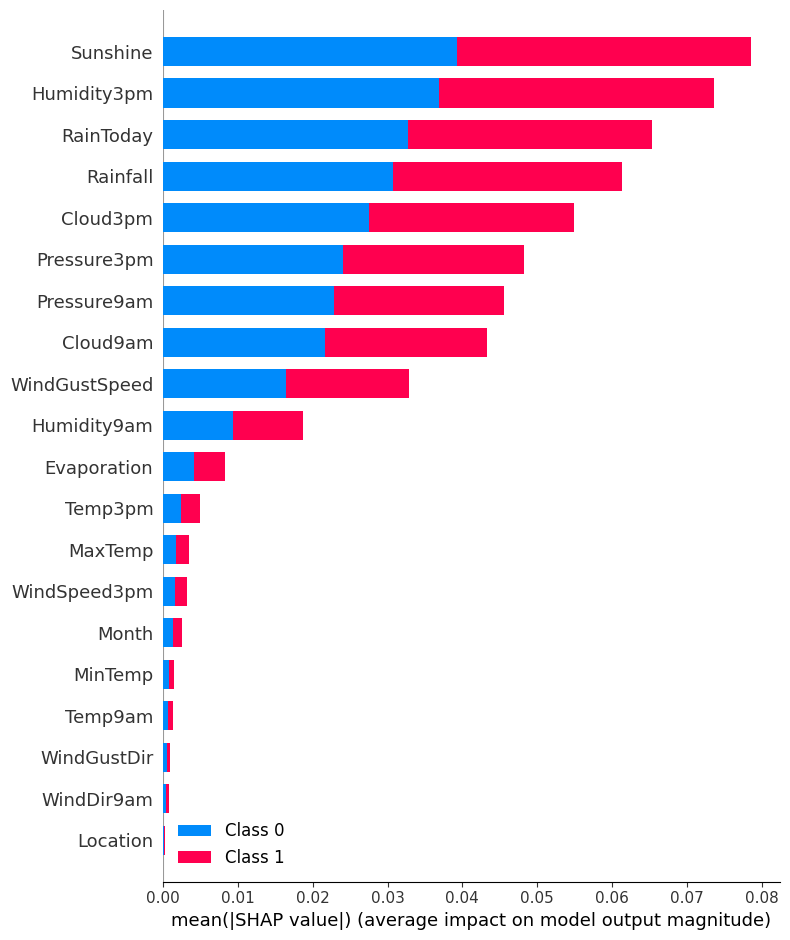

In [169]:
tree_shap_values = shap.TreeExplainer(rfc_model.fit(X_test, y_test)).shap_values(X_test[:1])
shap.summary_plot(tree_shap_values, X_test, feature_names=X_test.columns)

We can observe Sunshine, Humidity3pm, WindGustSpeed have the most positive impact on target variable, similar to the linear model.

# **Use AutoML to find the best model**



AutoML (Automated Machine Learning) is a process that automates the entire machine learning process, from data preparation and feature engineering to model selection and hyperparameter tuning. In this tutorial, we'll explore some common techniques for AutoML and how they work.  
  \
**H2O AutoML**  
H2O AutoML is a popular open-source AutoML framework that automates the machine learning process with minimal user intervention. It works by automatically exploring a range of algorithms and hyperparameters to identify the best model for the given dataset. H2O AutoML also provides built-in feature engineering and data preprocessing capabilities to improve the quality of the input data.  
  \

**Automated Feature Engineering**  
Automated Feature Engineering is a process that automatically generates new features from existing data to improve the performance of machine learning models. It works by using various techniques, such as feature selection, feature extraction, and feature transformation, to identify the most informative features for the given dataset. Automated Feature Engineering can significantly reduce the time and effort required for manual feature engineering and improve the accuracy of machine learning models.  
  \

**Automated Hyperparameter Tuning**  
Automated Hyperparameter Tuning is a process that automatically tunes the hyperparameters of machine learning models to achieve optimal performance. It works by exploring a range of hyperparameter values and selecting the values that result in the best performance for the given dataset. Automated Hyperparameter Tuning can significantly improve the accuracy and generalization of machine learning models and reduce the risk of overfitting.  
  \

**Advantages of AutoML**  
AutoML has several advantages, including reducing the time and effort required for manual machine learning tasks, improving the accuracy and generalization of machine learning models, and enabling non-experts to perform machine learning tasks without specialized knowledge. Additionally, AutoML frameworks, such as H2O AutoML, provide built-in capabilities for data preprocessing, feature engineering, and hyperparameter tuning, further simplifying the machine learning process.  
  \

**Disadvantages of AutoML**  
One of the main disadvantages of AutoML is the lack of control over the machine learning process, which can result in suboptimal performance or unexpected results. Additionally, AutoML frameworks may require significant computational resources and specialized hardware to achieve optimal performance.  
  \

In conclusion, AutoML is an important tool for automating the machine learning process and improving the accuracy and generalization of machine learning models. There are several techniques for AutoML, including H2O AutoML, Automated Feature Engineering, and Automated Hyperparameter Tuning. Each technique has its advantages and disadvantages, and the choice of method depends on the nature and complexity of the data and the machine learning task.

In [170]:
try:
  h2o.init(strict_version_check=False,min_mem_size_GB=min_mem_size,port=port_no) # start h2o
except:
  logging.critical('h2o.init')
  h2o.download_all_logs(dirname=logs_path, filename=logfile)      
  h2o.cluster().shutdown()
  sys.exit(2)

Checking whether there is an H2O instance running at http://localhost:15539..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.18" 2023-01-17; OpenJDK Runtime Environment (build 11.0.18+10-post-Ubuntu-0ubuntu120.04.1); OpenJDK 64-Bit Server VM (build 11.0.18+10-post-Ubuntu-0ubuntu120.04.1, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.9/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmp1axcp2nk
  JVM stdout: /tmp/tmp1axcp2nk/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmp1axcp2nk/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:15539
Connecting to H2O server at http://127.0.0.1:15539 ... successful.


H2O_cluster_uptime:,03 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.40.0.3
H2O_cluster_version_age:,19 days
H2O_cluster_name:,H2O_from_python_unknownUser_tyz0hy
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.172 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


In [171]:
#h2o_data = h2o.import_file(path = local_path)
h2o_data = h2o.H2OFrame(scaled_data)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [172]:
h2o_data['RainTomorrow'] = h2o_data['RainTomorrow'].asfactor()

In [173]:
h2o_data_train, h2o_data_test = h2o_data.split_frame([0.8])

In [174]:
aml = H2OAutoML(sort_metric = 'AUC', nfolds=5, max_runtime_secs=360)

In [175]:
#Display all columns in X
X=h2o_data_train.columns
print(X)

['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'RainToday', 'RainTomorrow', 'Year', 'Month', 'Day']


In [176]:
#Seperate Dependent variable from Independent variable
y_cat ='RainTomorrow'
X.remove(y_cat) 
print(X)

['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'RainToday', 'Year', 'Month', 'Day']


In [177]:
aml.train(x=X,y=y_cat,training_frame=h2o_data_train) 

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


key,value
Stacking strategy,cross_validation
Number of base models (used / total),8/8
# GBM base models (used / total),4/4
# XGBoost base models (used / total),2/2
# GLM base models (used / total),1/1
# DRF base models (used / total),1/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5
Metalearner fold_column,None


In [178]:
explain_model = aml.explain(frame = h2o_data_test, figsize = (8,6),include_explanations=['leaderboard'])

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_BestOfFamily_1_AutoML_1_20230423_192655,0.885383,0.333683,0.726773,0.209601,0.322448,0.103973,5041,0.018351,StackedEnsemble
StackedEnsemble_BestOfFamily_2_AutoML_1_20230423_192655,0.885182,0.333757,0.726373,0.209186,0.322469,0.103986,3776,0.022628,StackedEnsemble
GBM_1_AutoML_1_20230423_192655,0.882471,0.341595,0.720393,0.212722,0.325205,0.105758,10939,0.010998,GBM
StackedEnsemble_AllModels_1_AutoML_1_20230423_192655,0.881056,0.355606,0.718222,0.218733,0.329793,0.108763,5454,0.028827,StackedEnsemble
XGBoost_1_AutoML_1_20230423_192655,0.879729,0.342486,0.714405,0.216171,0.326614,0.106677,16632,0.009358,XGBoost
GLM_1_AutoML_1_20230423_192655,0.862473,0.361763,0.673872,0.231231,0.336521,0.113246,8121,0.002474,GLM
XGBoost_2_AutoML_1_20230423_192655,0.861969,0.405318,0.684334,0.232623,0.349371,0.12206,1585,0.004573,XGBoost
GBM_3_AutoML_1_20230423_192655,0.860495,0.455089,0.683397,0.230961,0.380355,0.14467,752,0.004841,GBM
GBM_2_AutoML_1_20230423_192655,0.852968,0.476893,0.666935,0.241129,0.391523,0.15329,1923,0.002312,GBM
GBM_4_AutoML_1_20230423_192655,0.849076,0.47432,0.651743,0.245547,0.390195,0.152252,684,0.004498,GBM


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

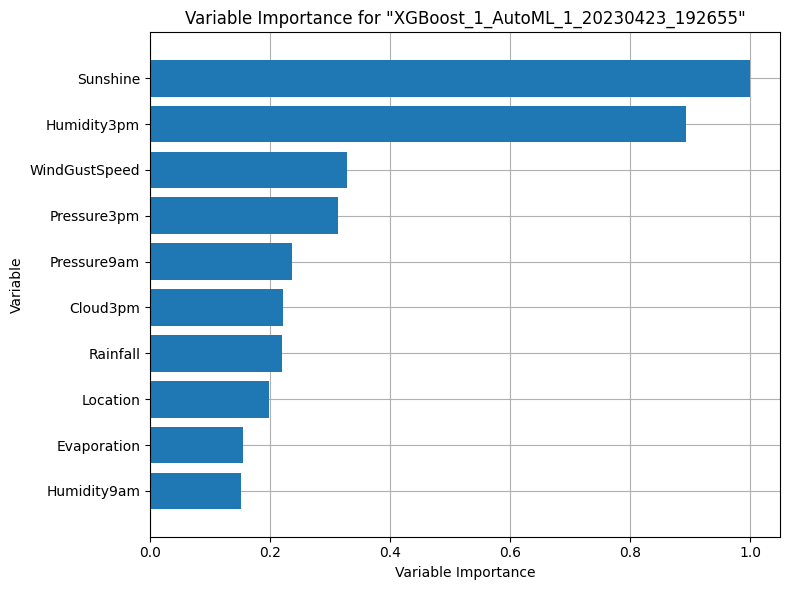

In [179]:
explain_model = aml.explain(frame = h2o_data_test, figsize = (8,6),include_explanations=['varimp'])

## SHAP Analysis for AUTOML

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

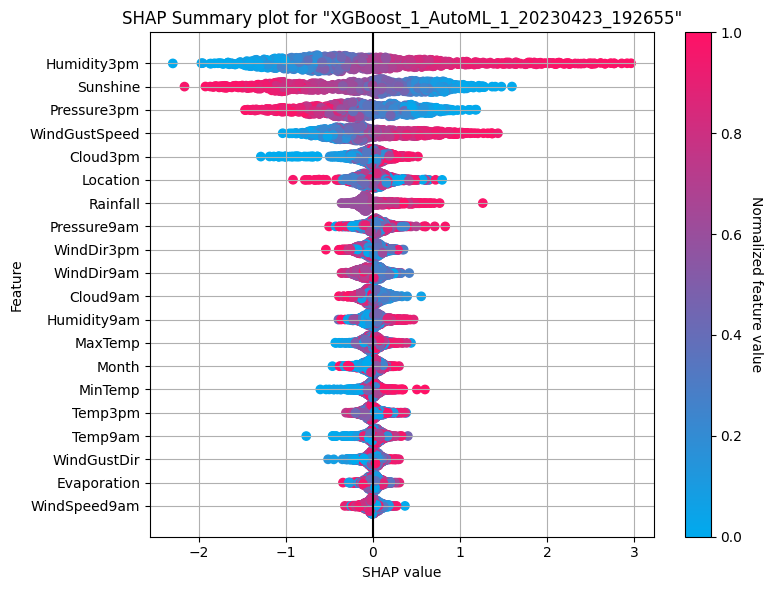

In [180]:
explain_model = aml.explain(frame = h2o_data_test, figsize = (8,6),include_explanations=['shap_summary'])

## LIME explanation for AUTOML model

In [181]:
class h2o_predict_proba_wrapper:
    # h2o object, the column_names is the labels of the X values
    def __init__(self,model,column_names):            
        self.model = model
        self.column_names = column_names

    def predict_proba(self,this_array):        
        # If we have just 1 row of data we need to reshape it
        shape_tuple = np.shape(this_array)        
        if len(shape_tuple) == 1:
            this_array = this_array.reshape(1, -1)

       # convert the pandas dataframe to an h2o frame
        self.pandas_df = pd.DataFrame(data = this_array,columns = self.column_names)
        self.h2o_df = h2o.H2OFrame(self.pandas_df)

        # Predict with the h2o model
        self.predictions = self.model.predict(self.h2o_df).as_data_frame()
        # the first column is the class labels, the rest are probabilities for each class
        self.predictions = self.predictions.iloc[:,1:].values
        return self.predictions

In [182]:
h2o_df = h2o_data_test[X].as_data_frame().values
#np_aml_test = np.zeros(h2o_df.shape)
#np_aml_test[:,0:25] = h2o_df

In [183]:
classes = h2o_data_train[y_cat].unique().as_data_frame().values


In [184]:
h2o_drf_wrapper = h2o_predict_proba_wrapper(aml.leader,h2o_data_test)
explainer = lime_tabular.LimeTabularExplainer(h2o_data_train[X].as_data_frame().values, mode="classification",
                              feature_names = X, class_names = classes,
                              verbose=True)

'''
lime_linear_explainer = lime_tabular.LimeTabularExplainer(X_train.values[:,:], mode="classification",
                              feature_names = X_train.columns, class_names = y_train.unique(),
                              discretizer='decile', kernel_width=5, discretize_continuous=True,verbose=True)
                              '''

'\nlime_linear_explainer = lime_tabular.LimeTabularExplainer(X_train.values[:,:], mode="classification",\n                              feature_names = X_train.columns, class_names = y_train.unique(),\n                              discretizer=\'decile\', kernel_width=5, discretize_continuous=True,verbose=True)\n                              '

In [185]:
h2o_drf_wrapper = h2o_predict_proba_wrapper(aml.leader,X)

h2o_explanation = explainer.explain_instance(
    h2o_df[24], h2o_drf_wrapper.predict_proba, num_features=24
)
h2o_explanation

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%
Intercept 0.4316047444624097
Prediction_local [-0.00176641]
Right: 0.0468532605665391


In [186]:
h2o_explanation.show_in_notebook()  # Display Results in Notebook

LIME analysis gives us the prediction probability for each class, and each feature's impact on target variable. However, it is not as detailed in terms of the predictor variable values. It is similar to SHAP but not as detailed.

AutoML was able to find the best model, with Humidity3pm having the most impact unlike linear model, still Humidity3pm, WindGustSpeed, Cloud3pm come at the top with positive impact, while low Sunshine, Pressure3pm show impact as well.

# **Other Model Interpretabiity methods**

Model Interpretability is the ability to explain how a machine learning model makes predictions or decisions. It is an important aspect of machine learning because it helps us understand the reasoning behind a model's outputs, and it can also help us identify potential biases or errors in the model.

**Why is Model Interpretability important?**  
Model Interpretability is important for several reasons. Firstly, it helps build trust in the model's predictions or decisions. If we can understand how the model arrived at its outputs, we can be more confident in its accuracy and reliability. Secondly, it can help us identify potential biases or errors in the model. If we know how the model is making its decisions, we can identify instances where it may be making incorrect assumptions or using flawed reasoning.

**Methods for Model Interpretability**  
There are several methods for achieving Model Interpretability:

> *Feature Importance*  
Feature Importance is a method for determining which input variables are most important in making a prediction or decision. This can be achieved using techniques such as permutation importance or SHAP values.

> *Partial Dependence Plots (PDPs)*  
Partial Dependence Plots are a way of visualizing the relationship between an input variable and the output of a model while controlling for other input variables. PDPs can be used to identify nonlinear relationships between input and output variables and to understand the overall behavior of the model.

> *Individual Conditional Expectation (ICE) Plots*  
Individual Conditional Expectation (ICE) Plots are similar to PDPs, but instead of visualizing the relationship between a single input variable and the output of a model, they visualize the relationship between a single input variable and the output of the model for each individual data point.

> *Local Interpretable Model-Agnostic Explanations (LIME)*  
LIME is a method for explaining the predictions of any machine learning model. It works by approximating the model's behavior locally using a simple, interpretable model, and then using that model to explain the prediction for a given instance.

> *Model-Specific Interpretability Techniques*  
Many machine learning models have their own specific interpretability techniques. For example, decision trees can be visualized as a series of if-then statements, making it easy to understand how the model is making decisions.

## Partial Dependance Plots

Partial Dependence Plots (PDPs) are a useful tool for visualizing the relationship between a set of input variables and the output of a machine learning model. In this tutorial, we'll explore what PDPs are and how they work.  
  \

**What are Partial Dependence Plots?**  
Partial Dependence Plots (PDPs) are plots that show the relationship between a target variable and a set of input variables while holding all other variables constant. They are particularly useful for visualizing the marginal effect of a single input variable on the target variable while controlling for the effect of all other input variables.  
  \

**How do Partial Dependence Plots work?**  
To create a Partial Dependence Plot, we first train a machine learning model on a dataset. We then select an input variable of interest and vary its values over a predefined range. For each value of the input variable, we use the trained model to make a prediction and average the predictions across all instances in the dataset. This process produces a curve that shows the relationship between the input variable and the predicted output, while holding all other variables constant.  
  \

**Interpreting Partial Dependence Plots**  
Partial Dependence Plots can provide valuable insights into the relationship between input variables and the output of a machine learning model. They can help identify non-linear relationships and interactions between input variables that may be difficult to detect using other methods. Additionally, PDPs can be used to identify important input variables that have a significant effect on the output of the model.  
  \

**Limitations of Partial Dependence Plots**  
Partial Dependence Plots have some limitations. They assume that the relationship between the input variable and the target variable is additive, which may not always be the case. Additionally, PDPs do not capture the interaction between multiple input variables, which can be important in some cases. Finally, PDPs can be computationally expensive to generate, especially for high-dimensional datasets.  
  \


Partial Dependence Plots are a powerful tool for understanding the relationship between input variables and the output of a machine learning model. They provide a simple and intuitive way to visualize the marginal effect of a single input variable on the target variable while controlling for the effect of all other input variables. While PDPs have some limitations, they can provide valuable insights into the behavior of machine learning models and help identify important input variables.  
  \

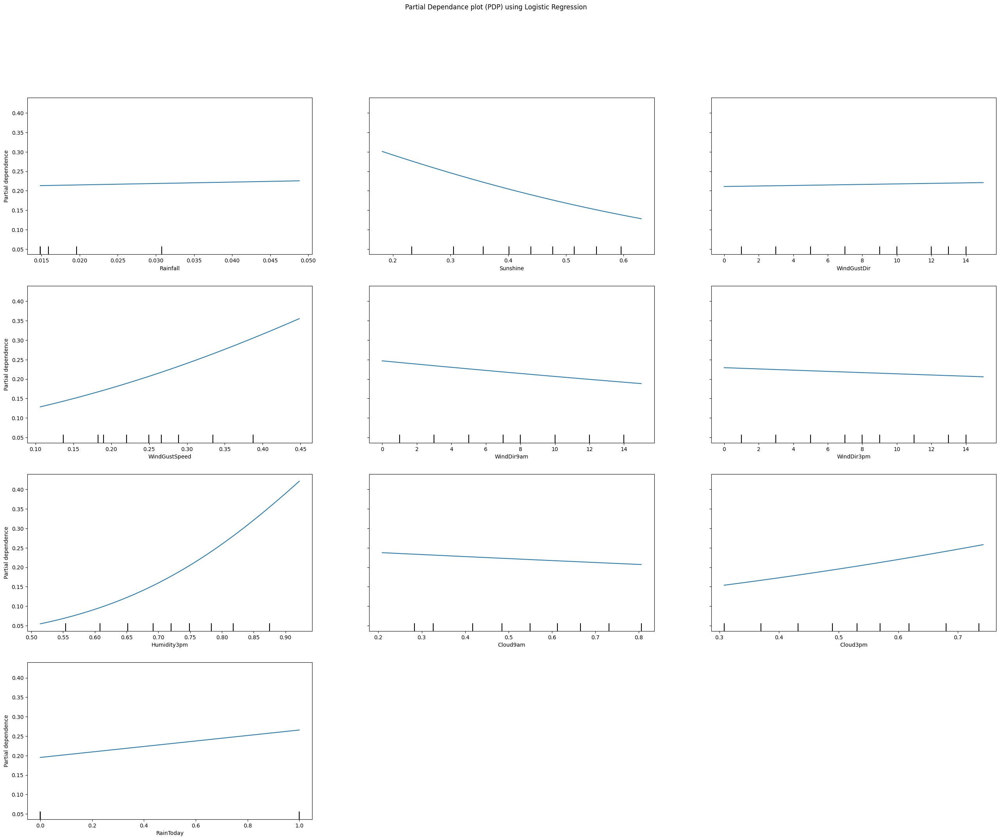

In [187]:
from sklearn.inspection import PartialDependenceDisplay

PartialDependenceDisplay.from_estimator(lr_model, X_test_kbest[Kbest], X_test[Kbest].columns)

fig = plt.gcf()
fig.suptitle("Partial Dependance plot (PDP) using Logistic Regression")
plt.rcParams["figure.figsize"] = (32, 24)
plt.show()

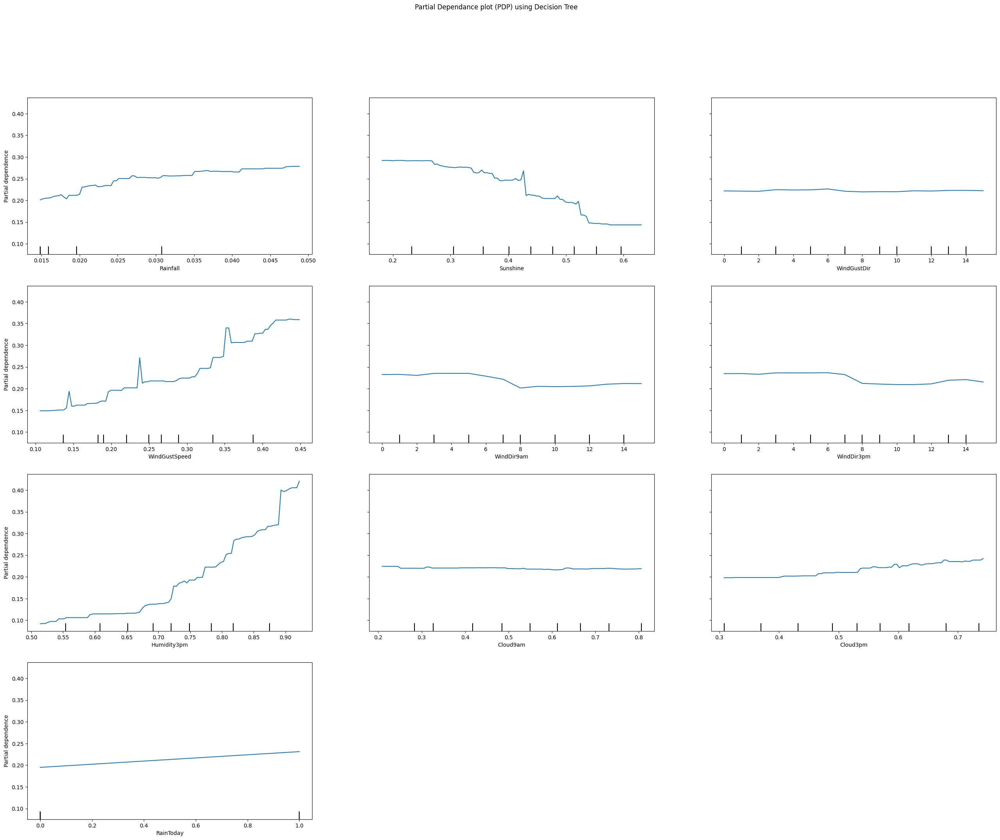

In [188]:
PartialDependenceDisplay.from_estimator(dt_model, X_test_kbest[Kbest], X_test_kbest[Kbest].columns)
fig = plt.gcf()
fig.suptitle("Partial Dependance plot (PDP) using Decision Tree")
plt.rcParams["figure.figsize"] = (32, 24)
plt.show()

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.


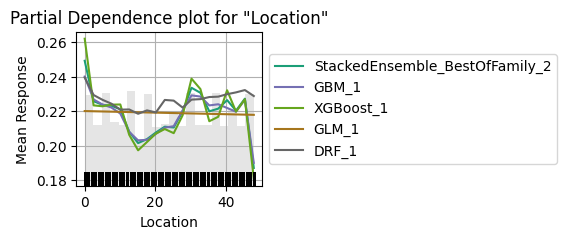

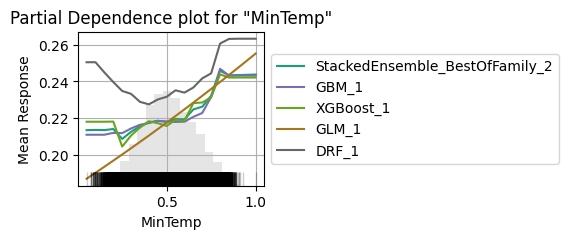

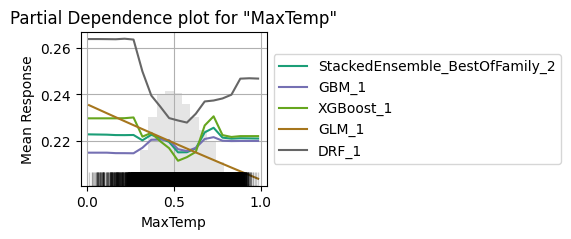

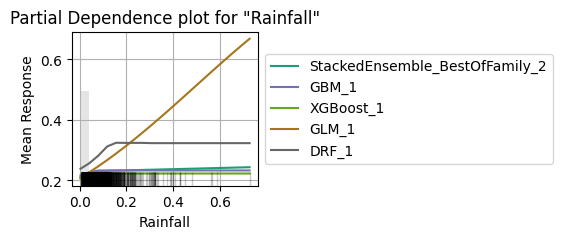

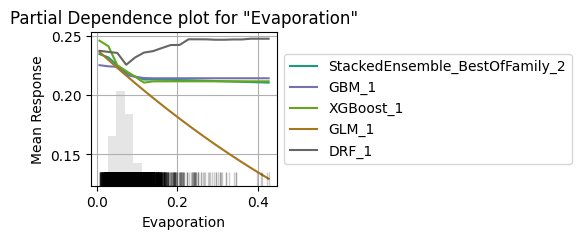

...

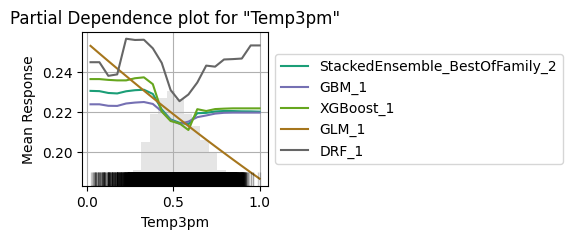

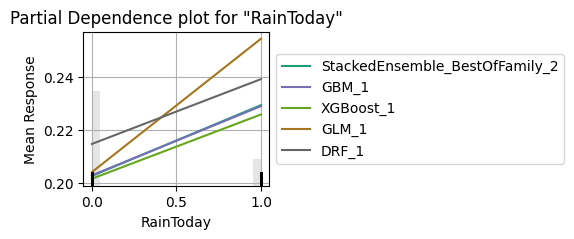

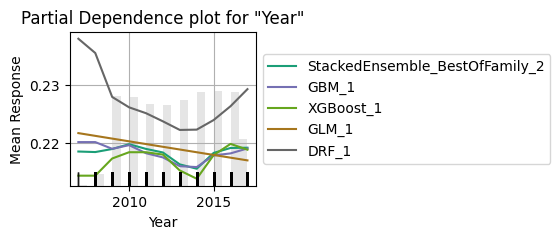

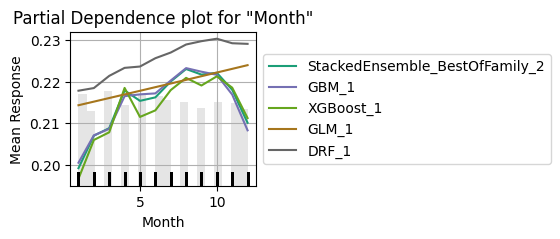

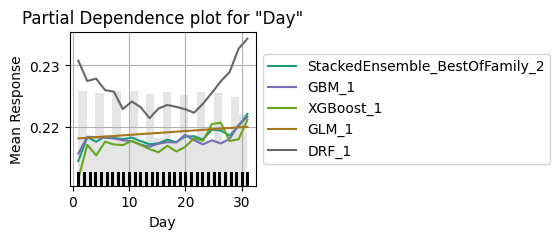

In [93]:
explain_model = aml.explain(frame = h2o_data_test, figsize = (3,2),include_explanations=['pdp'] )

PDP plots show the variance of target variable on a predictor variable as per each model run in automl. 

## Individual conditional expectation (ICE) plot

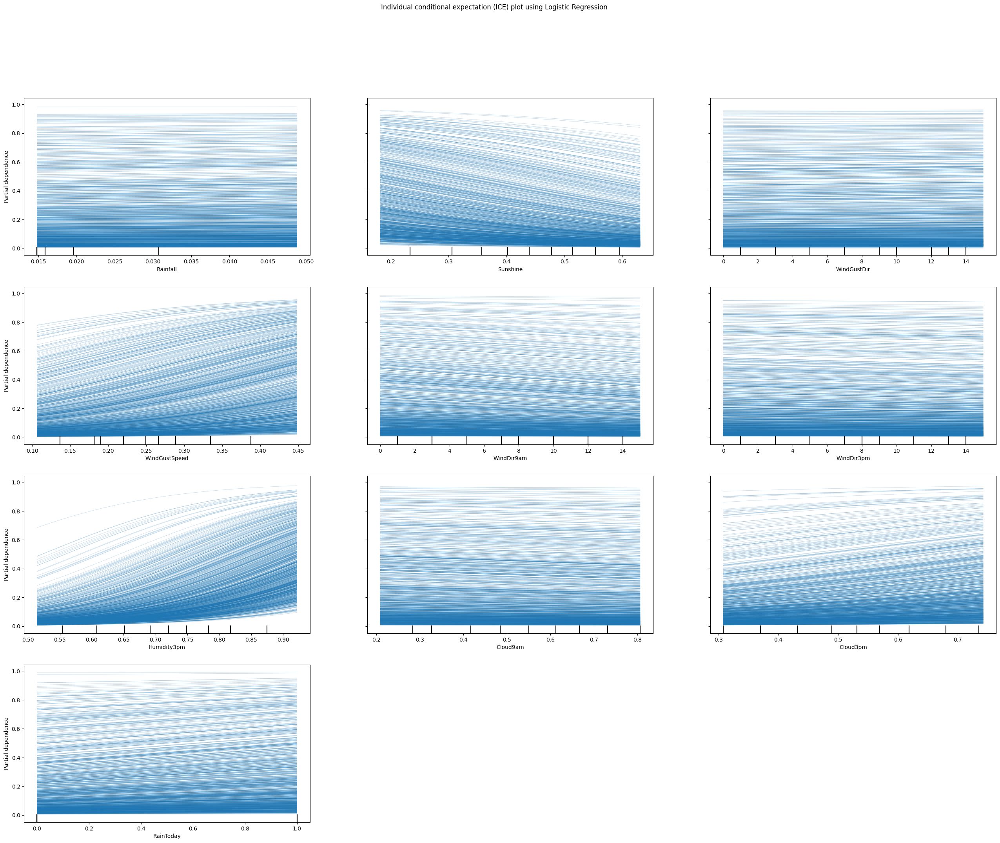

In [94]:
PartialDependenceDisplay.from_estimator(lr_model, X_test_kbest[Kbest], X_test_kbest[Kbest].columns,kind='individual')

fig = plt.gcf()
fig.suptitle("Individual conditional expectation (ICE) plot using Logistic Regression")
plt.rcParams["figure.figsize"] = (32, 24)
plt.show()

In [ ]:
PartialDependenceDisplay.from_estimator(dt_model, X_test_kbest[Kbest], X_test_kbest[Kbest].columns, kind='individual')

fig = plt.gcf()
fig.suptitle("Individual conditional expectation (ICE) plot using Decision Tree")
plt.rcParams["figure.figsize"] = (32, 24)
plt.show()


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.


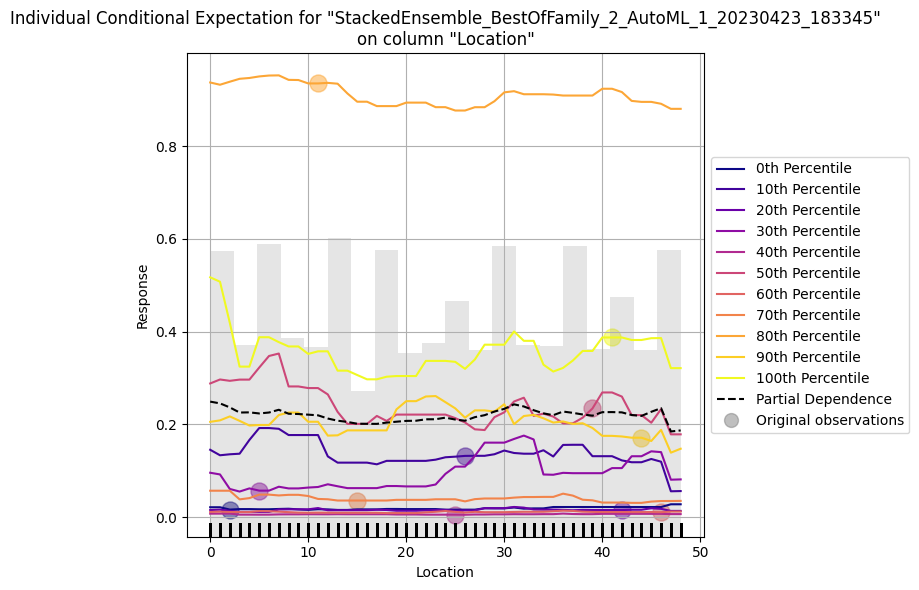

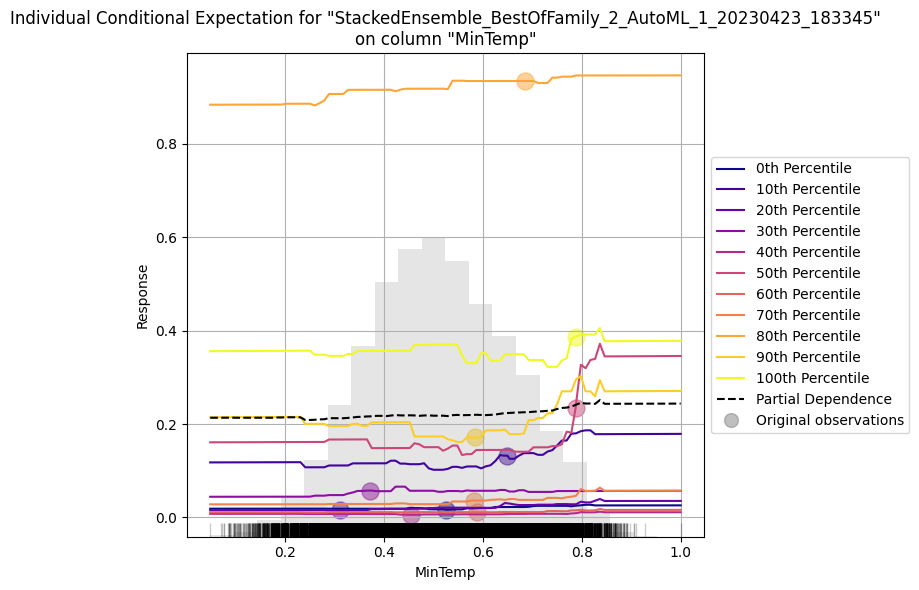

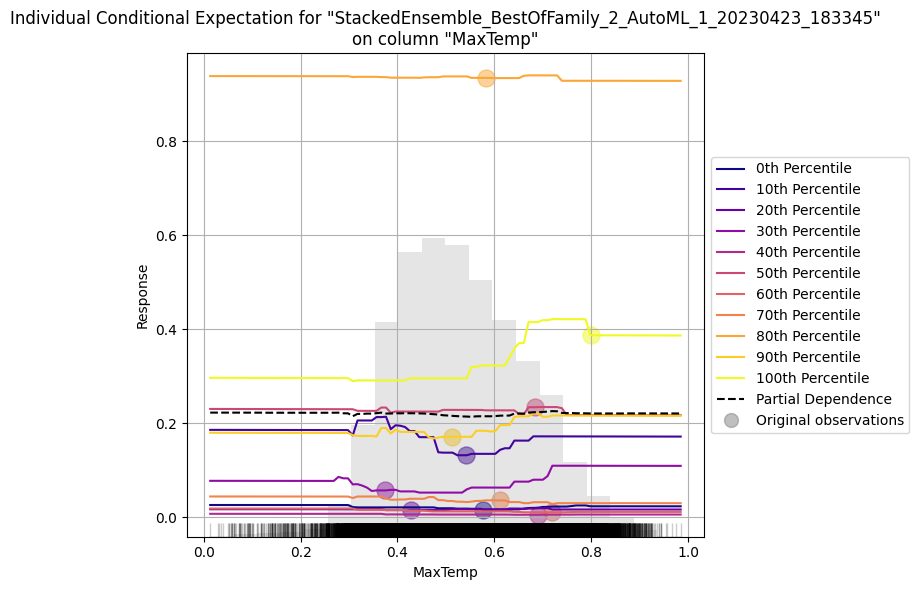

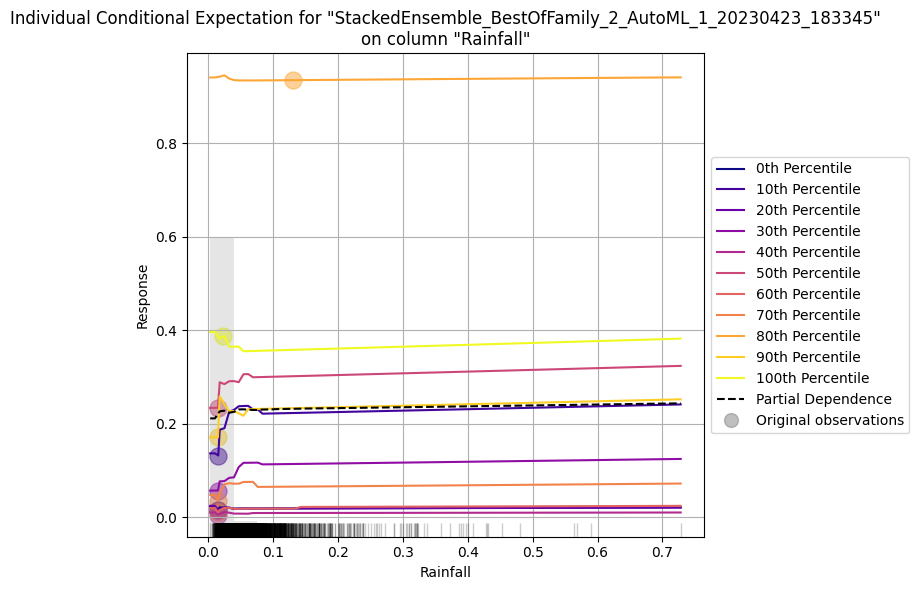

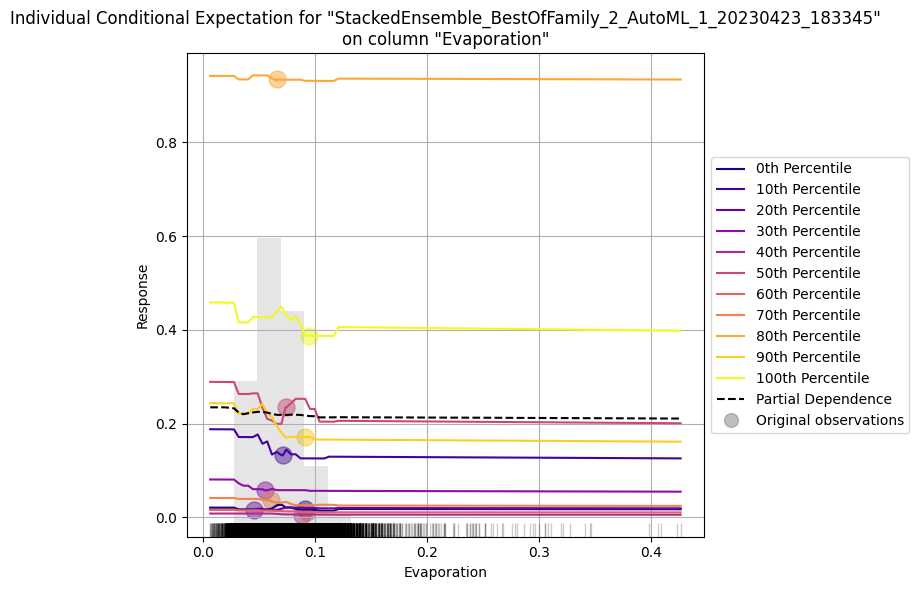

...

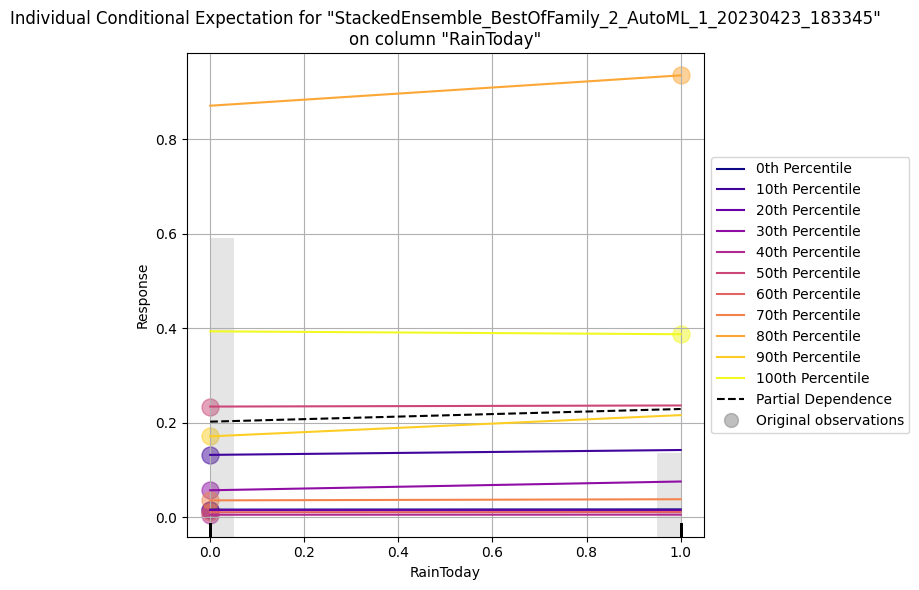

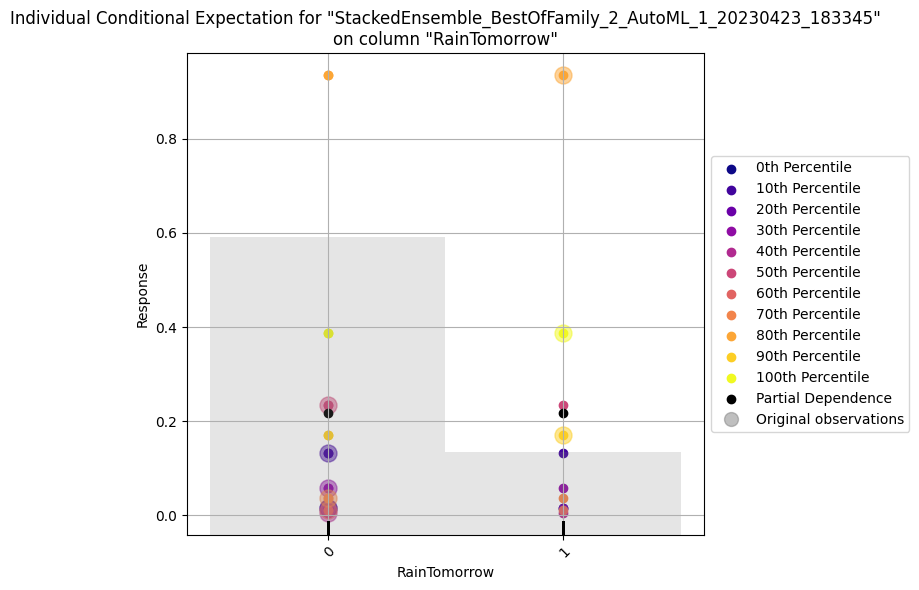

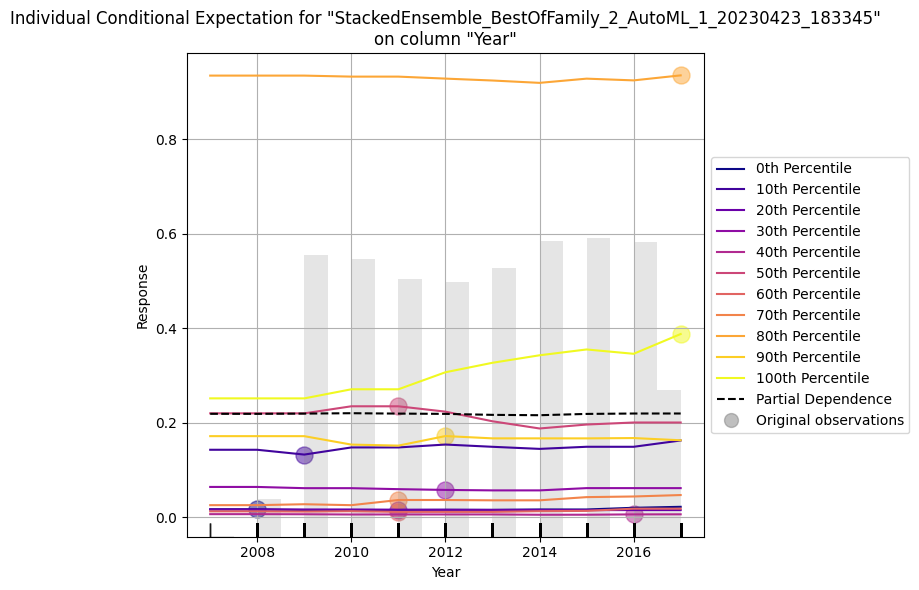

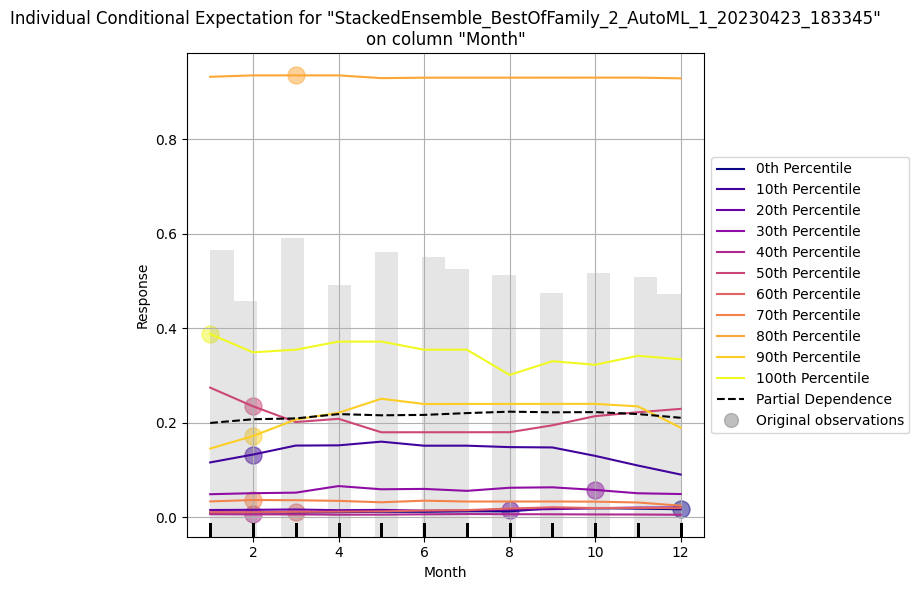

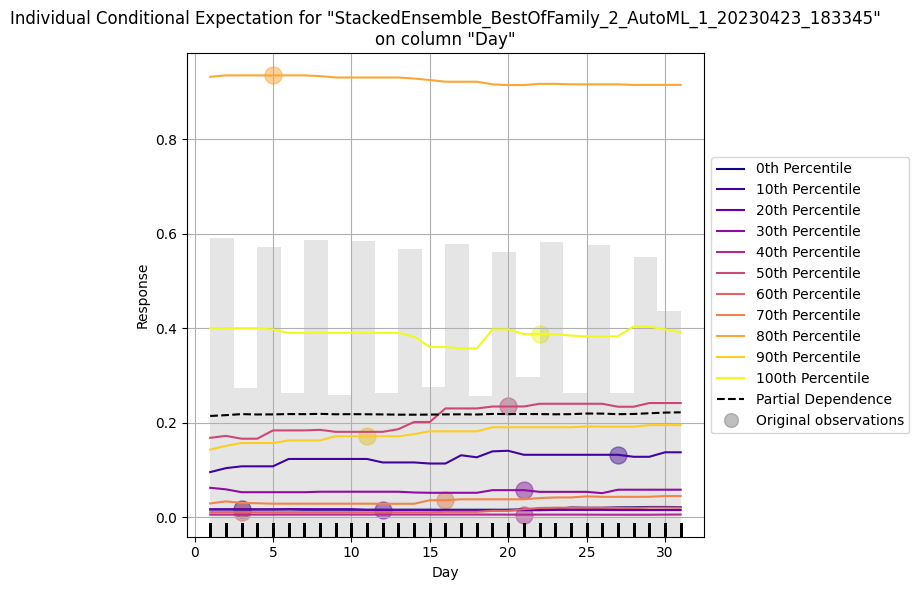

In [96]:
model = aml.leader
for col in h2o_data_test.columns:
  plot = model.ice_plot(h2o_data_test, col, figsize = (8,6))

Similar to PDP, an individual conditional expectation (ICE) plot shows the dependence between the target function and an input feature of interest. However, unlike a PDP, which shows the average effect of the input feature, an ICE plot visualizes the dependence of the prediction on a feature for each sample separately with one line per sample. 



# **Conclusion**  



**1. What is the question?**  
  \
The requirement is to predict the weather on the next date i.e. the target variable RainTomorrow. This is a classification problem, since the target has two classes as possible values "Yes" and "No". The data has various different climatic observations as independant variables in both numerical and categorical form which help us decide the risk of rain. Since these are climatic observations, many have high correlation like Humidity and Sunshine, missing values, and varying prediction significance towards to the target variable.  
  \
**2. What did we do?**  
  \
To handle missing values, we imputed the missing data using mode for categorical features and MICE for numerical features.  

Using Label Encoder we encoded data for categorical features and looked at each features distribution.  

Since the target variable was imbalanced, we resampled the "No" variable to make it balanced.  

Next, we scaled the data to look at the presence of outliers and however this only somewhat affects Logistic Regression and not Decision Tree Classifier or AutoML. 

Now, finally we looked at correlation among features, which was highly present among a lot of the features. To get rid of this, we looked for the top performing features with the help of KBest and RFE methods.

Next we tried different models like Logistic Regression, OLS, Decision tree, Ensemble method, and AutoML which gave a stacked ensemble model.  
  \

**3. How well did it work?**  
  \
Considering the p-value of different variables, we see that that a lot of the features have high significance and also high multicolinearity. We try to combat this using feature selection, selecting top 10 features, which increased the accuracy by 1%.  

Since both Logistic Regression and Decision Tree perform well but did not improve much even after feature selection, I looked at AutoML for a better performance and ran it 5 nfolds to get 89% accuracy. Increasing the number of nfolds helps increase accuracy, however for the purpose of limiting runtime, I have kept it at 5.  
  \
We looked at SHAP analysis and other methods of model interpretation, to see the top significant and features and the target variable variance with them which gave us the ability to modify our modeling.  

SHAP analysis was the most detailed in the information it provided like value of predictor variable, as well as its impact. LIME analysis also gave us a measure of impact however did not provide much information on the value of the predictor variable.  
Both handle multicolinearity, and represent impact in presence of other variables.  

Partial Dependance Plot and Individual Conditional Expecation Plots give us detailed variance of each feature as per target variable, however this relationship correct only if the predictors are independant of each other.  
  \
**4. What did you learn?**  
  \
* We tried out and understood the various step in Data Lifecylcle like Data Gatehering, Data Preprocessing, Feature Selection, Model Planning, Modeling and Interpretation and Communicating the results.
* Data Preprocessing is an important aspect, putting effort into majorly impacts the performance of the model.
* Hyperparameter tuning is also very important as it impacts model performance
* Model Interpretaion helps with understanding the working of the model and gaining insights into the modeling.

# **References**  
* https://github.com/aiskunks/YouTube/blob/main/A_Crash_Course_in_Statistical_Learning/Model_Interpretability/SHAP%20and%20LIME%20analysis%20Walkthrough.ipynb. 
* https://www.interpretable.ai/interpretability/what/#:~:text=What%20does%20it%20mean%20to,comprehend%20and%20trust%20the%20model.  
* https://dzone.com/articles/using-an-automl-h2o-model-to-predict-attrition-and.  
* https://scikit-learn.org/stable/modules/partial_dependence.html.  
* https://www.learndatasci.com/glossary/binary-classification/#:~:text=each%20binary%20classifier-,What%20is%20Binary%20Classification%3F,into%20one%20of%20two%20classes.
* https://towardsdatascience.com/introduction-to-logistic-regression-66248243c148
* https://datagy.io/sklearn-decision-tree-classifier/
* https://www.tredence.com/blog/introduction-to-mlops 

# **MIT License**

Copyright (c) 2023 Shabina Singh and AISkunks

Permission is hereby granted, free of charge, to any person obtaining a copy of this software and associated documentation files (the "Software"), to deal in the Software without restriction, including without limitation the rights to use, copy, modify, merge, publish, distribute, sublicense, and/or sell copies of the Software, and to permit persons to whom the Software is furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY, FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM, OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE SOFTWARE.